In [197]:
from __future__ import print_function

import pandas as pd
import numpy as np
import itertools
import matplotlib.pyplot as plt
import seaborn as sns
import os
from IPython.display import display

import sklearn.model_selection
import sklearn.metrics
import sklearn.datasets
import sklearn.ensemble
import sklearn.preprocessing
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import GradientBoostingClassifier
import lime
import lime.lime_tabular
from lime import submodular_pick
pd.options.display.max_columns = None
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

import sys
sys.path.append("../")

In [3]:
os.chdir("..")

In [4]:
"""
Functions from Final_Data_Prep.py
"""

def remove_final_dummy(df):
    '''
    Remove final dummy variable of each categorical feature.
    Changes df in-place.

    Assumes df has been 'exploded' by one-hot encoding.
    '''

    #read in pre-exploded non-OHE df, with data still in categorical format
    cat_df = pd.read_pickle('init_clean.pckl.gz', compression = 'gzip')

    #list of all categorical columns to get dummies for
    #excluding ID numbers, numerical features, datetime features, binary features
    cat_cols = ['offense_category', 'charge_offense_title', 'chapter', 'act', 
                'section', 'class', 'aoic', 'event', 'gender', 'race', 
                'law_enforcement_agency', 'unit', 'incident_city', 'updated_offense_category']
    for col in cat_cols:
        final_value = col+"_"+cat_df[col].unique()[-1]
        if final_value in df.columns:
            df.drop(columns=final_value, inplace=True)
    return
 

def get_train_val_test (df, train_size, test_size, val_size): 
    '''
    Uses "timeline" method to split Data into Train / Validate / Test Sets
    Returns a static validation set with divisions based on timeline to reduce 
    leakage and ensure that we only ever predict forward in time. Potential danger 
    of bias because training set will have higher proportion of "finalized" rows.

    Takes in df (assumes target variable = 'MHI') and train, test, and val sizes (fractions of 1)
    Returns xtrain, xval, xtest, ytrain, yval, ytest, with received_date dropped.
    '''

    #check that specificed sizes sum to 1
    assert train_size + test_size + val_size == 1, 'train_size + test_size + val_size must sum to 1'

    #sort ascending by received date
    sorted_df = df.sort_values(axis = 0, by=['received_date'])
    sorted_df = sorted_df.drop(columns = 'received_date')

    #set x and y
    x = sorted_df.drop('MHI', axis=1)
    y = sorted_df['MHI']

    total_size = len(x)

    #first train_size % indices in train
    xtrain = x.iloc[:int(round(train_size*total_size))]
    ytrain = y.iloc[:int(round(train_size*total_size))]

    #next val_size % indices in val
    xval = x.iloc[int(round(train_size*total_size)):int(round((train_size+val_size)*total_size))]
    yval = y.iloc[int(round(train_size*total_size)):int(round((train_size+val_size)*total_size))]

    #final test_size % indices in test
    xtest = x.iloc[int(round((train_size+val_size)*total_size)):-1]
    ytest = y.iloc[int(round((train_size+val_size)*total_size)):-1]

    return xtrain, xval, xtest, ytrain, yval, ytest


def get_train_test (df, train_size, test_size): 
    '''
    Used for getting train/test split for training final model.
    No validation set.

    Uses "timeline" method

    Takes in df (assumes 'MHI' is target variable).
    Takes in train and test sizes (fractions of 1).
    Returns training df and test df, with received_date dropped.
    '''

    #check that specificed sizes sum to 1
    assert train_size + test_size == 1, 'train_size + test_size must sum to 1'
        
    #sort ascending by received date
    sorted_df = df.sort_values(by=['received_date'], inplace=False)
    sorted_df = sorted_df.drop('received_date', axis=1)

    total_size = len(sorted_df)

    #first train_size % indices in train
    train = sorted_df.iloc[:int(round(train_size*total_size))]

    #final test_size % indices in test
    test = sorted_df.iloc[int(round(train_size*total_size)):-1]

    return train, test


'''
Downsampling the training set
'''

def downsample(df, pct_MHI1): 
    #takes in percentage from 1 to 50
    #samples all MHI==1 cases
    #samples from MHI==0 cases such that downsampled_df has pct_MHI1 % positive cases

    #split into MHI 1 and MHI 0 
    MHI1 = df[df['MHI'] == 1]
    MHI0 = df[df['MHI'] == 0]

    #count number of MHIs
    count_MHI1 = len(MHI1)

    #compute number of negative cases to sample
    num_MHI0 = count_MHI1 * int(round((100-pct_MHI1)/pct_MHI1))

    #sample from negative cases
    MHI0_sample = MHI0.sample(n=num_MHI0, random_state=42)

    #append sampled negative cases to all positive cases
    downsampled_df = MHI1.append(MHI0_sample)

    return downsampled_df

In [7]:
total_df = pd.read_pickle('total_df.pckl.gz', compression = 'gzip')
init = pd.read_pickle('initiation.pckl.gz', compression = 'gzip')
dispo = pd.read_pickle('dispositions.pckl.gz', compression = 'gzip')
sent = pd.read_pickle('sentencing.pckl.gz', compression = 'gzip')

# Section 1: Datatypes, missing values, and value distributions of input features. 

In [5]:
set(dispo.dtypes)
set(init.dtypes)
set(sent.dtypes)

{dtype('bool'), dtype('int64'), dtype('float64'), dtype('O')}

In [6]:
id_cols = ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID']

In [7]:
def make_input_df(df):
    ''' 
    function to make a informational table with the data type, number of missing values, and
    value distribution information for each column of a dataframe
    '''
    input_df = pd.DataFrame([], index = df.columns, columns = ['Datatype', 
                                                               'Missing Values',
                                                               'Cardinality', 
                                                               'Percent Unique',
                                                               'Value Information'])
    for col in df.columns:
        dtype = df[col].dtype
        input_df.loc[col]['Missing Values'] = format((df[col].isnull().sum()/len(df[col])) * 100, '.2f') +'%'
        input_df.loc[col]['Datatype'] = dtype
        input_df.loc[col]['Cardinality'] = len(df[col].unique())
        input_df.loc[col]['Percent Unique'] = \
            format((len(df[col].unique())/(len(df[col]) - df[col].isnull().sum()))* 100, '.2f') +'%'
        if dtype == object:
            top2 = df[col].value_counts(normalize=True)[0:2]
            distr = 'Top category: ' + str(top2.index[0]) + ' (' + format(top2[0]*100, '.2f') + \
            '%) ' + 'Second category: ' + str(top2.index[1]) + ' (' + format(top2[1]*100, '.2f') + '%)'
        elif dtype == 'int64' or dtype == 'float64':
            if col in id_cols:
                top2 = df[col].value_counts(normalize=True)[0:2]
                cat1 = 'Top id: ' + str(top2.index[0])
                val1 = format(top2.iloc[0]*100, '.2f') + '%'
                cat2 = 'Second top id: ' + str(top2.index[1])
                val2 = format(top2.iloc[1]*100, '.2f') + '%'
                distr = cat1 + ' (' + val1 + ') '+ cat2 + ' (' + val2 + ') '
            else: 
                minimum = 'Min: ' + str(min(df[col]))
                maximum = ' Max: ' + str(max(df[col]))
                mean =  ' Mean: ' + format(np.mean(df[col]), '.2f')
                median = ' Median: ' + str(np.median(df[col]))
                distr = minimum + maximum + mean + median
        elif dtype == 'bool': 
            trues = df[col].value_counts()[1]/len(df[col])
            falses = df[col].value_counts()[0]/len(df[col])
            distr = 'True: ' + format(trues*100, '.2f') + '%' + ' False: ' \
            + format(falses*100, '.2f') + '%'
        input_df.loc[col]['Value Information'] = distr
    return input_df

In [8]:
sent_input_df = make_input_df(sent)
sent_input_df.to_csv('sent_input_df.csv')
sent_input_df

,Datatype,Missing Values,Cardinality,Percent Unique,Value Information
case_id,int64,0.00%,187239,79.30%,Min: 44670309710 Max: 131109649851 Mean: 11860...
case_participant_id,int64,0.00%,201181,85.20%,Min: 120603216768 Max: 1099816034107 Mean: 936...
offense_category,object,0.00%,88,0.04%,Top category: Narcotics (26.99%) Second catego...
primary_charge,bool,0.00%,2,0.00%,True: 71.31% False: 28.69%
charge_id,int64,0.00%,217597,92.15%,Min: 297139349681 Max: 2584959433735 Mean: 217...
charge_version_id,int64,0.00%,220786,93.50%,Min: 67452722415 Max: 589634049667 Mean: 49844...
disposition_charged_offense_title,object,0.00%,1624,0.69%,Top category: POSSESSION OF A CONTROLLED SUBST...
disposition_charged_chapter,object,0.00%,484,0.20%,Top category: 720 (80.14%) Second category: 62...
disposition_charged_act,object,2.27%,46,0.02%,Top category: 5 (69.58%) Second category: 570 ...
disposition_charged_section,object,2.27%,1332,0.58%,Top category: 402(c) (15.22%) Second category:...


In [9]:
init_input_df = make_input_df(init)
init_input_df.to_csv('init_input_df.csv')

init_input_df

,Datatype,Missing Values,Cardinality,Percent Unique,Value Information
case_id,int64,0.00%,310135,34.28%,Min: 64999851671 Max: 131234091763 Mean: 12262...
case_participant_id,int64,0.00%,334417,36.96%,Min: 260122253823 Max: 1101549575851 Mean: 989...
offense_category,object,0.00%,87,0.01%,Top category: Narcotics (21.06%) Second catego...
primary_charge,bool,0.00%,2,0.00%,True: 36.12% False: 63.88%
charge_id,int64,0.00%,848542,93.79%,Min: 576865764426 Max: 2585372611996 Mean: 229...
charge_version_id,int64,0.00%,848542,93.79%,Min: 94353794219 Max: 589642239343 Mean: 52186...
charge_offense_title,object,0.00%,1402,0.15%,Top category: AGGRAVATED UNLAWFUL USE OF WEAPO...
chapter,object,0.00%,35,0.00%,Top category: 720 (84.15%) Second category: 62...
act,object,0.00%,49,0.01%,Top category: 5 (76.49%) Second category: 570 ...
section,object,0.00%,1392,0.15%,Top category: 402(c) (10.49%) Second category:...


In [10]:
disp_input_df = make_input_df(dispo)
disp_input_df.to_csv('disp_input_df.csv')
disp_input_df

,Datatype,Missing Values,Cardinality,Percent Unique,Value Information
case_id,int64,0.00%,291211,35.44%,Min: 44670309710 Max: 131204831926 Mean: 11824...
case_participant_id,int64,0.00%,312616,38.04%,Min: 119351839773 Max: 1101125805568 Mean: 931...
offense_category,object,0.00%,88,0.01%,Top category: Narcotics (21.71%) Second catego...
primary_charge,bool,0.00%,2,0.00%,True: 37.06% False: 62.94%
charge_id,int64,0.00%,779723,94.89%,Min: 297139349681 Max: 2584959433735 Mean: 216...
charge_version_id,int64,0.00%,784137,95.43%,Min: 67262144626 Max: 589634049667 Mean: 49426...
disposition_charged_offense_title,object,0.00%,2302,0.28%,Top category: POSSESSION OF A CONTROLLED SUBST...
disposition_charged_chapter,object,0.00%,858,0.10%,Top category: 720 (81.85%) Second category: 62...
disposition_charged_act,object,2.84%,52,0.01%,Top category: 5 (75.24%) Second category: 570 ...
disposition_charged_section,object,2.84%,1635,0.20%,Top category: 402(c) (12.88%) Second category:...


# Section 2: Looking into candidate keys and testing dependencies

In [10]:
init.columns

Index(['CASE_ID', 'CASE_PARTICIPANT_ID', 'OFFENSE_CATEGORY', 'PRIMARY_CHARGE',
       'CHARGE_ID', 'CHARGE_VERSION_ID', 'CHARGE_OFFENSE_TITLE', 'CHAPTER',
       'ACT', 'SECTION', 'CLASS', 'AOIC', 'EVENT', 'EVENT_DATE',
       'AGE_AT_INCIDENT', 'GENDER', 'RACE', 'INCIDENT_BEGIN_DATE',
       'INCIDENT_END_DATE', 'ARREST_DATE', 'LAW_ENFORCEMENT_AGENCY', 'UNIT',
       'INCIDENT_CITY', 'RECEIVED_DATE', 'ARRAIGNMENT_DATE',
       'UPDATED_OFFENSE_CATEGORY', 'CHARGE_COUNT'],
      dtype='object')

In [11]:
dispo.columns

Index(['CASE_ID', 'CASE_PARTICIPANT_ID', 'OFFENSE_CATEGORY', 'PRIMARY_CHARGE',
       'CHARGE_ID', 'CHARGE_VERSION_ID', 'DISPOSITION_CHARGED_OFFENSE_TITLE',
       'DISPOSITION_CHARGED_CHAPTER', 'DISPOSITION_CHARGED_ACT',
       'DISPOSITION_CHARGED_SECTION', 'DISPOSITION_CHARGED_CLASS',
       'DISPOSITION_CHARGED_AOIC', 'DISPOSITION_DATE', 'CHARGE_DISPOSITION',
       'CHARGE_DISPOSITION_REASON', 'JUDGE', 'COURT_NAME', 'COURT_FACILITY',
       'AGE_AT_INCIDENT', 'GENDER', 'RACE', 'INCIDENT_BEGIN_DATE',
       'INCIDENT_END_DATE', 'ARREST_DATE', 'LAW_ENFORCEMENT_AGENCY', 'UNIT',
       'INCIDENT_CITY', 'RECEIVED_DATE', 'ARRAIGNMENT_DATE',
       'UPDATED_OFFENSE_CATEGORY', 'CHARGE_COUNT'],
      dtype='object')

In [12]:
sent.columns

Index(['CASE_ID', 'CASE_PARTICIPANT_ID', 'OFFENSE_CATEGORY', 'PRIMARY_CHARGE',
       'CHARGE_ID', 'CHARGE_VERSION_ID', 'DISPOSITION_CHARGED_OFFENSE_TITLE',
       'DISPOSITION_CHARGED_CHAPTER', 'DISPOSITION_CHARGED_ACT',
       'DISPOSITION_CHARGED_SECTION', 'DISPOSITION_CHARGED_CLASS',
       'DISPOSITION_CHARGED_AOIC', 'DISPOSITION_DATE', 'CHARGE_DISPOSITION',
       'CHARGE_DISPOSITION_REASON', 'SENTENCE_PHASE', 'SENTENCE_DATE',
       'SENTENCE_JUDGE', 'SENTENCE_TYPE', 'CURRENT_SENTENCE',
       'COMMITMENT_TYPE', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME',
       'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'AGE_AT_INCIDENT', 'GENDER',
       'RACE', 'INCIDENT_BEGIN_DATE', 'INCIDENT_END_DATE', 'ARREST_DATE',
       'LAW_ENFORCEMENT_AGENCY', 'UNIT', 'INCIDENT_CITY', 'RECEIVED_DATE',
       'ARRAIGNMENT_DATE', 'UPDATED_OFFENSE_CATEGORY', 'CHARGE_COUNT'],
      dtype='object')

## Indentifying Candidate Keys

In [13]:
def test_dependency(df, col1, col2):
    '''From Brina Seidel's Lab 4 Notebook
    
       Tests whether there is total redundancy betwen col1 and col2
       by testing the number of unique combinations'''
    unique_1 = len(df[col1].unique())
    unique_2 = len(df[col2].unique())
    unique_combos = len(df[[col1, col2]].drop_duplicates())
    print("Unique values of {}: {}".format(col1, unique_1))
    print("Unique values of {}: {}".format(col2, unique_2))
    print("Unique combos of {} and {}: {}".format(col1, col2, unique_combos))
    return unique_combos == max(unique_1, unique_2)

In [14]:
test_dependency(init, 'CASE_PARTICIPANT_ID', 'CHARGE_ID')

Unique values of CASE_PARTICIPANT_ID: 334417
Unique values of CHARGE_ID: 848542
Unique combos of CASE_PARTICIPANT_ID and CHARGE_ID: 904719


False

In [15]:
len(init)

904719

In [16]:
test_dependency(dispo, 'CASE_PARTICIPANT_ID', 'CHARGE_ID')

Unique values of CASE_PARTICIPANT_ID: 312616
Unique values of CHARGE_ID: 779723
Unique combos of CASE_PARTICIPANT_ID and CHARGE_ID: 821723


False

In [17]:
len(dispo)

821723

In [18]:
test_dependency(sent, 'CASE_PARTICIPANT_ID', 'CHARGE_ID')

Unique values of CASE_PARTICIPANT_ID: 201181
Unique values of CHARGE_ID: 217597
Unique combos of CASE_PARTICIPANT_ID and CHARGE_ID: 227049


False

In [19]:
len(sent)

236124

#### We see that 'CASE_PARTICIPANT_ID' + 'CHARGE_ID' forms a candidate key in the Initiation and Dispositions datasets, but not in Sentencing. This indicates that each row in Initiation and Disposition represents a single charge against a person.

## Looking for Candidate Key in Sentencing Dataset

In [22]:
# Algorithm inspired by A Priori / Candidate Generation

'''
Use CP ID, Case ID, Charge ID, Charge Version ID, and sentencing-related features
as potential building blocks for candidate key
'''

F = {1:[['CASE_PARTICIPANT_ID'], ['CASE_ID'], ['CHARGE_ID'], ['CHARGE_VERSION_ID'],
        ['SENTENCE_PHASE'], ['SENTENCE_DATE'], ['SENTENCE_JUDGE'], 
        ['SENTENCE_TYPE'], ['CURRENT_SENTENCE'],['COMMITMENT_TYPE'], 
        ['COMMITMENT_TERM'], ['COMMITMENT_UNIT'], ['COURT_NAME'],
        ['COURT_FACILITY'], ['LENGTH_OF_CASE_in_Days']]}

candidate_keys=[]

In [23]:
for k in range(1,len(F[1])):
    print('k='+str(k))
    F[k+1]=[]
    for group in F[k]:
        print('\t group: ', group)
        for col in F[1]:
            if col[0] not in group and group[-1]<col[0]:
                new_group = group.copy()+col
                if len(sent[new_group].drop_duplicates())==len(sent):
                    print('Candidate key: ', new_group)
                    candidate_keys.append(new_group)
                else:
                #search for further supersets if candidate key not identified
                    F[k+1].append(new_group)
                    print('\t\t new_group: ', new_group)

k=1
	 group:  ['CASE_PARTICIPANT_ID']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID']
		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY']
		 new_group:  ['CASE_PARTICIPANT_ID', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID']
		 new_group:  ['CASE_ID', 'CHARGE_ID']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID']
		 new_group:  ['CASE_ID', 'SENTENCE_PHASE']
		 new_grou

		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']


		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_NAME

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', '

		 new_group:  ['COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_gro

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['LENGT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PART

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPAN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_I

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CUR

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CAS

		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE

		 new_group:  ['CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CURRENT_S

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_

		 new_group:  ['CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']


		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COUR

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITME

		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 g

		 new_group:  ['COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE'

		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CA

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENC

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_DATE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_T

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUD

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COUR

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME'

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
	

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHAR

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME']


		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 

		 new_group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CO

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_TYPE

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CU

		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENC

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID'

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CHA

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENC

		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_F

		 new_group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE'

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COM

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARG

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_

		 new_group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_grou

		 new_group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE'

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 ne

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE'

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_F

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT'

		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'S

		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'S

		 new_group:  ['COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_NAME', 'CURRENT_SENT

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_gr

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHAR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPAN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COUR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_D

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMI

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMM

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPA

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTE

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PA

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_I

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE

		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENC

		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_gr

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_I

	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
		 new_group:  

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_TYPE']
	 grou

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PAR

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_D

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE']

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSIO

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SE

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 g

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'C

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'C

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE'

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_D

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'C

		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']


		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 gro

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PH

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENG

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENC

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHA

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_O

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  

		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', '

		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_S

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILIT

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID'

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['

		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE

		 new_group:  ['COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITM

		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CAS

		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILI

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TERM', 

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 g

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMIT

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM'

		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  

		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_

		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_grou

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  [

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENC

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_T

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIP

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_I

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHAR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CAS

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMIT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_g

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CAS

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COM

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_D

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILIT

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'C

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGT

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PART

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHA

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CO

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIP

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIP

		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHAS

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSIO

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TER

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'S

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']


		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  [

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TY

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
	

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']


		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIP

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 gr

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'C

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_N

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COU

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARG

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'CURRE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COU

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACI

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'S

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE',

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'C

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  [

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'S

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENC

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILI

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMIT

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UN

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 grou

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENT

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 grou

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE

		 new_group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_

		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CH

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID',

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', '

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITME

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', '

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FA

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', '

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_i

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CO

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', '

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_T

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TER

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_grou

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENG

		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUD

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMIT

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITM

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_S

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'CO

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITME

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', '

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE

		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME'

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTE

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTE

		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_

		 new_group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMIT

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMIT

		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_gr

		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TY

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHAR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PART

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CO

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARG

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group: 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_V

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 n

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACI

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'S

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'C

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTI

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURREN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMM

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Da

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 gro

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']


		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMI

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARG

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Da

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['C

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VER

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGT

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['C

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICI

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITME

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_D

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPA

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYP

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PAR

		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'SENTENCE_D

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CO

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_U

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_TY

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']


		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'S

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMIT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITME

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PART

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYP

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTIC

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENC

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
	

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_I

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
	

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSI

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CA

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_T

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_I

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'S

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHA

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CA

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FA

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'C

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']


		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'LENGT

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']


		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NA

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_J

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TER

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COUR

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FAC

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'C

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_I

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LEN

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURREN

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE'

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_O

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'L

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_N

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'CO

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', '

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENT

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
	

		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COURT_FACILIT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CH

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CH

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_T

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_V

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'S

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'C

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SEN

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT',

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', '

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Day

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_J

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SEN

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'C

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 gro

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHAR

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENC

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME'

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', '

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILI

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTEN

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_V

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUD

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DA

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMM

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY',

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', '

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CA

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COM

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group: 

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_P

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITME

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMEN

		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE'

		 new_group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
k=8
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENG

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CO

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_gro

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 ne

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHAS

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITM

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPAN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTIC

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'S

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COU

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYP

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CH

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COU

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENC

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE',

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHAS

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'C

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_P

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUD

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'S

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDG

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_I

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURR

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group: 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUD

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITME

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PART

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_i

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYP

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group: 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_P

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_T

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_O

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENC

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_F

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 n

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_T

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group: 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'S

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_D

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 g

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENC

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_gro

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  [

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIP

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', '

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARG

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARG

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_T

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUD

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'S

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', '

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_g

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COU

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CO

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'S

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group: 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CO

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VER

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', '

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CAS

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VER

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', '

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARG

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSIO

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', '

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CAS

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMM

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 n

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYP

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CO

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY'

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_gro

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYP

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMI

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', '

		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHAR

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME'

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTEN

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHAR

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMM

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 n

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYP

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMM

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHAR

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COUR

		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'S

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_T

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DAT

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENC

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'S

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', '

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_grou

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SE

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Da

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHAR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 gr

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 n

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CH

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CO

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID'

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTI

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CA

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMIT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURR

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPAN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CH

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITM

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', '

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUD

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group: 

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_F

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CU

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COU

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_P

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DAT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VER

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COU

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'S

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COUR

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPAN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMIT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_V

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DAT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_V

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group: 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VER

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMIT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMIT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACIL

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURR

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CO

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CAS

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITME

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'CO

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', '

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'SENTENCE_DAT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMI

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COUR

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', '

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NA

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_I

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Day

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_T

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', '

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHAS

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE',

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERS

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGT

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', '

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_C

		 new_group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COM

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMEN

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', '

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTE

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITM

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM'

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COUR

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID'

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TY

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'C

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_T

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'C

		 new_group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENC

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENC

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DAT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'L

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYP

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGT

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DA

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DAT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME',

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'S

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENC

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SEN

		 new_group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 gr

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Day

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE']

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 g

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Day

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 gr

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Day

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
Candidate key:  ['CASE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTE

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_I

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DAT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group: 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CH

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'S

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_N

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LEN

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACI

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_O

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_O

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTEN

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TY

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 g

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group: 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'S

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'C

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  [

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHAR

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERS

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_T

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 gr

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHAR

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TY

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'C

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SEN

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENT

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMM

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VER

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE

		 new_group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_P

		 new_group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTE

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURREN

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSIO

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'C

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM'

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMIT

		 new_group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACIL

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_O

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTEN

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM'

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_I

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COU

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COURT_FACILITY', 'COURT_NAME', 'CUR

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_O

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTE

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CA

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FA

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FAC

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', '

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COU

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FA

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMIT

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days'

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'C

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SEN

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE',

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE'

		 new_group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE',

		 new_group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SEN

		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMIT

		 new_group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_D

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CH

Candidate key:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_PARTICIPANT_ID', 'CHARGE

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['C

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CAS

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COM

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TYPE

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'COMMITMENT_TER

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_VERSI

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'COMM

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE']
		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY',

		 new_group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTEN

Candidate key:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CASE_PARTICIPANT_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTE

		 new_group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'CURRENT_SENTENCE', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 group:  ['CASE_ID', 'CHARGE_ID', 'CHARGE_VERSION_ID', 'COMMITMENT_TERM', 'COMMITMENT_TYPE', 'COMMITMENT_UNIT', 'COURT_FACILITY', 'COURT_NAME', 'LENGTH_OF_CASE_in_Days', 'SENTENCE_DATE', 'SENTENCE_JUDGE', 'SENTENCE_PHASE', 'SENTENCE_TYPE']
	 grou

In [24]:
# view all candidate keys
candidate_keys

[['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_VERSION_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'CHARGE_VERSION_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_JUDGE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'LENGTH_OF_CASE_in_Days',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'COMMITMENT_UNIT',
  '

In [25]:
# candidate keys of minimum length
[x for x in candidate_keys if len(x)==8]

[['CASE_PARTICIPANT_ID',
  'CHARGE_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE'],
 ['CASE_PARTICIPANT_ID',
  'CHARGE_VERSION_ID',
  'COMMITMENT_TERM',
  'COMMITMENT_TYPE',
  'CURRENT_SENTENCE',
  'SENTENCE_DATE',
  'SENTENCE_PHASE',
  'SENTENCE_TYPE']]

In [26]:
# check for candidate keys that do not contain 'COMMITMENT_TERM'
[x for x in candidate_keys if 'COMMITMENT_TERM' not in x]

[]

#### Business rules that govern row-generation in the Sentencing dataset still not clear.

## Investigating Relationship between CHARGE_ID and CHARGE_VERSION_ID

In [27]:
test_dependency(dispo, 'CHARGE_ID', 'CHARGE_VERSION_ID')

Unique values of CHARGE_ID: 779723
Unique values of CHARGE_VERSION_ID: 784137
Unique combos of CHARGE_ID and CHARGE_VERSION_ID: 784137


True

In [28]:
test_dependency(init, 'CHARGE_ID', 'CHARGE_VERSION_ID')

Unique values of CHARGE_ID: 848542
Unique values of CHARGE_VERSION_ID: 848542
Unique combos of CHARGE_ID and CHARGE_VERSION_ID: 848542


True

In [29]:
test_dependency(sent, 'CHARGE_ID', 'CHARGE_VERSION_ID')

Unique values of CHARGE_ID: 217597
Unique values of CHARGE_VERSION_ID: 220786
Unique combos of CHARGE_ID and CHARGE_VERSION_ID: 220786


True

#### This shows that in all three datasets, each CHARGE_VERSION_ID corresponds to exactly 1 CHARGE_ID.

## Investigating Relationship between CASE_PARTICIPANT_ID and CASE_ID

In [30]:
test_dependency(init, 'CASE_PARTICIPANT_ID', 'CASE_ID')

Unique values of CASE_PARTICIPANT_ID: 334417
Unique values of CASE_ID: 310135
Unique combos of CASE_PARTICIPANT_ID and CASE_ID: 334417


True

In [31]:
test_dependency(dispo, 'CASE_PARTICIPANT_ID', 'CASE_ID')

Unique values of CASE_PARTICIPANT_ID: 312616
Unique values of CASE_ID: 291211
Unique combos of CASE_PARTICIPANT_ID and CASE_ID: 312616


True

In [32]:
test_dependency(sent, 'CASE_PARTICIPANT_ID', 'CASE_ID')

Unique values of CASE_PARTICIPANT_ID: 201181
Unique values of CASE_ID: 187239
Unique combos of CASE_PARTICIPANT_ID and CASE_ID: 201181


True

#### This confirms that in all 3 datasets, each CP ID corresponds to 1 person and 1 case.

# Section 3: LIME Analysis/Explanations

#### This following is based in large part on Brina Seidel's "Responsible Data Science Lab 8: LIME" notebook, available at https://github.com/DataResponsibly/courses/blob/master/documents/spring20/RDS_Lab8_2020.ipynb

In [27]:
total_df = pd.read_pickle('total_df.pckl.gz', compression = 'gzip')

## One-Hot Decoding

In [28]:
def is_binary(series):
    '''
    Function adapted from StackOverflow user lucas
    https://stackoverflow.com/questions/32982034/which-columns-are-binary-in-a-pandas-dataframe
    '''
    return sorted(series.unique()) == [0, 1]

In [29]:
# Dictionary for aggregation, as defined in Data_Prep notebook
agg_dict_short = {'offense_category': 'median', 'event': 'median', 
                  'age_at_incident': 'median', 'gender': 'median', 
                  'race': 'median', 'law_enforcement_agency': 'median', 
                  'unit': 'median', 'incident_city': 'median', 
                  'updated_offense_category': 'median', 'age_over_100': 'median', 
                  'age_unknown': 'median', 'charge_count': 'max', 
                  '402': 'max', 'charge_offense_title': 'sum', 
                  'chapter': 'sum', 'act': 'sum', 
                  'section': 'sum', 'class': 'sum', 'aoic': 'sum'}

# List of categorical columns used for OHE, as defined in Data_Prep notebook
cat_cols = ['offense_category', 'charge_offense_title', 'chapter', 'act', 
            'section', 'class', 'aoic', 'event', 'gender', 'race', 
            'law_enforcement_agency', 'unit', 'incident_city', 'updated_offense_category']

In [30]:
# Build list of column names to be one-hot decoded
decode_cols = []
for catcol in cat_cols:
    if agg_dict_short[catcol] == 'median':
        decode_cols.append(catcol)

In [31]:
decode_cols

['offense_category',
 'event',
 'gender',
 'race',
 'law_enforcement_agency',
 'unit',
 'incident_city',
 'updated_offense_category']

In [32]:
# check that all columns aggregated by 'median' are binary
# check that all columns aggregated elsewise are not binary
bin_errors = []
nonbin_errors = []

for dumcol in total_df.columns:
    dumb=False
    for col in agg_dict_short:
        if dumcol.startswith(col+'_'):
            dumb=True
            if agg_dict_short[col]=='median':
                if not is_binary(total_df[dumcol]):
                    print(dumcol, ' is NOT binary.')
                    nonbin_errors.append(dumcol)
                else:
                    print('\t'+dumcol+' is BINARY')
            else:
                if is_binary(total_df[dumcol]):
                    print(dumcol, ' is BINARY')
                    bin_errors.append(dumcol)
                else:
                    print('\t'+dumcol+' is NOT binary')
    if dumb==False:
        if is_binary(total_df[dumcol]):
            print(dumcol, ' is BINARY')
            bin_errors.append(dumcol)
        else:
            print('\t'+dumcol+' is NOT binary')

	offense_category_aggravated assault police officer is BINARY
	offense_category_aggravated assault police officer firearm is BINARY
	offense_category_aggravated battery is BINARY
	offense_category_aggravated battery police officer is BINARY
	offense_category_aggravated battery police officer firearm is BINARY
	offense_category_aggravated battery with a firearm is BINARY
	offense_category_aggravated discharge firearm is BINARY
	offense_category_aggravated dui is BINARY
	offense_category_aggravated fleeing and eluding is BINARY
	offense_category_aggravated identity theft is BINARY
	offense_category_aggravated robbery is BINARY
	offense_category_aggravated robbery bb gun is BINARY
	offense_category_armed robbery is BINARY
	offense_category_armed violence is BINARY
	offense_category_arson is BINARY
	offense_category_arson and attempt arson is BINARY
	offense_category_attempt armed robbery is BINARY
	offense_category_attempt arson is BINARY
	offense_category_attempt homicide is BINARY
	offe

	law_enforcement_agency_bedford park pd is BINARY
	law_enforcement_agency_bellwood pd is BINARY
	law_enforcement_agency_berkeley pd is BINARY
	law_enforcement_agency_berwyn pd is BINARY
	law_enforcement_agency_blue island pd is BINARY
	law_enforcement_agency_bolingbrook p.d. is BINARY
	law_enforcement_agency_bridgeview pd is BINARY
	law_enforcement_agency_broadview pd is BINARY
	law_enforcement_agency_brookfield pd is BINARY
	law_enforcement_agency_buffalo grove pd is BINARY
	law_enforcement_agency_burbank pd is BINARY
	law_enforcement_agency_burlington northern santa fe railroad pd is BINARY
	law_enforcement_agency_burnham pd is BINARY
	law_enforcement_agency_burr ridge pd is BINARY
	law_enforcement_agency_c p d  area 1 dist 2 is BINARY
	law_enforcement_agency_c p d area 2 is BINARY
	law_enforcement_agency_c p d area 3 is BINARY
	law_enforcement_agency_c p d area 4 vc is BINARY
	law_enforcement_agency_calumet city pd is BINARY
	law_enforcement_agency_calumet city police department is 

	law_enforcement_agency_lansing police department is BINARY
	law_enforcement_agency_lemont pd is BINARY
	law_enforcement_agency_lincolnwood pd is BINARY
	law_enforcement_agency_loyola university of chicago pd is BINARY
	law_enforcement_agency_lynwood pd is BINARY
	law_enforcement_agency_lyons pd is BINARY
	law_enforcement_agency_markham pd is BINARY
	law_enforcement_agency_matteson pd is BINARY
	law_enforcement_agency_maywood park district pd is BINARY
	law_enforcement_agency_maywood pd is BINARY
	law_enforcement_agency_mc cook pd is BINARY
	law_enforcement_agency_mchenry county sheriff's office is BINARY
	law_enforcement_agency_melrose park pd is BINARY
	law_enforcement_agency_merrionette park pd is BINARY
	law_enforcement_agency_metra pd is BINARY
	law_enforcement_agency_midlothian pd is BINARY
	law_enforcement_agency_moraine valley comm college pd is BINARY
	law_enforcement_agency_morton college police department is BINARY
	law_enforcement_agency_morton grove park district pd is BIN

	unit_unit 609 - financial crimes investigations is BINARY
	unit_unit 610 - detective section - central is BINARY
	unit_unit 611 - prop crimes dda 1 is BINARY
	unit_unit 612 - violent crimes dda 1 is BINARY
	unit_unit 620 - detective section - south is BINARY
	unit_unit 621 - prop crimes dda 2 is BINARY
	unit_unit 622 - violent crimes dda 2 is BINARY
	unit_unit 630 - detective section - north is BINARY
	unit_unit 631 - prop crimes dda 3 is BINARY
	unit_unit 632 - violent crimes dda 3 is BINARY
	unit_unit 640 - det div area 4 is BINARY
	unit_unit 641 - prop crimes dda 4 is BINARY
	unit_unit 642 - violent crimes dda 4 is BINARY
	unit_unit 650 - det div area 5 is BINARY
	unit_unit 651 - prop crimes dda 5 is BINARY
	unit_unit 652 - violent crimes dda 5 is BINARY
	unit_unit 667 - targeted response unit is BINARY
	unit_unit 701 - public transportation section is BINARY
	unit_unit 702 - cta security is BINARY
	unit_unit 704 - transit security is BINARY
	unit_unit 714 - summer mobile patrol is

	incident_city_stone park is BINARY
	incident_city_streamwood is BINARY
	incident_city_summit is BINARY
	incident_city_summit argo is BINARY
	incident_city_thornton is BINARY
	incident_city_tinley park is BINARY
	incident_city_university park is BINARY
	incident_city_unknown is BINARY
	incident_city_vernon hills is BINARY
	incident_city_warren is BINARY
	incident_city_waukegan is BINARY
	incident_city_west chicago is BINARY
	incident_city_west dundee is BINARY
	incident_city_westchester is BINARY
	incident_city_western sprgs is BINARY
	incident_city_western springs is BINARY
	incident_city_westmont is BINARY
	incident_city_wheaton is BINARY
	incident_city_wheeling is BINARY
	incident_city_willow spgs is BINARY
	incident_city_willow springs is BINARY
	incident_city_willowbrook is BINARY
	incident_city_wilmette is BINARY
	incident_city_winnetka is BINARY
	incident_city_wood dale is BINARY
	incident_city_woodstock is BINARY
	incident_city_worth is BINARY
age_over_100  is BINARY
age_unknow

charge_offense_title_agg use commu device/death  is BINARY
	charge_offense_title_agg uuw/loaded/no fcca/foid is NOT binary
	charge_offense_title_agg uuw/loaded/no fcca/foid/2+ is NOT binary
	charge_offense_title_agg uuw/unloaded/no fcca is NOT binary
	charge_offense_title_agg uuw/veh/fir loaded/no foid is NOT binary
	charge_offense_title_agg uuw/vehicle/loaded firearm is NOT binary
	charge_offense_title_aggravated arson is NOT binary
	charge_offense_title_aggravated assault is NOT binary
	charge_offense_title_aggravated assault of a peace officer with a motor vehicle is NOT binary
charge_offense_title_aggravated assault/public prop  is BINARY
	charge_offense_title_aggravated battery is NOT binary
	charge_offense_title_aggravated battery of a child is NOT binary
	charge_offense_title_aggravated battery of a senior citizen is NOT binary
charge_offense_title_aggravated battery of an unborn child  is BINARY
	charge_offense_title_aggravated battery strangulation is NOT binary
	charge_offens

	charge_offense_title_attempt murder is NOT binary
charge_offense_title_attempt obstruct just/destroy evidence  is BINARY
charge_offense_title_attempt poss fraudulent id card  is BINARY
charge_offense_title_attempt possess lost credit/debit card  is BINARY
charge_offense_title_attempt possession of a controlled substance  is BINARY
	charge_offense_title_attempt possession of a stolen motor vehicle is NOT binary
charge_offense_title_attempt possession of cannabis  is BINARY
charge_offense_title_attempt possession of explosives  is BINARY
charge_offense_title_attempt possession of look-alike substance with intent to deliver/delivery of look-alike substance  is BINARY
	charge_offense_title_attempt predatory criminal sexual assault is NOT binary
	charge_offense_title_attempt predatory criminal sexual assault of a victim less than 13 years of age is NOT binary
	charge_offense_title_attempt residential arson is NOT binary
	charge_offense_title_attempt residential burglary is NOT binary
charg

	charge_offense_title_continuing fin crime entrprs is NOT binary
	charge_offense_title_contrib crim delinq minor/cl 3 is NOT binary
charge_offense_title_contrib crim delinq minor/cl 4  is BINARY
charge_offense_title_contrib crim delinq minor/cl a  is BINARY
charge_offense_title_contrib crim delinq minor/cl x  is BINARY
	charge_offense_title_contrib dependency/negl minor is NOT binary
charge_offense_title_controlled substance label/1st  is BINARY
	charge_offense_title_controlled substance trafficking is NOT binary
	charge_offense_title_counterfeit credit/debit card is NOT binary
	charge_offense_title_cr/debit card fraud/false stmt is NOT binary
	charge_offense_title_credit/debit card fraud/2+ is NOT binary
charge_offense_title_crim ab/negl abandons  is BINARY
charge_offense_title_crim ab/negl fail to perf/deth  is BINARY
	charge_offense_title_crim ab/negl fail to perform is NOT binary
	charge_offense_title_crim ab/negl physical abuse is NOT binary
charge_offense_title_crim damage to pro

	charge_offense_title_engaging or employing persons [controlled][counterfeit][look-alike] substance is NOT binary
charge_offense_title_enter place of pro w/intent  is BINARY
charge_offense_title_entice chil remove clothes/2nd  is BINARY
	charge_offense_title_entice chil remove clothes/sch is NOT binary
	charge_offense_title_esc of felon from penal inst is NOT binary
	charge_offense_title_esc/violate monitoring weapon is NOT binary
	charge_offense_title_escape is NOT binary
charge_offense_title_escape from dept of correction  is BINARY
charge_offense_title_escape/violate elec monitoring  is BINARY
	charge_offense_title_escape; failure to comply with a condition of the electronic home monitoring detention program is NOT binary
charge_offense_title_excess of contractual resp  is BINARY
	charge_offense_title_exploit child<13/expose self is NOT binary
	charge_offense_title_exploit chld<13/remove clothes is NOT binary
	charge_offense_title_exploitation child/sex act/2nd is NOT binary
	charge

	charge_offense_title_id theft/use id/3 indiv 12 mos is NOT binary
	charge_offense_title_id theft/use id/commit felony is NOT binary
	charge_offense_title_id theft/use id/fel/3+ indiv is NOT binary
	charge_offense_title_id theft/use id/fel/mlty vic is NOT binary
charge_offense_title_id thft/access info/3+ indiv  is BINARY
	charge_offense_title_id thft/aid/abet another/2nd+ is NOT binary
	charge_offense_title_id thft/gain access pers info is NOT binary
	charge_offense_title_id thft/obtain id/fel/3+ indiv is NOT binary
	charge_offense_title_id thft/obtain info/commit fel is NOT binary
charge_offense_title_id thft/purch meth manuf mat/1  is BINARY
	charge_offense_title_id thft/stolen id/fel/3+ indiv is NOT binary
	charge_offense_title_identity theft is NOT binary
	charge_offense_title_identity theft $2,000<$10,000 is NOT binary
charge_offense_title_identity theft/access records  is BINARY
charge_offense_title_identity theft/felony theft  is BINARY
	charge_offense_title_identity theft/know

	charge_offense_title_officer fail report conviction is NOT binary
	charge_offense_title_official misconduct is NOT binary
	charge_offense_title_offl miscon/obtain pers advant is NOT binary
	charge_offense_title_offl miscon/solicit/accept fee is NOT binary
	charge_offense_title_offl misconduct/fail perform is NOT binary
	charge_offense_title_offl misconduct/forbidden act is NOT binary
	charge_offense_title_onlilne sale/stolen prop/>$300 is NOT binary
charge_offense_title_online sale of stolen property  is BINARY
charge_offense_title_online sale/stolen prop>$150  is BINARY
charge_offense_title_online sale/stolen prop>$300  is BINARY
charge_offense_title_online sales/stolen prop/<$300  is BINARY
	charge_offense_title_online theft/exceeds $150 is NOT binary
	charge_offense_title_online theft/not exceed $150 is NOT binary
charge_offense_title_online thft by deception/<$300  is BINARY
	charge_offense_title_online thft by deception/>$300 is NOT binary
charge_offense_title_op mtr veh w/plate 

	charge_offense_title_prohibited deposit/receiver is NOT binary
	charge_offense_title_prohibited presence within a school zone by a child sex offender is NOT binary
	charge_offense_title_prom juv pro/minor <18/retard is NOT binary
charge_offense_title_promote dog fighting  is BINARY
charge_offense_title_promote dog fighting/2nd+  is BINARY
	charge_offense_title_promoting juvenile prostitution is NOT binary
	charge_offense_title_promoting prostitution is NOT binary
charge_offense_title_proof finan resp/for hire  is BINARY
	charge_offense_title_prostitution is NOT binary
charge_offense_title_provide id/obtain fic id card  is BINARY
charge_offense_title_provide id/obtain fic id/2nd  is BINARY
charge_offense_title_provide site for dog fight  is BINARY
	charge_offense_title_ptrn minor pro/intel disabled is NOT binary
charge_offense_title_pub indecency/exposure/school  is BINARY
	charge_offense_title_pub indecency/sex conduct 3+ is NOT binary
charge_offense_title_pub indecency/sex/sch ground

charge_offense_title_unlwfl sale of stolen firearm  is BINARY
charge_offense_title_unlwfl use firearm projectile  is BINARY
charge_offense_title_unlwfl video/outside resid  is BINARY
charge_offense_title_use 3 or more credit cards  is BINARY
	charge_offense_title_use credit card of another is NOT binary
charge_offense_title_use credit card of another/2nd  is BINARY
	charge_offense_title_use credit/debit card/security is NOT binary
	charge_offense_title_use forged cr/debit card/<$300 is NOT binary
	charge_offense_title_use forged cr/debit card/>$300 is NOT binary
	charge_offense_title_use of an account number or code with intent to defraud is NOT binary
charge_offense_title_use of property  is BINARY
charge_offense_title_use stolen fir/commit offense  is BINARY
charge_offense_title_use theft detect remover/2nd+  is BINARY
charge_offense_title_use theft detection remover  is BINARY
charge_offense_title_use/poss driver's lic reader  is BINARY
	charge_offense_title_vehicle theft conspiracy

	section_11-20.1(a)(1)(iv) is NOT binary
section_11-20.1(a)(1)(v)  is BINARY
	section_11-20.1(a)(1)(vii) is NOT binary
	section_11-20.1(a)(2) is NOT binary
	section_11-20.1(a)(3) is NOT binary
	section_11-20.1(a)(4) is NOT binary
	section_11-20.1(a)(6) is NOT binary
	section_11-20.1(a)(7) is NOT binary
section_11-20.1b(a)(1)(i)  is BINARY
	section_11-20.1b(a)(1)(ii) is NOT binary
	section_11-20.1b(a)(1)(iv) is NOT binary
section_11-20.1b(a)(1)(v)  is BINARY
	section_11-20.1b(a)(1)(vii) is NOT binary
	section_11-20.1b(a)(2) is NOT binary
	section_11-20.1b(a)(4) is NOT binary
	section_11-20.1b(a)(6) is NOT binary
	section_11-20.3(a)(1)(i) is NOT binary
	section_11-20.3(a)(1)(ii) is NOT binary
	section_11-20.3(a)(1)(iv) is NOT binary
section_11-20.3(a)(1)(v)  is BINARY
	section_11-20.3(a)(1)(vii) is NOT binary
	section_11-20.3(a)(2) is NOT binary
	section_11-20.3(a)(6) is NOT binary
section_11-204(a)  is BINARY
	section_11-204.1(a)(1) is NOT binary
	section_11-204.1(a)(2) is NOT binary
	s

	section_12-7.3(a)(1) is NOT binary
	section_12-7.3(a)(2) is NOT binary
	section_12-7.3(a-3)(1) is NOT binary
	section_12-7.3(a-3)(2) is NOT binary
	section_12-7.3(a-5)(1) is NOT binary
section_12-7.3(a-5)(2)  is BINARY
	section_12-7.4(a)(1) is NOT binary
	section_12-7.4(a)(2) is NOT binary
	section_12-7.4(a)(3) is NOT binary
	section_12-7.5(a)(1) is NOT binary
	section_12-7.5(a)(2) is NOT binary
	section_12-7.5(a-3)(1) is NOT binary
	section_12-7.5(a-3)(2) is NOT binary
section_12-7.5(a-3)(3)  is BINARY
	section_12-7.5(a-5)(1) is NOT binary
section_12-7.5(a-5)(2)  is BINARY
	section_12-9(a) is NOT binary
	section_125 is NOT binary
section_12c-10(a)  is BINARY
	section_12c-25(a) is NOT binary
section_12c-30(b)  is BINARY
	section_12c-5(a)(1) is NOT binary
	section_12c-5(a)(2) is NOT binary
	section_13 is NOT binary
section_13.2  is BINARY
section_1301  is BINARY
section_14(a)(1)  is BINARY
section_14(a)(2)  is BINARY
	section_14(c)(3) is NOT binary
	section_14(d-5) is NOT binary
	secti

	section_21-1(a)(3) is NOT binary
	section_21-1(a)(4) is NOT binary
	section_21-1.01(a)(1) is NOT binary
section_21-1.01(a)(2)  is BINARY
section_21-1.01(a)(3)  is BINARY
	section_21-1.2(a)(1) is NOT binary
	section_21-1.3(a) is NOT binary
section_21-2  is BINARY
section_21-2(a)  is BINARY
section_21-3(a)(1)  is BINARY
section_21-3(a)(2)  is BINARY
section_21-3(a)(3)  is BINARY
	section_21-4(1)(a) is NOT binary
	section_21-4(1)(b) is NOT binary
section_21-4(1)(c)  is BINARY
section_21-5  is BINARY
section_21-5.5(b)(2)  is BINARY
section_21-6(a)  is BINARY
section_21-7(a)(1)  is BINARY
section_21-9  is BINARY
section_21-9(a)  is BINARY
section_21-9(a-5)  is BINARY
	section_218(b) is NOT binary
section_219  is BINARY
	section_24(c) is NOT binary
	section_24(d) is NOT binary
	section_24(h) is NOT binary
	section_24-1(a)(1) is NOT binary
	section_24-1(a)(10) is NOT binary
	section_24-1(a)(2) is NOT binary
section_24-1(a)(3)  is BINARY
	section_24-1(a)(4) is NOT binary
	section_24-1(a)(6) i

	section_401(e) is NOT binary
	section_401(f) is NOT binary
	section_401(g) is NOT binary
section_401(h)  is BINARY
	section_401.1(a) is NOT binary
section_401.5(a)  is BINARY
	section_401.5(a-5) is NOT binary
section_402(a)(1)  is BINARY
	section_402(a)(1)(a) is NOT binary
section_402(a)(1)(b)  is BINARY
section_402(a)(1)(c)  is BINARY
	section_402(a)(1)(d) is NOT binary
	section_402(a)(10) is NOT binary
section_402(a)(10.5)  is BINARY
	section_402(a)(11) is NOT binary
	section_402(a)(2) is NOT binary
	section_402(a)(2)(a) is NOT binary
	section_402(a)(2)(b) is NOT binary
	section_402(a)(2)(c) is NOT binary
	section_402(a)(2)(d) is NOT binary
section_402(a)(3)  is BINARY
section_402(a)(3)(a)  is BINARY
section_402(a)(3)(b)  is BINARY
section_402(a)(5)  is BINARY
section_402(a)(6)  is BINARY
section_402(a)(7)(a)(i)  is BINARY
section_402(a)(7)(a)(ii)  is BINARY
section_402(a)(7)(b)(i)  is BINARY
section_402(a)(7)(b)(ii)  is BINARY
section_402(a)(7)(c)(ii)  is BINARY
section_402(a)(7.5)

section_8-4(402(a)(2)(d))  is BINARY
section_8-4(550/5(c))  is BINARY
	section_8-4(570/401(a)(7.5)(a)(i)) is NOT binary
section_8-4(570/402(c))  is BINARY
section_8-4(625-5/4-103(a)(1))  is BINARY
section_8-4(720 ilcs 550/4(d))  is BINARY
section_8-4(720 ilcs 570/401(a)(2)(d))  is BINARY
section_8-4(720 ilcs 570/401(d)(i))  is BINARY
section_8-4(720 ilcs 570/404(b))  is BINARY
section_8-4(720 ilcs 570/407(b)(1))  is BINARY
	section_8-4(9-1) is NOT binary
	section_8-4(9-1.2(a)(2)) is NOT binary
	section_8-4(a)(720-5/9-1(a)(1)) is NOT binary
	section_8-4(a)(720-5/9-1(b)(1)) is NOT binary
section_8-4(a)(720-5/9-1(b)(12))  is BINARY
	section_8-4(a)(720-5/9-1(b)(2)) is NOT binary
section_8a-3(a)  is BINARY
section_8a-4a  is BINARY
section_9  is BINARY
	section_9(b) is NOT binary
section_9-1  is BINARY
	section_9-1(a)(1) is NOT binary
	section_9-1(a)(2) is NOT binary
	section_9-1(a)(3) is NOT binary
	section_9-1.2(a)(1) is NOT binary
section_9-1.2(a)(2)  is BINARY
	section_9-2(a)(2) is NOT b

aoic_0012306  is BINARY
aoic_0012307  is BINARY
	aoic_0012309 is NOT binary
	aoic_0012310 is NOT binary
	aoic_0012311 is NOT binary
aoic_0012330  is BINARY
aoic_0012332  is BINARY
aoic_0012334  is BINARY
aoic_0012348  is BINARY
aoic_0012349  is BINARY
	aoic_0012350 is NOT binary
	aoic_0012351 is NOT binary
	aoic_0012352 is NOT binary
aoic_0012353  is BINARY
aoic_0012355  is BINARY
	aoic_0012356 is NOT binary
	aoic_0012357 is NOT binary
	aoic_0012358 is NOT binary
	aoic_0012360 is NOT binary
	aoic_0012365 is NOT binary
	aoic_0012366 is NOT binary
	aoic_0012367 is NOT binary
	aoic_0012368 is NOT binary
	aoic_0012369 is NOT binary
	aoic_0012370 is NOT binary
	aoic_0012371 is NOT binary
	aoic_0012372 is NOT binary
	aoic_0012373 is NOT binary
	aoic_0012374 is NOT binary
	aoic_0012375 is NOT binary
	aoic_0012376 is NOT binary
aoic_0012377  is BINARY
	aoic_0012378 is NOT binary
	aoic_0012379 is NOT binary
	aoic_0012389 is NOT binary
aoic_0012395  is BINARY
aoic_0012396  is BINARY
aoic_0012397

aoic_0014283  is BINARY
	aoic_0014284 is NOT binary
aoic_0014285  is BINARY
aoic_0014287  is BINARY
aoic_0014303  is BINARY
aoic_0014320  is BINARY
	aoic_0014321 is NOT binary
aoic_0014322  is BINARY
	aoic_0014323 is NOT binary
aoic_0014324  is BINARY
aoic_0014331  is BINARY
aoic_0014332  is BINARY
	aoic_0014333 is NOT binary
	aoic_0014334 is NOT binary
	aoic_0014336 is NOT binary
	aoic_0014337 is NOT binary
	aoic_0014346 is NOT binary
aoic_0014347  is BINARY
	aoic_0014348 is NOT binary
	aoic_0014357 is NOT binary
	aoic_0014358 is NOT binary
aoic_0014359  is BINARY
aoic_0014360  is BINARY
	aoic_0014361 is NOT binary
	aoic_0014362 is NOT binary
	aoic_0014370 is NOT binary
	aoic_0014389 is NOT binary
	aoic_0014392 is NOT binary
aoic_0014393  is BINARY
aoic_0014394  is BINARY
	aoic_0014395 is NOT binary
	aoic_0014396 is NOT binary
	aoic_0014397 is NOT binary
	aoic_0014398 is NOT binary
	aoic_0014400 is NOT binary
	aoic_0014416 is NOT binary
aoic_0014417  is BINARY
	aoic_0014418 is NOT bin

	aoic_0015499 is NOT binary
	aoic_0015501 is NOT binary
	aoic_0015502 is NOT binary
	aoic_0015503 is NOT binary
	aoic_0015504 is NOT binary
aoic_0015505  is BINARY
	aoic_0015506 is NOT binary
	aoic_0015508 is NOT binary
	aoic_0015510 is NOT binary
	aoic_0015511 is NOT binary
aoic_0015513  is BINARY
	aoic_0015517 is NOT binary
aoic_0015519  is BINARY
aoic_0015520  is BINARY
	aoic_0015522 is NOT binary
aoic_0015524  is BINARY
aoic_0015528  is BINARY
aoic_0015530  is BINARY
aoic_0015531  is BINARY
	aoic_0015535 is NOT binary
aoic_0015537  is BINARY
aoic_0015538  is BINARY
aoic_0015555  is BINARY
	aoic_0015556 is NOT binary
aoic_0015557  is BINARY
aoic_0015558  is BINARY
	aoic_0015559 is NOT binary
	aoic_0015560 is NOT binary
aoic_0015561  is BINARY
	aoic_0015563 is NOT binary
	aoic_0015564 is NOT binary
	aoic_0015565 is NOT binary
	aoic_0015566 is NOT binary
	aoic_0015567 is NOT binary
aoic_0015570  is BINARY
aoic_0015571  is BINARY
	aoic_0015572 is NOT binary
	aoic_0015573 is NOT binary


	aoic_0016252 is NOT binary
	aoic_0016253 is NOT binary
aoic_0016254  is BINARY
	aoic_0016255 is NOT binary
	aoic_0016256 is NOT binary
aoic_0016258  is BINARY
	aoic_0016259 is NOT binary
	aoic_0016260 is NOT binary
	aoic_0016261 is NOT binary
aoic_0016262  is BINARY
aoic_0016264  is BINARY
aoic_0016265  is BINARY
	aoic_0016270 is NOT binary
aoic_0016271  is BINARY
	aoic_0016272 is NOT binary
	aoic_0016274 is NOT binary
	aoic_0016275 is NOT binary
	aoic_0016276 is NOT binary
	aoic_0016277 is NOT binary
aoic_0016279  is BINARY
aoic_0016280  is BINARY
aoic_0016281  is BINARY
aoic_0016288  is BINARY
	aoic_0016289 is NOT binary
aoic_0016294  is BINARY
	aoic_0016296 is NOT binary
	aoic_0016311 is NOT binary
	aoic_0016312 is NOT binary
	aoic_0016316 is NOT binary
	aoic_0016322 is NOT binary
	aoic_0016323 is NOT binary
aoic_0016327  is BINARY
aoic_0016367  is BINARY
aoic_0016373  is BINARY
aoic_0016387  is BINARY
	aoic_0016388 is NOT binary
aoic_0016389  is BINARY
	aoic_0016390 is NOT binary


aoic_0017730  is BINARY
	aoic_0017785 is NOT binary
	aoic_0017786 is NOT binary
	aoic_0017787 is NOT binary
aoic_0017788  is BINARY
	aoic_0017806 is NOT binary
	aoic_0017807 is NOT binary
	aoic_0017809 is NOT binary
	aoic_0017861 is NOT binary
	aoic_0017862 is NOT binary
	aoic_0017863 is NOT binary
	aoic_0017864 is NOT binary
	aoic_0017865 is NOT binary
	aoic_0017866 is NOT binary
	aoic_0017867 is NOT binary
	aoic_0017868 is NOT binary
	aoic_0017869 is NOT binary
	aoic_0017870 is NOT binary
	aoic_0017871 is NOT binary
	aoic_0017872 is NOT binary
	aoic_0017873 is NOT binary
	aoic_0017874 is NOT binary
	aoic_0017875 is NOT binary
	aoic_0017876 is NOT binary
	aoic_0017877 is NOT binary
	aoic_0017878 is NOT binary
	aoic_0017879 is NOT binary
	aoic_0017880 is NOT binary
	aoic_0017881 is NOT binary
aoic_0017882  is BINARY
	aoic_0017883 is NOT binary
	aoic_0017884 is NOT binary
	aoic_0017885 is NOT binary
	aoic_0017886 is NOT binary
	aoic_0017887 is NOT binary
	aoic_0017888 is NOT binary
	aoi

	aoic_5095160 is NOT binary
	aoic_5095180 is NOT binary
aoic_5095220  is BINARY
	aoic_5095240 is NOT binary
aoic_5095260  is BINARY
aoic_5095400  is BINARY
aoic_5095615  is BINARY
	aoic_5095900 is NOT binary
	aoic_5096000 is NOT binary
	aoic_5096200 is NOT binary
aoic_5096500  is BINARY
aoic_5096725  is BINARY
aoic_5096735  is BINARY
aoic_5096900  is BINARY
	aoic_5097000 is NOT binary
	aoic_5097100 is NOT binary
	aoic_5097200 is NOT binary
	aoic_5097300 is NOT binary
	aoic_5097400 is NOT binary
	aoic_5097500 is NOT binary
aoic_5097600  is BINARY
	aoic_5097810 is NOT binary
aoic_5097820  is BINARY
	aoic_5097830 is NOT binary
	aoic_5097840 is NOT binary
aoic_5100000  is BINARY
	aoic_5100025 is NOT binary
aoic_5100035  is BINARY
aoic_5100045  is BINARY
	aoic_5100050 is NOT binary
	aoic_5100100 is NOT binary
	aoic_5100125 is NOT binary
	aoic_5100135 is NOT binary
	aoic_5100140 is NOT binary
	aoic_5100150 is NOT binary
aoic_5100200  is BINARY
aoic_5100225  is BINARY
aoic_5100235  is BINARY


In [33]:
# view columns that are unexpectedly binary
for x in bin_errors:
    print(x)

age_over_100
age_unknown
402
charge_offense_title_15<200 object/parts lsd/analog
charge_offense_title_5<15 grams meth/analog
charge_offense_title_[aggravated methamphetamine possession with intent to deliver/aggravated methamphetamine delivery]
charge_offense_title_[attempt possession of cannabis with intent to deliver/attempt delivery of cannabis]
charge_offense_title_adltrat sub intent defrd test
charge_offense_title_agg aslt pc off/fireman weapon
charge_offense_title_agg assault/peace off/fireman
charge_offense_title_agg assault/transit employee
charge_offense_title_agg battery/controlled sub
charge_offense_title_agg battery/process server
charge_offense_title_agg dui/3rd+
charge_offense_title_agg false personation police
charge_offense_title_agg flee/concl/alt regis plt
charge_offense_title_agg flee/concl/alt regis plt/2
charge_offense_title_agg fls personatn/forc fel
charge_offense_title_agg frd/2+ cntrt/misrep/disabl
charge_offense_title_agg hm frd/2+ cntrt/misrep/60+
charge_offe

section_31-4(a)(3)
section_31-4(b)
section_31-4.5(a)
section_31-5(b)
section_31-6(c-5)
section_31-6(c-6)
section_31-7(e)
section_31-7(f-5)
section_312(a)
section_312(f)
section_31a-1.1
section_31a-1.1(a)(3)
section_31a-1.2
section_31a-1.2(b)
section_32-3(a)
section_32-4(a)
section_32-5(a)
section_32-5.1-1
section_32-8
section_33-3(a)
section_33-7(a)(2)
section_33-7(a)(3)
section_33g-4(a)(3)
section_33g-4(b)
section_35
section_4(2)
section_4(5)
section_4(a)
section_4(b)
section_4(g)
section_4-102(a)(3)
section_4-103(a)(6)
section_4-103.2(8)
section_4-103.2(a)(2)
section_4-103.2(a)(6)
section_4-103.3
section_4-104(a)(4)
section_4-104(a)(5)
section_4-105(a)(2)
section_4-105(a)(6)
section_401(a)(1.5)(c)
section_401(a)(1.5)(d)
section_401(a)(10.5)
section_401(a)(10.6)
section_401(a)(10.7)
section_401(a)(10.9)
section_401(a)(3)(a)
section_401(a)(3)(c)
section_401(a)(5)
section_401(a)(6)
section_401(a)(7)(a)
section_401(a)(7)(a)(i)
section_401(a)(7)(a)(ii)
section_401(a)(7)(b)(ii)
section_401

aoic_0014577
aoic_0014579
aoic_0014580
aoic_0014582
aoic_0014584
aoic_0014585
aoic_0014586
aoic_0014588
aoic_0014684
aoic_0014686
aoic_0014714
aoic_0014721
aoic_0014722
aoic_0014725
aoic_0014745
aoic_0014752
aoic_0014781
aoic_0014794
aoic_0014795
aoic_0014815
aoic_0014822
aoic_0014837
aoic_0014860
aoic_0014874
aoic_0014875
aoic_0014876
aoic_0014878
aoic_0014880
aoic_0014881
aoic_0014885
aoic_0014901
aoic_0014944
aoic_0014970
aoic_0014971
aoic_0014980
aoic_0014985
aoic_0014986
aoic_0014989
aoic_0014990
aoic_0014991
aoic_0014993
aoic_0014994
aoic_0014996
aoic_0014998
aoic_0014999
aoic_0015001
aoic_0015002
aoic_0015011
aoic_0015013
aoic_0015017
aoic_0015029
aoic_0015035
aoic_0015047
aoic_0015059
aoic_0015087
aoic_0015088
aoic_0015089
aoic_0015092
aoic_0015094
aoic_0015107
aoic_0015112
aoic_0015113
aoic_0015115
aoic_0015117
aoic_0015127
aoic_0015130
aoic_0015228
aoic_0015274
aoic_0015281
aoic_0015292
aoic_0015295
aoic_0015302
aoic_0015304
aoic_0015305
aoic_0015307
aoic_0015423
aoic_0015430

In [34]:
# view columns that are unexpectedly non-binary
nonbin_errors

[]

#### Some values of charge_offense_title, chapter, act, section, class, and aoic end up being binary. But because other values from these columns are non-binary, this indicates that these column categories should be treated as non-binary, and should not be one hot de-coded. 

#### age_over_100, age_unknown, 402, MHI, and weekday are all flags, so they cannot be one-hot decoded. 

#### season should be one-hot decoded. 

In [35]:
# add 'season' to list of columns to be one-hot decoded
decode_cols.append('season')

In [36]:
decode_cols

['offense_category',
 'event',
 'gender',
 'race',
 'law_enforcement_agency',
 'unit',
 'incident_city',
 'updated_offense_category',
 'season']

In [37]:
# EXECUTE ONE-HOT DECODING

#create copy of total_df to hold one-hot decoded dataset
decoded_df = total_df.copy()

#loop through list of features to be one-hot decoded
for catcol in decode_cols:
    
    #initialize list of dummy features derived from single categorical feature
    dummy_list = []
    
    #loop through all columns in total_df
    for dumbcol in total_df.columns:
        
        if dumbcol.startswith(catcol+'_'):
            
            #append dummy feature to list
            dummy_list.append(dumbcol)
            
    #create new column which holds actual string values
    decoded_df[catcol] = decoded_df[dummy_list].idxmax(axis=1)
    
    #trim column name and '_' from beginning of value
    decoded_df[catcol] = decoded_df[catcol].map(lambda x: x.replace(catcol+'_', ''))
    
    #drop dummy features
    decoded_df.drop(columns=dummy_list, inplace=True)

In [38]:
len(total_df.columns)

5618

In [39]:
len(decoded_df.columns)

4788

## Prepare for LIME Input

In [40]:
# drop 'MHI' and 'received_date' from decoded_df, save to mhi_received
mhi_received = decoded_df[['received_date', 'MHI']]
decoded_df.drop(columns=['MHI', 'received_date'], inplace=True)

In [41]:
# Get a list of de-coded feature names
feature_names = list(decoded_df.columns)

In [42]:
# Check number of features
len(feature_names)

4786

In [43]:
# get column numbers for decoded features (with MHI and received_date removed)
decode_nums = []
for x in decode_cols:
    for i, name in enumerate(decoded_df.columns):
        if x==name:
            decode_nums.append(i)

In [44]:
# This variable is where we store the original names of each category for each variable
categorical_names = {}
for feature in decode_nums:
    print("Feature: ", feature)
    # Use label encoder to map categories to numbers
    le = sklearn.preprocessing.LabelEncoder()
    le.fit(decoded_df.iloc[:, feature])
    # Replace the categories with corresponding numbers in the original data
    decoded_df.iloc[:, feature] = le.transform(decoded_df.iloc[:, feature])
    # Store and print the mappings for reference later
    categorical_names[feature] = le.classes_
    print(categorical_names[feature])
    print("==================================================")

Feature:  4777
['aggravated assault police officer'
 'aggravated assault police officer firearm' 'aggravated battery'
 'aggravated battery police officer'
 'aggravated battery police officer firearm'
 'aggravated battery with a firearm' 'aggravated discharge firearm'
 'aggravated dui' 'aggravated fleeing and eluding'
 'aggravated identity theft' 'aggravated robbery'
 'aggravated robbery bb gun' 'armed robbery' 'armed violence' 'arson'
 'arson and attempt arson' 'attempt armed robbery' 'attempt arson'
 'attempt homicide' 'attempt sex crimes' 'attempt vehicular hijacking'
 'battery' 'bomb threat' 'bribery' 'burglary' 'child abduction'
 'child pornography' 'communicating with witness'
 'compelling gang membership' 'credit card cases'
 'criminal damage to property' 'criminal trespass to residence'
 'deceptive practice' 'disarming police officer' 'dog fighting'
 'domestic battery' 'driving with suspended or revoked license' 'dui'
 'escape - failure to return' 'failure to pay child support'


['district 1 - central' 'district 10 - ogden' 'district 11 - harrison'
 'district 12 - monroe' 'district 13 - wood' 'district 14 - shakespeare'
 'district 15 - austin' 'district 16 - jefferson park'
 'district 17 - albany park' 'district 18 - near north'
 'district 19 - town hall' 'district 2 - wentworth'
 'district 20 - lincoln' 'district 21 - prairie'
 'district 22 - morgan park' 'district 23 - town hall'
 'district 24 - rogers park' 'district 25 - grand central'
 'district 3 - grand crossing' 'district 4 - south chicago'
 'district 5 - calumet' 'district 6 - gresham' 'district 7 - englewood'
 'district 8 - chicago lawn' 'district 9 - deering'
 'unit 031 - outside city limit' 'unit 046 - loop traffic c/g'
 'unit 050 - airport law-north' 'unit 051 - airport law-south'
 'unit 059 - marine unit' 'unit 065 - area 5 pat narc prog'
 'unit 079 - special investigations' 'unit 091 - narc special enforce'
 'unit 092 - narc general enforce' 'unit 121 - internal affairs div'
 'unit 124 - educati

In [45]:
# fit encoder
encoder = ColumnTransformer(transformers=[('get_dummies', OneHotEncoder(), decode_nums)],
                            remainder='passthrough')
encoder = encoder.fit(decoded_df)

In [46]:
# re-attach received_date and MHI, for use in get_train_test
decoded_df = pd.concat([decoded_df, mhi_received], axis=1)

## Data Prep (consistent with ADS as seen in Final_Gradient_Boosting_Model.ipynb)

In [47]:
#put earliest 85% of cases into training df, latest 15% of cases into test df
training_decoded, test_decoded = get_train_test(decoded_df, train_size=0.85, test_size=0.15)

# passing 50 to downsample function means training set will have 50% positive cases
training_decoded = downsample(training_decoded, 50)

X_train_decoded = training_decoded.drop('MHI', axis=1)
y_train_decoded = training_decoded['MHI']

X_test_decoded = test_decoded.drop('MHI', axis=1)
y_test_decoded = test_decoded['MHI']

In [48]:
# save labels as arrays
labels_train = y_train_decoded.values
labels_test = y_test_decoded.values

In [49]:
# create descriptive labels
class_names = ['No MHI', 'Positive MHI']
label_map = {'No MHI': 0, 'Positive MHI': 1}

In [50]:
# Save labels
labels = decoded_df.loc[:,'MHI']

In [51]:
# Check number of positive instances
labels.sum()

2212

In [52]:
clf_lime = GradientBoostingClassifier(random_state=42, max_depth = 3, 
                                 min_samples_leaf = 10, learning_rate=.01, 
                                 n_estimators=1000)
clf_lime.fit(encoder.transform(X_train_decoded), labels_train)
y_pred = clf_lime.predict(encoder.transform(X_train_decoded))

## Explain Predictions with LIME

In [30]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_decoded.values, 
                                                   feature_names=feature_names,
                                                   class_names=class_names,
                                                   categorical_features=decode_nums, 
                                                   categorical_names=categorical_names)

In [31]:
predict_fn = lambda x: clf_lime.predict_proba(encoder.transform(x)).astype(float)

Actual class:  0


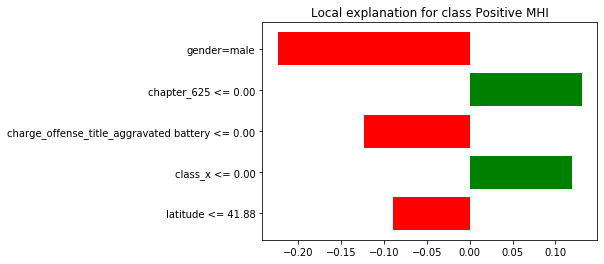

In [32]:
# Generate individual explanation
i = 80
print('Actual class: ', labels_test[i])
exp = explainer.explain_instance((X_test_decoded.values[i]), predict_fn, num_features=5)

# Visualize the explanation 
%matplotlib inline
fig = exp.as_pyplot_figure()

exp.show_in_notebook(show_all=False)

In [33]:
# Initialize the SP object
sp_obj = submodular_pick.SubmodularPick(explainer, X_train_decoded.values, predict_fn, sample_size=10, 
                                        num_features=5, num_exps_desired=8)

In [34]:
sp_obj.V

[3, 8, 1, 9, 2, 7, 6, 5]

#### Why are these indices all so low?

Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


Actual class:  0


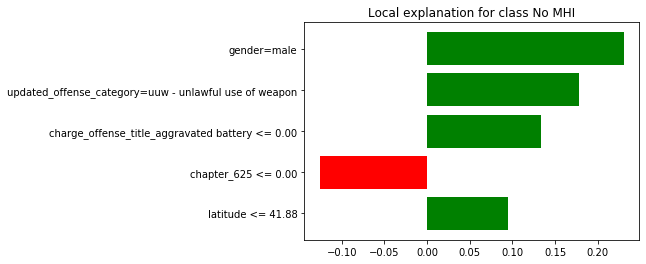

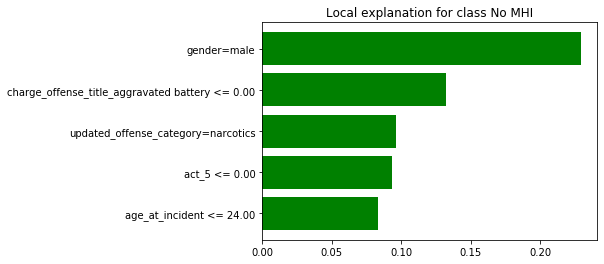

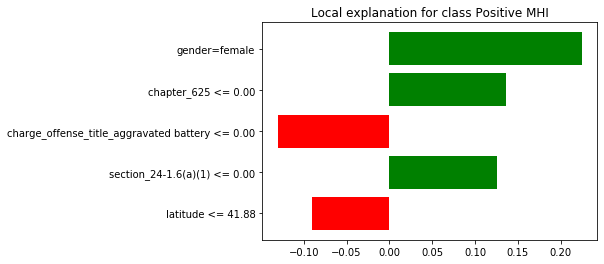

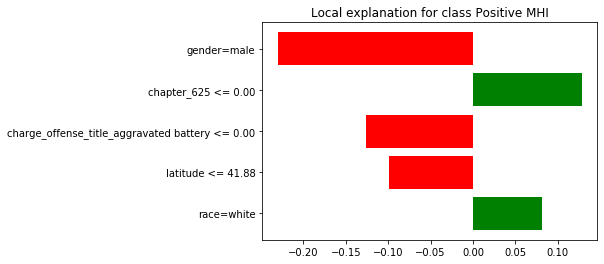

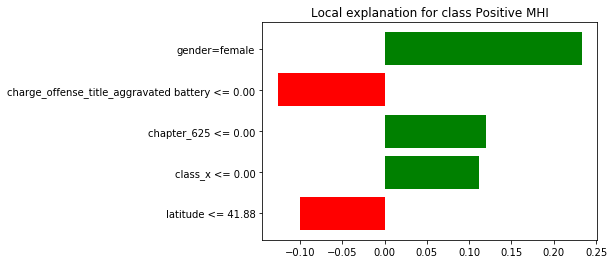

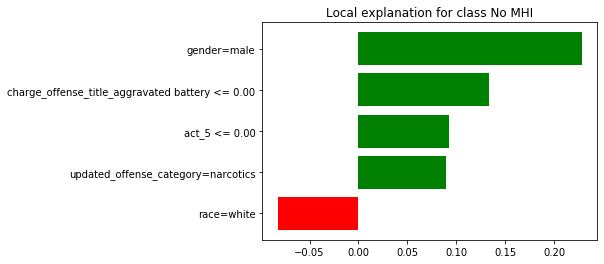

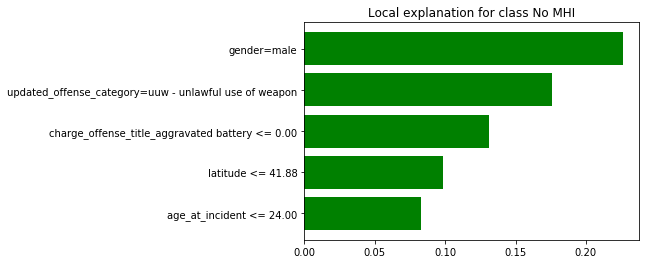

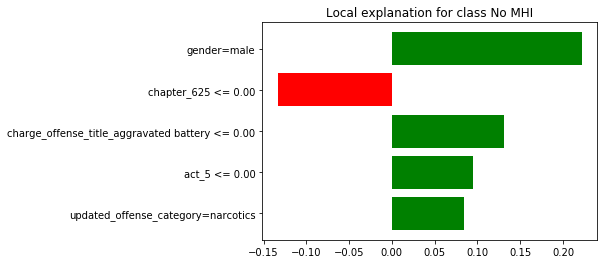

In [35]:
j = 0
for ind in sp_obj.V:
    exp = explainer.explain_instance(X_train_decoded.values[ind], predict_fn, num_features=5)
    print("Actual class: ", labels_test[ind])
    exp.show_in_notebook(show_all=False)
    exp.save_to_file('LIME_'+str(j))
    label = sp_obj.sp_explanations[j].available_labels()[0]
    sp_obj.sp_explanations[j].as_pyplot_figure(label=label)
    print("==========================")
    j+=1

# Section 4: Investigations into possible proxies
## 4a) Mutual information

In [5]:
# From lab 6
from sklearn.metrics import normalized_mutual_info_score

In [8]:
# Normalized mutual info score can't take NaN, turning NaN to 'nan'
init_no_nan = init.fillna('nan')

In [9]:
# Age is mixed numeric and string ('nan')- converting to all string
init_no_nan['age_at_incident'] = init_no_nan['age_at_incident'].astype(str)
init_no_nan['age_at_incident'].head()

0    22.0
1    22.0
2    22.0
3    22.0
4    22.0
Name: age_at_incident, dtype: object

In [10]:
mi_df = pd.DataFrame([], index = ['race', 'gender', 'age_at_incident'], columns = init.columns)

for row in ['race', 'gender', 'age_at_incident']:
    for col in init.columns:
        mi_df.loc[row][col] = normalized_mutual_info_score(init_no_nan[row],
                                                           init_no_nan[col],
                                                           average_method='arithmetic')

In [11]:
mi_df

,case_id,case_participant_id,offense_category,primary_charge,charge_id,charge_version_id,charge_offense_title,chapter,act,section,class,aoic,event,event_date,age_at_incident,gender,race,incident_begin_date,incident_end_date,arrest_date,law_enforcement_agency,unit,incident_city,received_date,arraignment_date,updated_offense_category,charge_count
race,0.151604,0.152347,0.0422885,0.00310771,0.135681,0.135681,0.0452288,0.0366324,0.0112102,0.0449289,0.0102986,0.0442377,0.00980688,0.0154073,0.00604407,0.0404818,1,0.0224738,0.0619385,0.145861,0.0740129,0.0465916,0.0755033,0.0192824,0.0191982,0.0441649,0.00329488
gender,0.0556943,0.0591457,0.024291,0.0043376,0.0503408,0.0503408,0.0225045,0.00319635,0.0055459,0.0210388,0.0095065,0.0200863,0.00422743,0.00403494,0.00178889,1,0.0404818,0.00590399,0.0232153,0.0536252,0.00941399,0.00191918,0.00821083,0.00513106,0.00565897,0.0253392,0.00242941
age_at_incident,0.454906,0.465504,0.0447778,0.0043277,0.417183,0.417183,0.0532881,0.0162319,0.0120333,0.0550195,0.00811874,0.0633833,0.00474799,0.0743783,1,0.00178889,0.00604407,0.110439,0.102064,0.448797,0.0268288,0.009141,0.0263488,0.0958923,0.0834161,0.0442596,0.0075965


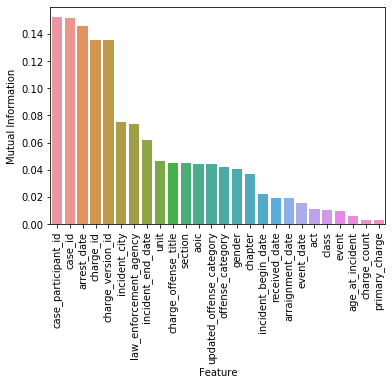

In [18]:
race_vals = mi_df.loc['race'].drop('race').sort_values(ascending = False)

g = sns.barplot(x=race_vals.index, y=race_vals)
g.set_xticklabels(race_vals.index, rotation=90)
g.set(xlabel='Feature', ylabel='Mutual Information')

plt.show()

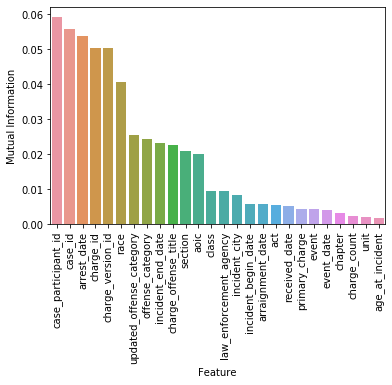

In [19]:
gender_vals = mi_df.loc['gender'].drop('gender').sort_values(ascending = False)

g = sns.barplot(x=gender_vals.index, y=gender_vals)
g.set_xticklabels(gender_vals.index, rotation=90)
g.set(xlabel='Feature', ylabel='Mutual Information')

plt.show()

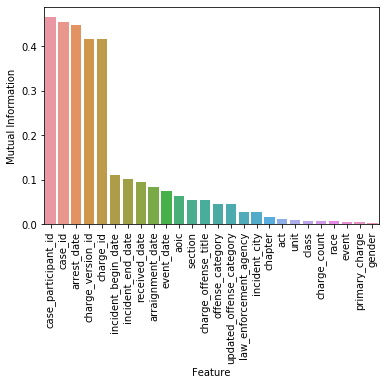

In [20]:
age_vals = mi_df.loc['age_at_incident'].drop('age_at_incident').sort_values(ascending = False)

g = sns.barplot(x=age_vals.index, y=age_vals)
g.set_xticklabels(age_vals.index, rotation=90)
g.set(xlabel='Feature', ylabel='Mutual Information')

plt.show()

In [22]:
# removing date and id cols which were not used for modeling 
time_features = ['event_date', 'incident_begin_date', 'arrest_date', 'received_date', 'arraignment_date',
                 'incident_end_date']
id_features = ['case_participant_id', 'case_id', 'primary_charge', 'charge_id', 'charge_version_id']

mi_df_reduced = mi_df.drop(columns=time_features + id_features)
mi_df_reduced

,offense_category,charge_offense_title,chapter,act,section,class,aoic,event,age_at_incident,gender,race,law_enforcement_agency,unit,incident_city,updated_offense_category,charge_count
race,0.0422885,0.0452288,0.0366324,0.0112102,0.0449289,0.0102986,0.0442377,0.00980688,0.00604407,0.0404818,1,0.0740129,0.0465916,0.0755033,0.0441649,0.00329488
gender,0.024291,0.0225045,0.00319635,0.0055459,0.0210388,0.0095065,0.0200863,0.00422743,0.00178889,1,0.0404818,0.00941399,0.00191918,0.00821083,0.0253392,0.00242941
age_at_incident,0.0447778,0.0532881,0.0162319,0.0120333,0.0550195,0.00811874,0.0633833,0.00474799,1,0.00178889,0.00604407,0.0268288,0.009141,0.0263488,0.0442596,0.0075965


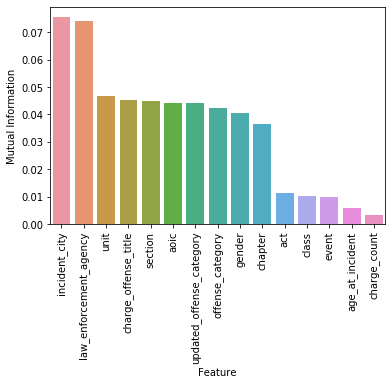

In [23]:
race_vals = mi_df_reduced.loc['race'].drop('race').sort_values(ascending = False)

g = sns.barplot(x=race_vals.index, y=race_vals)
g.set_xticklabels(race_vals.index, rotation=90)
g.set(xlabel='Feature', ylabel='Mutual Information')

plt.show()

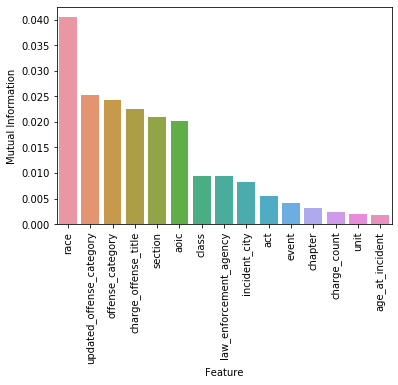

In [24]:
gender_vals = mi_df_reduced.loc['gender'].drop('gender').sort_values(ascending = False)

g = sns.barplot(x=gender_vals.index, y=gender_vals)
g.set_xticklabels(gender_vals.index, rotation=90)
g.set(xlabel='Feature', ylabel='Mutual Information')

plt.show()

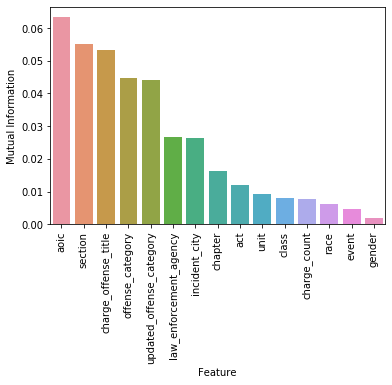

In [25]:
age_vals = mi_df_reduced.loc['age_at_incident'].drop('age_at_incident').sort_values(ascending = False)

g = sns.barplot(x=age_vals.index, y=age_vals)
g.set_xticklabels(age_vals.index, rotation=90)
g.set(xlabel='Feature', ylabel='Mutual Information')

plt.show()

## 4b) Retraining model without proxies

In [26]:
total_df = pd.read_pickle('total_df.pckl.gz', compression = 'gzip')

In [34]:
# protected features to remove: race, gender, age_at_incident
# proxies for protected features to remove: aoic, section, charge_offense_title, incident_city, law_enforcement_agency

cols = total_df.columns

# features that are one hot encoded
gender_cols = [i for i in cols if i.startswith('gender_')]
race_cols = [i for i in cols if i.startswith('race_')]
aoic_cols = [i for i in cols if i.startswith('aoic_')]
section_cols = [i for i in cols if i.startswith('section_')]
charge_offense_cols = [i for i in cols if i.startswith('charge_offense_title_')]
law_agency_cols = [i for i in cols if i.startswith('law_enforcement_agency_')]

# numeric columns, incident_city geoencoded to lat/lon
numeric_cols = ['age_at_incident', 'latitude', 'longitude'] 

# boolean columns, engineered from age
bool_age_cols = ['age_over_100', 'age_unknown']

In [62]:
# Get original number of features 
# (minus 2 for MHI and received_date, which are removed during splitting)
print('original number of features:', len(total_df.columns)-2)

# Get number of sensitive/proxy features we will remove
to_remove_proxies = gender_cols + race_cols + aoic_cols \
                    + section_cols + charge_offense_cols \
                    + law_agency_cols + numeric_cols + bool_age_cols
print('number to remove:', len(to_remove_proxies))

total_df_reduced_proxies = total_df.drop(columns = to_remove_proxies)
print('new number of features:', len(total_df_reduced_proxies.columns)-2)

original number of features: 5616
number to remove: 4994
new number of features: 622


In [63]:
#put earliest 85% of cases into training df, latest 15% of cases into test df
training_df_proxies, test_df_proxies = get_train_test(total_df_reduced_proxies, 
                                                      train_size=0.85, test_size=0.15)

# passing 50 to downsample function means training set will have 50% positive cases
training_df_proxies = downsample(training_df_proxies, 50)

X_train_proxies = training_df_proxies.drop('MHI', axis=1)
y_train_proxies = training_df_proxies['MHI']

X_test_proxies = test_df_proxies.drop('MHI', axis=1)
y_test_proxies = test_df_proxies['MHI']

In [64]:
from sklearn.metrics import roc_curve, auc, roc_auc_score, recall_score
from sklearn import metrics

clf_proxies = GradientBoostingClassifier(random_state=42, max_depth = 3, 
                                 min_samples_leaf = 10, learning_rate=.01, 
                                 n_estimators=1000)
clf_proxies.fit(X_train_proxies, y_train_proxies)
y_pred_proxies = clf_proxies.predict(X_test_proxies)
y_pred_proba_proxies = clf_proxies.predict_proba(X_test_proxies)
fpr_proxies, tpr_proxies, thresholds_proxies = roc_curve(y_test_proxies, y_pred_proba_proxies[:,1])
AUC_proxies = auc(fpr_proxies, tpr_proxies)
recall_proxies = metrics.recall_score(y_test_proxies, y_pred_proxies)

In [65]:
print('Recall: ', recall_proxies)
print('AUC: ', AUC_proxies)
print('Accuracy: ', metrics.accuracy_score(y_test_proxies, y_pred_proxies))
print('Number of positive cases predicted: ', np.sum(y_pred_proxies))
print('Actual number of positive cases in test set: ', np.sum(y_test_proxies))
print('Predicted prevalence: ', np.sum(y_pred_proxies)/len(y_pred_proxies))
print('Actual prevalence in test set: ', np.sum(y_test_proxies)/len(y_test_proxies))

Recall:  0.8115384615384615
AUC:  0.8284867285696694
Accuracy:  0.7415307981458847
Number of positive cases predicted:  11370
Actual number of positive cases in test set:  260
Predicted prevalence:  0.2622051057353043
Actual prevalence in test set:  0.0059958951179577055


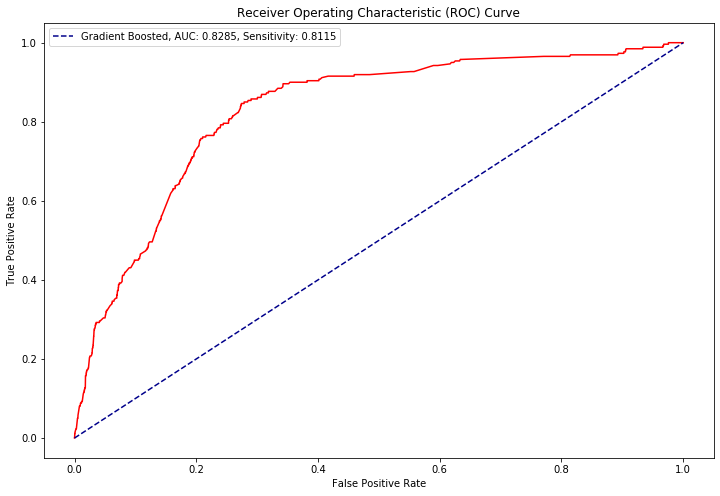

In [67]:
%matplotlib inline

plt.figure(figsize=(12,8))
plt.plot(fpr_proxies, tpr_proxies, color='red')
plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--', 
         label='Gradient Boosted, AUC: {:0.4f}, Sensitivity: {:0.4f}'.format(AUC_proxies, recall_proxies))
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

#### Relatively minor influence of removing protected features and proxies: ~2% increase in recall, 2% decrease in AUC without protected features and proxies. 

#### Curious what it looks like without just sensitive features

In [68]:
print('original number of features:', len(total_df.columns)-2)
to_remove_sensitive = gender_cols + race_cols + ['age_at_incident', 'age_over_100', 'age_unknown']
print('number to remove:', len(to_remove_sensitive))

total_df_reduced_sensitive = total_df.drop(columns = to_remove_sensitive)
print('new number of features:', len(total_df_reduced_sensitive.columns)-2)

original number of features: 5616
number to remove: 16
new number of features: 5600


In [69]:
#put earliest 85% of cases into training df, latest 15% of cases into test df
training_df_sensitive, test_df_sensitive = get_train_test(total_df_reduced_sensitive, 
                                                          train_size=0.85, test_size=0.15)

# passing 50 to downsample function means training set will have 50% positive cases
training_df_sensitive = downsample(training_df_sensitive, 50)

X_train_sensitive = training_df_sensitive.drop('MHI', axis=1)
y_train_sensitive = training_df_sensitive['MHI']

X_test_sensitive = test_df_sensitive.drop('MHI', axis=1)
y_test_sensitive = test_df_sensitive['MHI']

In [70]:
clf_sensitive = GradientBoostingClassifier(random_state=42, max_depth = 3, 
                                 min_samples_leaf = 10, learning_rate=.01, 
                                 n_estimators=1000)
clf_sensitive.fit(X_train_sensitive, y_train_sensitive)
y_pred_sensitive = clf_sensitive.predict(X_test_sensitive)
y_pred_proba_sensitive = clf_sensitive.predict_proba(X_test_sensitive)
fpr_sensitive, tpr_sensitive, thresholds_sensitive = roc_curve(y_test_sensitive, y_pred_proba_sensitive[:,1])
AUC_sensitive = auc(fpr_sensitive, tpr_sensitive)
recall_sensitive = metrics.recall_score(y_test_sensitive, y_pred_sensitive)

In [71]:
print('Recall: ', recall_sensitive)
print('AUC: ', AUC_sensitive)
print('Accuracy: ', metrics.accuracy_score(y_test_sensitive, y_pred_sensitive))
print('Number of positive cases predicted: ', np.sum(y_pred_sensitive))
print('Actual number of positive cases in test set: ', np.sum(y_test_sensitive))
print('Predicted prevalence: ', np.sum(y_pred_sensitive)/len(y_pred_sensitive))
print('Actual prevalence in test set: ', np.sum(y_test_sensitive)/len(y_test_sensitive))

Recall:  0.8038461538461539
AUC:  0.8431562857484487
Accuracy:  0.758549915826857
Number of positive cases predicted:  10628
Actual number of positive cases in test set:  260
Predicted prevalence:  0.24509374351405577
Actual prevalence in test set:  0.0059958951179577055


## 4c) Distributions of select proxies, KL tests 

In [6]:
# Taken from Responsible Data Science Lab 4 
# https://dataresponsibly.github.io/courses/spring20/
from scipy.stats import ks_2samp
from scipy.stats import entropy

def get_distribution_of_categorical_attribute(attribute: pd.Series, indicies=None):
    distribution = attribute.dropna().value_counts()
    if indicies is not None:
        for idx in set(indicies) - set(distribution.index):
            distribution.loc[idx] = 0
    distribution.sort_index(inplace=True)
    return distribution/sum(distribution)

def kl_test(df_in: pd.DataFrame, df_out: pd.DataFrame, attr: str):
    """
    df_in: the sensitive dataset
    df_out: the synthetic dataset
    attr: the attribute that will be calculated for KL-divergence.
    """
    distribution_in = get_distribution_of_categorical_attribute(df_in[attr])
    distribution_out = get_distribution_of_categorical_attribute(df_out[attr], distribution_in.index)
    return entropy(distribution_out, distribution_in)

In [7]:
cols = list(total_df.columns)
gender_cols = [i for i in cols if i.startswith('gender')]
race_cols = [i for i in cols if i.startswith('race')]
print(gender_cols)
print(race_cols)

['gender_female', 'gender_male', 'gender_unknown']
['race_albino', 'race_american indian', 'race_asian', 'race_biracial', 'race_black', 'race_hispanic', 'race_unknown', 'race_white', 'race_white [hispanic or latino]', 'race_white/black [hispanic or latino]']


In [8]:
def check_allcols_are_binary(df, start_string):
    ''' 
    Takes a OHE df and a string and checks if all columns starting with 
    that string are binary. If all columns are binary it returns the list of
    all column names, otherwise it returns a list of non_binary_cols.
    
    df: dataframe containing the OHE columns and data
    start_string: string that the OHE columns starts with (i.e. 'gender') 
    would return OHE columns ['gender_female', 'gender_male', 'gender_unknown']
    '''
    
    col_selection = [i for i in list(df.columns) if i.startswith(start_string)]
    non_binary_cols = []
    for column in col_selection:
        if is_binary(df[column]) != True:
            non_binary_cols.append(column)
    if non_binary_cols == []:
        print('All columns binary, returning complete column list')
        return col_selection
    else:
        print('Some columns not binary, returning list of non-binary columns')
        return non_binary_cols

In [9]:
# inpsiration from: https://stackoverflow.com/questions/38334296/reversing-
# one-hot-encoding-in-pandas
def undo_ohe_cols(df, col_subset):
    ''' 
    Takes a OHE df and a list of BINARY columns and undoes the OHE of those
    columns, returning a single series with original values in it.
    
    df: dataframe containing the OHE columns and data 
    col_subset: list of binary OHE columns on which you want to undo OHE
    '''

    df_subset = df[df.columns & col_subset]
    def undo_binary(row):
        for c in df_subset.columns:
            if row[c]==1:
                return c
    single_col = df_subset.apply(undo_binary, axis=1)
    return single_col

In [10]:
# check all cols are binary
race_cols = check_allcols_are_binary(total_df, 'race')

# since all binday, can undo-OHE
single_race_col = undo_ohe_cols(total_df, race_cols)

single_race_col.head()

All columns binary, returning complete column list


case_participant_id
260122253823                         race_black
272161011760                         race_black
864286527653                      race_hispanic
882206007016                         race_black
882242005211    race_white [hispanic or latino]
dtype: object

In [11]:
# check all cols are binary
gender_cols = check_allcols_are_binary(total_df, 'gender')

# since all binday, can undo-OHE
single_gender_col = undo_ohe_cols(total_df, gender_cols)

All columns binary, returning complete column list


### Looking at distribution of offense_category in the whole population vs in sub populations. Undoing the OHE first.

#### Conclusion: We don't see any real differences across total population and sub populations except for american indian and biracial, which each have relatively small sample size. 

In [25]:
# looking at offense_category
off_cols = check_allcols_are_binary(total_df, 'offense')

# all binary, so undoing OHE
single_off_col = undo_ohe_cols(total_df, off_cols)

All columns binary, returning complete column list


In [30]:
# Fixing columns to not have "Offense Category"
single_off_col = single_off_col.str.replace("offense_category_", "")

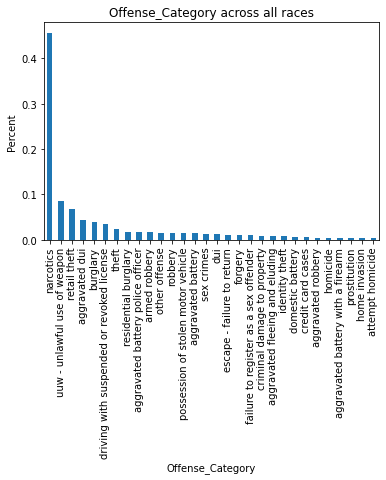

In [35]:
# looking at offense_category distribution for all races

# combining two series 
off_race_df = pd.concat([single_off_col.rename('offense'), single_race_col.rename('race')],
                        axis = 1)
val_counts = off_race_df['offense'].value_counts(normalize=
                                                   True).nlargest(30).plot(kind='bar')
plt.ylabel('Percent')
plt.xlabel('Offense_Category')
plt.title('Offense_Category across all races')

# saving top 20 offense_category across all races
top20allraces = list(off_race_df['offense'].value_counts().nlargest(20).index)

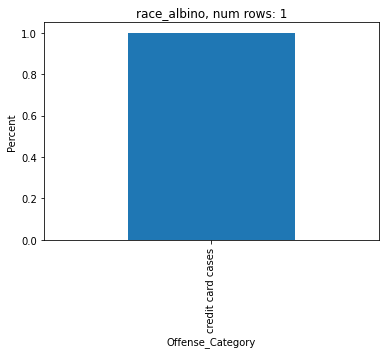

kl_test:  5.30349863544374
items in top 10 for this race that are not in top 20 items for all races:  {'credit card cases'}


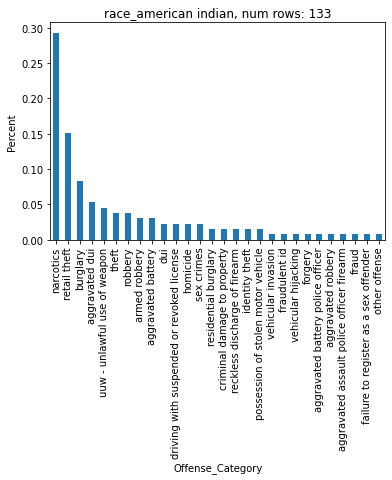

kl_test:  0.2993207886380759
items in top 10 for this race that are not in top 20 items for all races:  set()


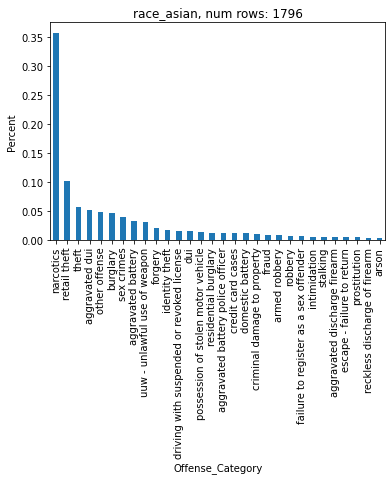

kl_test:  0.18615271057985555
items in top 10 for this race that are not in top 20 items for all races:  set()


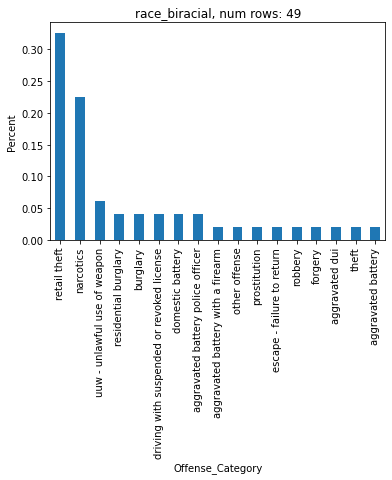

kl_test:  0.5960652819589437
items in top 10 for this race that are not in top 20 items for all races:  {'domestic battery'}


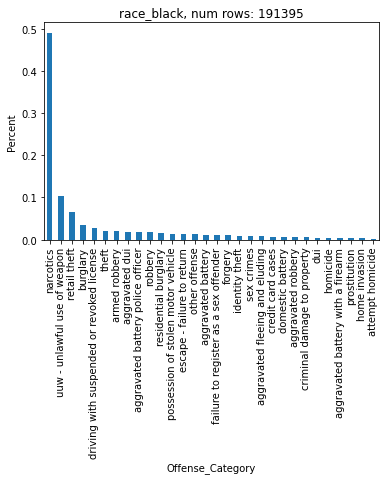

kl_test:  0.02132405743744574
items in top 10 for this race that are not in top 20 items for all races:  set()


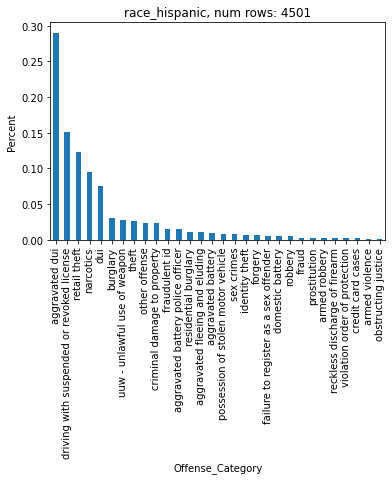

kl_test:  0.832861762774557
items in top 10 for this race that are not in top 20 items for all races:  set()


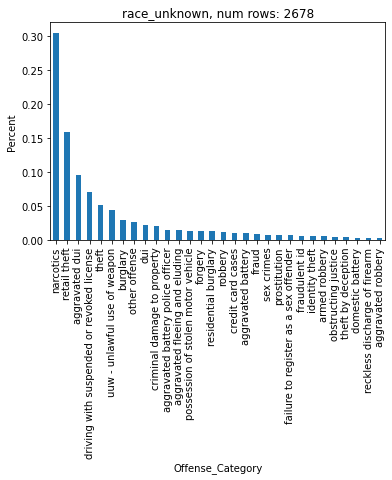

kl_test:  0.21036879846971263
items in top 10 for this race that are not in top 20 items for all races:  set()


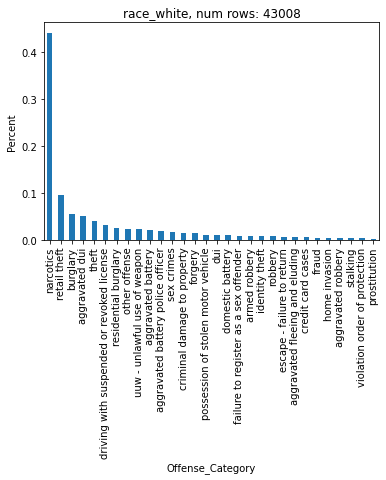

kl_test:  0.0725278748109411
items in top 10 for this race that are not in top 20 items for all races:  set()


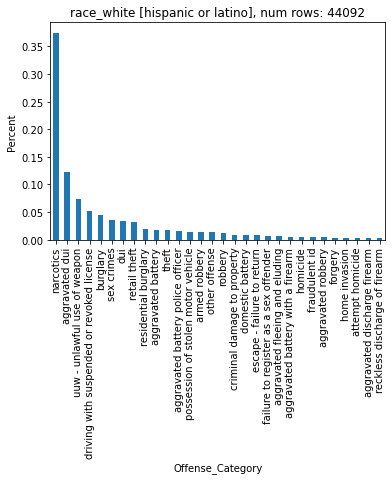

kl_test:  0.11231900155601396
items in top 10 for this race that are not in top 20 items for all races:  set()


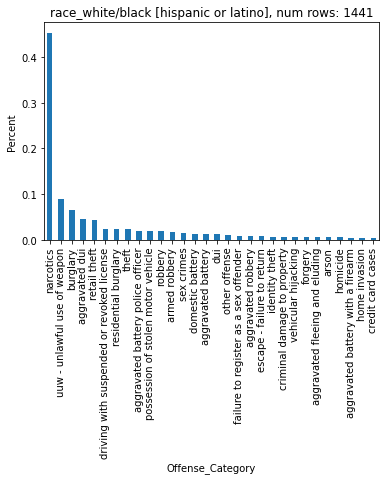

kl_test:  0.04913036050275245
items in top 10 for this race that are not in top 20 items for all races:  set()


In [36]:
# looking at offense distributions for each race
all_race_df = off_race_df

for col in race_cols:
    race_df = off_race_df[off_race_df['race'] == col]
    val_counts = race_df['offense'].value_counts(normalize=True).nlargest(30).plot(kind='bar')
    title = str(col) + ', num rows: ' + str(len(race_df))
    plt.xlabel('Offense_Category')
    plt.title(title)
    plt.ylabel('Percent')
    plt.show()
    print('kl_test: ', kl_test(all_race_df, race_df, 'offense'))
    top10 = race_df['offense'].value_counts(normalize=True).nlargest(10).index
    
    # print categories in top 10 that are not in race top 20
    print('items in top 10 for this race that are not in top 20 items for all races: ',
          set(top10) - set(top20allraces))

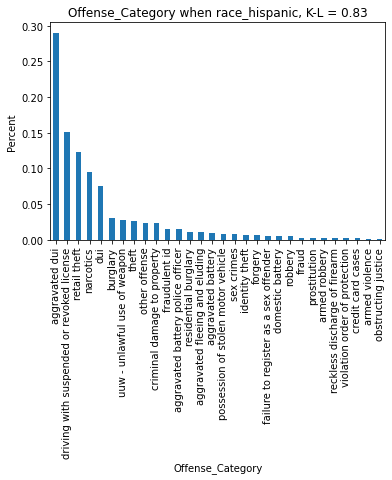

kl_test:  0.832861762774557
items in top 10 for this race that are not in top 20 items for all races:  set()


In [39]:
# Printing hispanic plot
col = 'race_hispanic'
race_df = off_race_df[off_race_df['race'] == col]
val_counts = race_df['offense'].value_counts(normalize=True).nlargest(30).plot(kind='bar')
kl = kl_test(all_race_df, race_df, 'offense')
title = 'Offense_Category when ' + str(col) + ', K-L = ' + format(kl, '.2f')
plt.xlabel('Offense_Category')
plt.title(title)
plt.ylabel('Percent')
plt.show()
print('kl_test: ', kl_test(all_race_df, race_df, 'offense'))
top10 = race_df['offense'].value_counts(normalize=True).nlargest(10).index

# print categories in top 10 that are not in race top 20
print('items in top 10 for this race that are not in top 20 items for all races: ',
      set(top10) - set(top20allraces))

### Same process with incident_city and race. See some pretty big differences in incident_city in the subpopulation graphs- especially with race = Hispanic.

In [14]:
# could be repeated for law_enforcement_agency

# check all cols are binary
city_cols = check_allcols_are_binary(total_df, 'incident_city')

# all binary so undoing OHE
single_city_col = undo_ohe_cols(total_df, city_cols)

All columns binary, returning complete column list


In [16]:
# Fixing columns to not have "incident_city_"
single_city_col = single_city_col.str.replace("incident_city_", "")
single_city_col.head()

case_participant_id
260122253823    unknown
272161011760    unknown
864286527653    unknown
882206007016    chicago
882242005211    chicago
dtype: object

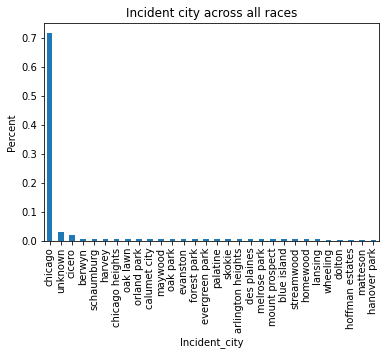

In [17]:
# looking at incident_city distribution for all races

# combining two series 
city_race_df = pd.concat([single_city_col.rename('incident_city'), 
                         single_race_col.rename('race')], axis = 1)
val_counts = city_race_df['incident_city'].value_counts(normalize=
                                                   True).nlargest(30).plot(kind='bar')
plt.ylabel('Percent')
plt.xlabel('Incident_city')
plt.title('Incident city across all races')

# saving top 20 incident cities across all races
top20allraces = list(city_race_df['incident_city'].value_counts().nlargest(20).index)

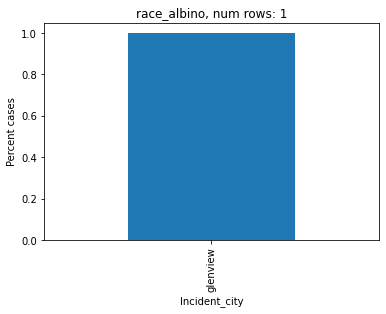

kl_test:  6.1594102145531355
items in top 10 for this race that are not in top 20 items for all races:  {'glenview'}


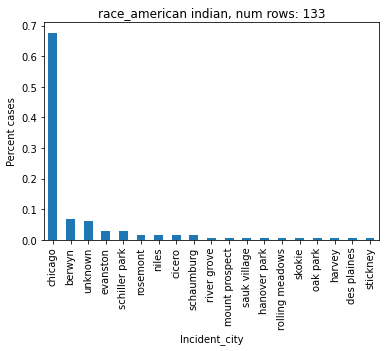

kl_test:  0.44052141719026733
items in top 10 for this race that are not in top 20 items for all races:  {'rolling meadows', 'niles', 'rosemont', 'schiller park'}


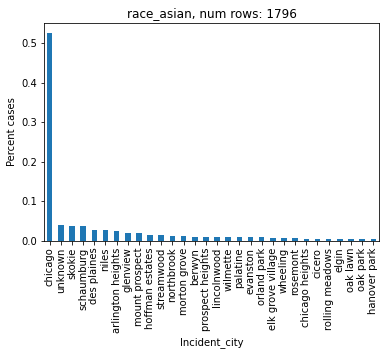

kl_test:  0.420278993396598
items in top 10 for this race that are not in top 20 items for all races:  {'mount prospect', 'niles', 'glenview', 'hoffman estates'}


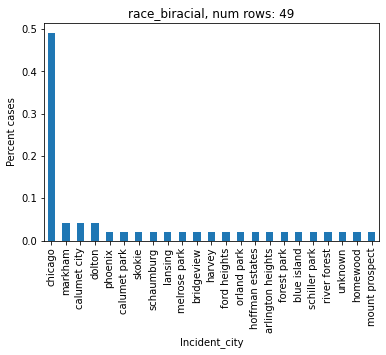

kl_test:  0.8076322989726237
items in top 10 for this race that are not in top 20 items for all races:  {'blue island', 'homewood', 'markham', 'river forest', 'dolton', 'schiller park'}


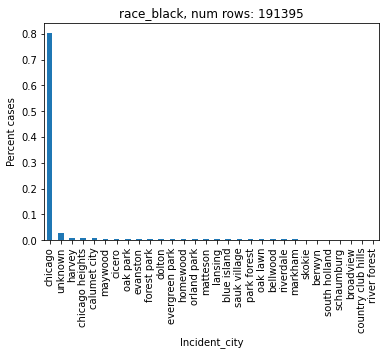

kl_test:  0.05127681154761064
items in top 10 for this race that are not in top 20 items for all races:  set()


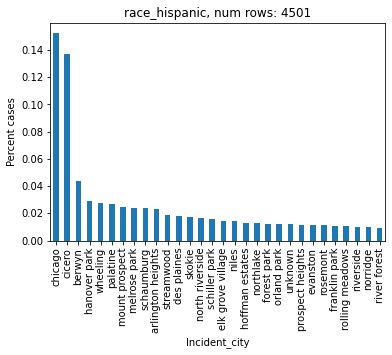

kl_test:  1.0488983299097099
items in top 10 for this race that are not in top 20 items for all races:  {'wheeling', 'mount prospect', 'hanover park'}


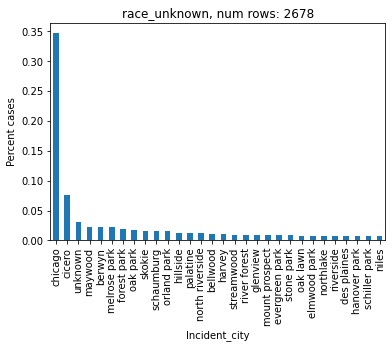

kl_test:  0.41679887808035565
items in top 10 for this race that are not in top 20 items for all races:  set()


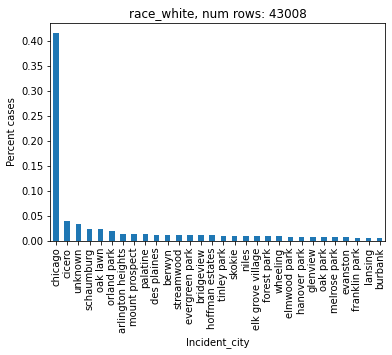

kl_test:  0.2870293917946419
items in top 10 for this race that are not in top 20 items for all races:  {'mount prospect'}


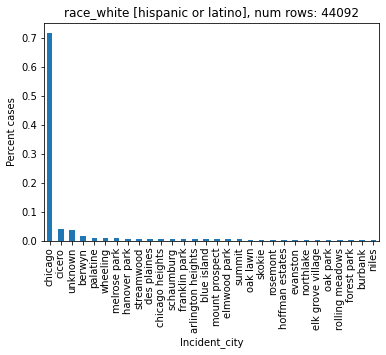

kl_test:  0.06323665644676342
items in top 10 for this race that are not in top 20 items for all races:  {'wheeling', 'hanover park', 'streamwood'}


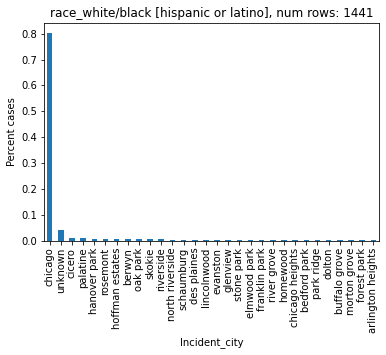

kl_test:  0.11899364498883305
items in top 10 for this race that are not in top 20 items for all races:  {'hoffman estates', 'hanover park', 'rosemont'}


In [18]:
# looking at incident_city distributions for each race
all_race_df = city_race_df

for col in race_cols:
    race_df = city_race_df[city_race_df['race'] == col]
    val_counts = race_df['incident_city'].value_counts(normalize=
                                                               True).nlargest(30).plot(kind=
                                                                                       'bar')
    title = str(col) + ', num rows: ' + str(len(race_df))
    plt.xlabel('Incident_city')
    plt.title(title)
    plt.ylabel('Percent cases')
    plt.show()
    print('kl_test: ', kl_test(all_race_df, race_df, 'incident_city'))
    top10 = race_df['incident_city'].value_counts(normalize=True).nlargest(10).index
    
    # print incident cities in top 10 that are not in race top 20
    print('items in top 10 for this race that are not in top 20 items for all races: ',
          set(top10) - set(top20allraces))

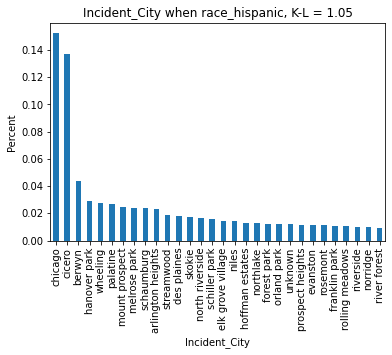

In [20]:
# Printing hispanic plot
col = 'race_hispanic'
race_df = city_race_df[city_race_df['race'] == col]
val_counts = race_df['incident_city'].value_counts(normalize=True).nlargest(30).plot(kind='bar')
kl = kl_test(all_race_df, race_df, 'incident_city')
title = 'Incident_City when ' + str(col) + ', K-L = ' + format(kl, '.2f')
plt.xlabel('Incident_City')
plt.title(title)
plt.ylabel('Percent')
plt.show()

### Repeating same process but looking at law_enforcement_agency distribution. See some pretty clear racial divides in neighborhoods and law_enforcement_agencys in the subpopulation graphs

In [18]:
# could be repeated for law_enforcement_agency

# check all cols are binary
law_cols = check_allcols_are_binary(total_df, 'law')

# all binary so undoing OHE
single_law_col = undo_ohe_cols(total_df, law_cols)

All columns binary, returning complete column list


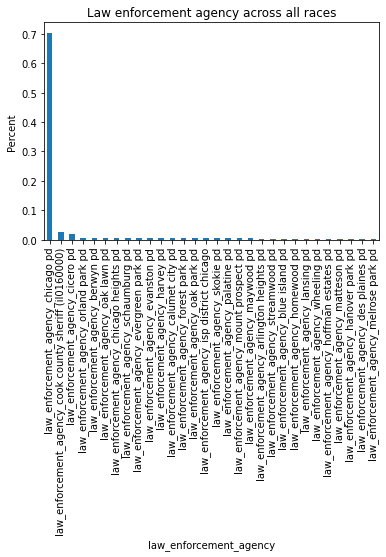

In [19]:
# looking at law_enforcement_agency distribution for all races

# combining two series 
law_race_df = pd.concat([single_law_col.rename('law_enforcement_agency'), 
                         single_race_col.rename('race')], axis = 1)
val_counts = law_race_df['law_enforcement_agency'].value_counts(normalize=
                                                   True).nlargest(30).plot(kind='bar')
plt.ylabel('Percent')
plt.xlabel('law_enforcement_agency')
plt.title('Law enforcement agency across all races')

# saving top 20 law_enfrocement_agency across all races
top20allraces = list(law_race_df['law_enforcement_agency'].value_counts().nlargest(20).index)

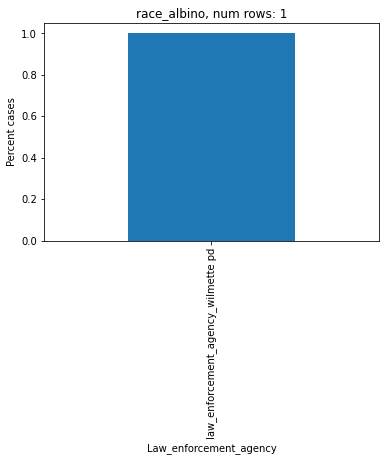

kl_test:  6.575570611778049
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_wilmette pd'}


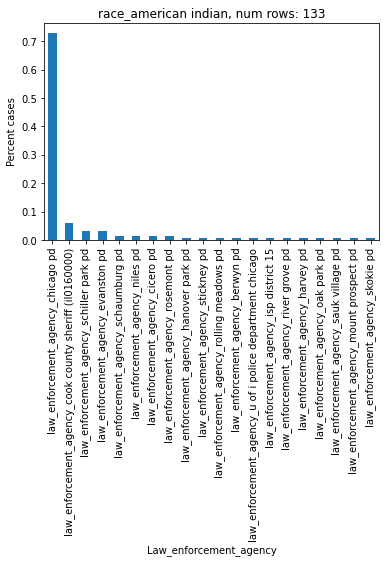

kl_test:  0.3822467243664565
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_sauk village pd', 'law_enforcement_agency_schiller park pd', 'law_enforcement_agency_niles pd', 'law_enforcement_agency_rosemont pd'}


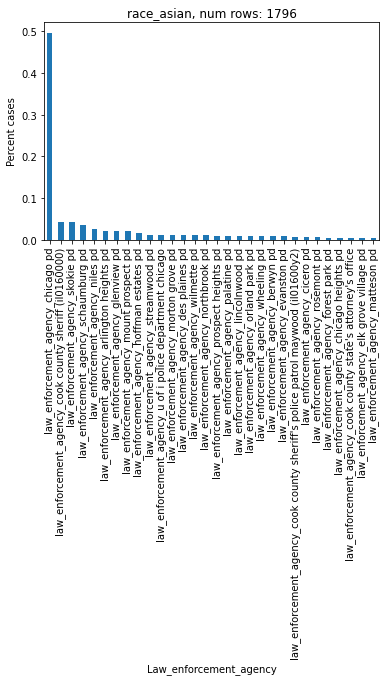

kl_test:  0.44832879038170353
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_streamwood pd', 'law_enforcement_agency_hoffman estates pd', 'law_enforcement_agency_glenview pd', 'law_enforcement_agency_niles pd'}


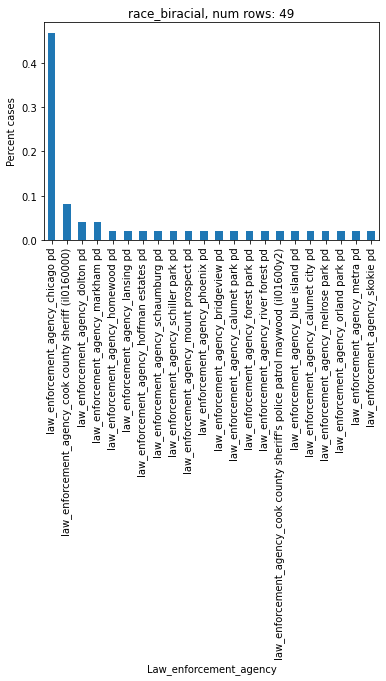

kl_test:  0.8983346995809111
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_blue island pd', 'law_enforcement_agency_melrose park pd', "law_enforcement_agency_cook county sheriff's police patrol maywood (il01600y2)", 'law_enforcement_agency_metra pd', 'law_enforcement_agency_dolton pd', 'law_enforcement_agency_markham pd'}


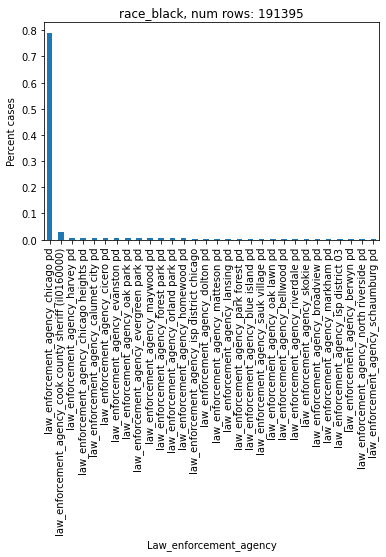

kl_test:  0.05082778813110558
items in top 10 for this race that are not in top 20 items for all races:  set()


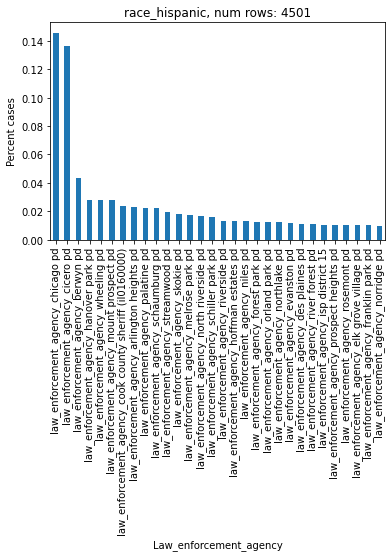

kl_test:  1.0362988366104031
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_wheeling pd', 'law_enforcement_agency_hanover park pd'}


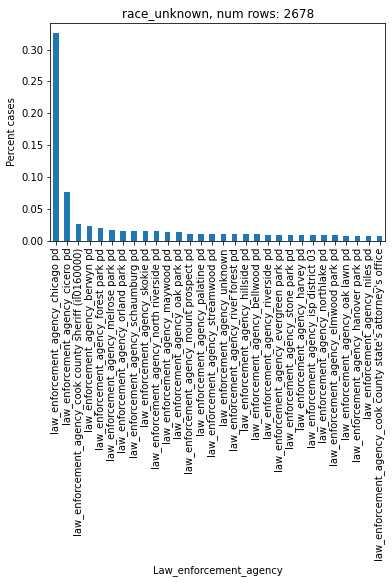

kl_test:  0.45563699768589183
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_melrose park pd', 'law_enforcement_agency_north riverside pd'}


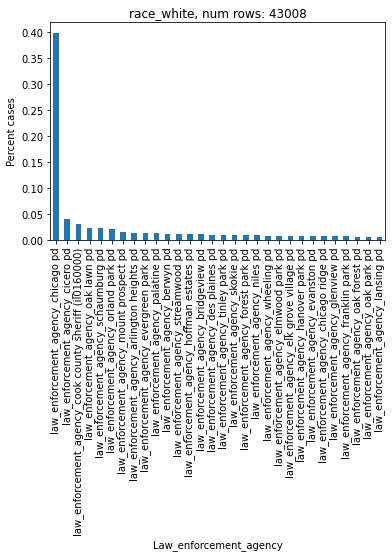

kl_test:  0.2953812487934171
items in top 10 for this race that are not in top 20 items for all races:  set()


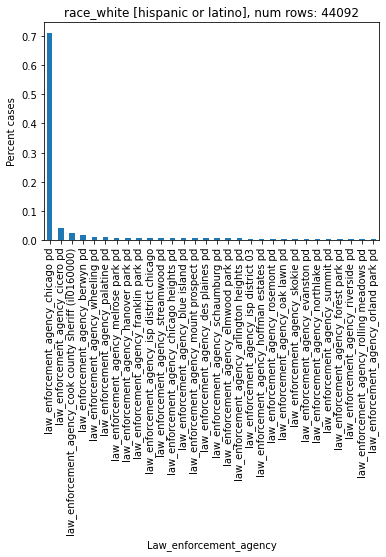

kl_test:  0.06499914946986557
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_franklin park pd', 'law_enforcement_agency_melrose park pd', 'law_enforcement_agency_wheeling pd', 'law_enforcement_agency_hanover park pd'}


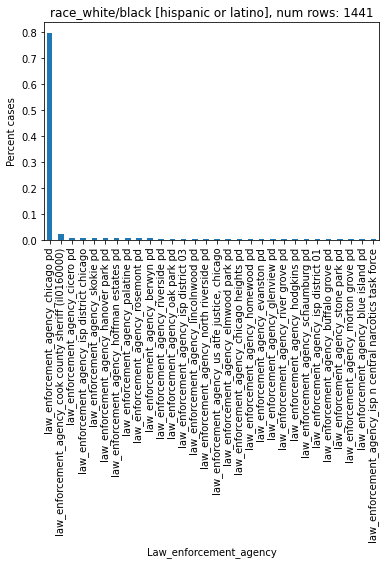

kl_test:  0.13433363063950005
items in top 10 for this race that are not in top 20 items for all races:  {'law_enforcement_agency_hoffman estates pd', 'law_enforcement_agency_rosemont pd', 'law_enforcement_agency_hanover park pd'}


In [20]:
# looking at law_enforcement_agency distributions for each race
all_race_df = law_race_df

for col in race_cols:
    race_df = law_race_df[law_race_df['race'] == col]
    val_counts = race_df['law_enforcement_agency'].value_counts(normalize=
                                                               True).nlargest(30).plot(kind=
                                                                                       'bar')
    title = str(col) + ', num rows: ' + str(len(race_df))
    plt.xlabel('Law_enforcement_agency')
    plt.title(title)
    plt.ylabel('Percent cases')
    plt.show()
    print('kl_test: ', kl_test(all_race_df, race_df, 'law_enforcement_agency'))
    top10 = race_df['law_enforcement_agency'].value_counts(normalize=True).nlargest(10).index
    
    # print agencies in top 10 that are not in race top 20
    print('items in top 10 for this race that are not in top 20 items for all races: ',
          set(top10) - set(top20allraces))

### Diving a little deeper to see correlations between certain neighborhoods and races. For example, we see 'law_enforcement_agency_wheeling pd' and 'law_enforcement_agency_hanover park pd' in 'race_hispanic' and 'race_white [hispanic or latino]'   distribution top 10, but not top 20 of all races.. Does it have a high correlation with hispanic? 

In [21]:
# one hot encoding law_enforcement_agency and race
dummy_lawrace = pd.get_dummies(law_race_df)
dummy_lawrace.head()

,law_enforcement_agency_law_enforcement_agency_alsip pd,law_enforcement_agency_law_enforcement_agency_amtrak national railroad passenger corp,law_enforcement_agency_law_enforcement_agency_arlington heights pd,law_enforcement_agency_law_enforcement_agency_barrington hills pd,law_enforcement_agency_law_enforcement_agency_barrington pd,law_enforcement_agency_law_enforcement_agency_bartlett pd,law_enforcement_agency_law_enforcement_agency_bedford park pd,law_enforcement_agency_law_enforcement_agency_bellwood pd,law_enforcement_agency_law_enforcement_agency_berkeley pd,law_enforcement_agency_law_enforcement_agency_berwyn pd,law_enforcement_agency_law_enforcement_agency_blue island pd,law_enforcement_agency_law_enforcement_agency_bolingbrook p.d.,law_enforcement_agency_law_enforcement_agency_bridgeview pd,law_enforcement_agency_law_enforcement_agency_broadview pd,law_enforcement_agency_law_enforcement_agency_brookfield pd,law_enforcement_agency_law_enforcement_agency_buffalo grove pd,law_enforcement_agency_law_enforcement_agency_burbank pd,law_enforcement_agency_law_enforcement_agency_burlington northern santa fe railroad pd,law_enforcement_agency_law_enforcement_agency_burnham pd,law_enforcement_agency_law_enforcement_agency_burr ridge pd,law_enforcement_agency_law_enforcement_agency_c p d area 1 dist 2,law_enforcement_agency_law_enforcement_agency_c p d area 2,law_enforcement_agency_law_enforcement_agency_c p d area 3,law_enforcement_agency_law_enforcement_agency_c p d area 4 vc,law_enforcement_agency_law_enforcement_agency_calumet city pd,law_enforcement_agency_law_enforcement_agency_calumet city police department,law_enforcement_agency_law_enforcement_agency_calumet park pd,law_enforcement_agency_law_enforcement_agency_canadian national railroad police,law_enforcement_agency_law_enforcement_agency_carol stream pd,law_enforcement_agency_law_enforcement_agency_chicago heights pd,law_enforcement_agency_law_enforcement_agency_chicago pd,law_enforcement_agency_law_enforcement_agency_chicago pd - area central,law_enforcement_agency_law_enforcement_agency_chicago pd - area south,law_enforcement_agency_law_enforcement_agency_chicago police dept,law_enforcement_agency_law_enforcement_agency_chicago ridge pd,law_enforcement_agency_law_enforcement_agency_chicago state univ pd,"law_enforcement_agency_law_enforcement_agency_chicago transit auth, insp general",law_enforcement_agency_law_enforcement_agency_cicero pd,law_enforcement_agency_law_enforcement_agency_conrail railroad pd,law_enforcement_agency_law_enforcement_agency_cook co sheriff off,law_enforcement_agency_law_enforcement_agency_cook county dept. of corrections,law_enforcement_agency_law_enforcement_agency_cook county forest preserve police dept,law_enforcement_agency_law_enforcement_agency_cook county john stroger hsptl police department,law_enforcement_agency_law_enforcement_agency_cook county sheriff (il0160000),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - bridgeview (il01600y9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - markham (il01600y6),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - maywood (il01600x9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's fugitive-warrants (il0169q00),law_enforcement_agency_law_enforcement_agency_cook county sheriff's gangs (il01600e8),law_enforcement_agency_law_enforcement_agency_cook county sheriff's patrol desk (il01600e9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol - dom viol (il016b300),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol bridgeview (il016a700),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol crim ct (il016b200),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol desplaines (il016a900),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol markham (

In [22]:
# making abs value corr matrix so we can sort by "largest" regardless of correlation direction
corr = dummy_lawrace.corr()
corrabs = corr.abs()

In [23]:
corrabs['law_enforcement_agency_law_enforcement_agency_hanover park pd'].nlargest(7)

law_enforcement_agency_law_enforcement_agency_hanover park pd                    1.000000
law_enforcement_agency_law_enforcement_agency_chicago pd                         0.085999
race_race_hispanic                                                               0.056441
race_race_black                                                                  0.056430
race_race_white                                                                  0.027177
race_race_white [hispanic or latino]                                             0.024586
law_enforcement_agency_law_enforcement_agency_cook county sheriff (il0160000)    0.009293
Name: law_enforcement_agency_law_enforcement_agency_hanover park pd, dtype: float64

In [24]:
corrabs['law_enforcement_agency_law_enforcement_agency_wheeling pd'].nlargest(7)

law_enforcement_agency_law_enforcement_agency_wheeling pd                        1.000000
law_enforcement_agency_law_enforcement_agency_chicago pd                         0.090012
race_race_black                                                                  0.071723
race_race_hispanic                                                               0.052822
race_race_white [hispanic or latino]                                             0.042226
race_race_white                                                                  0.031891
law_enforcement_agency_law_enforcement_agency_cook county sheriff (il0160000)    0.009727
Name: law_enforcement_agency_law_enforcement_agency_wheeling pd, dtype: float64

# Section 5: Looking into relationship between incident_city and law_enforcement_agency

In [25]:
# checking incident_city binary

# check all cols are binary
city_cols = check_allcols_are_binary(total_df, 'incident_city')

# all binary so undoing OHE
single_city_col = undo_ohe_cols(total_df, city_cols)

All columns binary, returning complete column list


In [26]:
# making combined df of law_enforcement_agency and incident_city
city_law_df = pd.concat([single_law_col.rename('law_enforcement_agency'), 
                         single_city_col.rename('incident_city')], axis = 1)

In [27]:
# ohe both columns
dummy_law_city = pd.get_dummies(city_law_df)
dummy_law_city.head()

,law_enforcement_agency_law_enforcement_agency_alsip pd,law_enforcement_agency_law_enforcement_agency_amtrak national railroad passenger corp,law_enforcement_agency_law_enforcement_agency_arlington heights pd,law_enforcement_agency_law_enforcement_agency_barrington hills pd,law_enforcement_agency_law_enforcement_agency_barrington pd,law_enforcement_agency_law_enforcement_agency_bartlett pd,law_enforcement_agency_law_enforcement_agency_bedford park pd,law_enforcement_agency_law_enforcement_agency_bellwood pd,law_enforcement_agency_law_enforcement_agency_berkeley pd,law_enforcement_agency_law_enforcement_agency_berwyn pd,law_enforcement_agency_law_enforcement_agency_blue island pd,law_enforcement_agency_law_enforcement_agency_bolingbrook p.d.,law_enforcement_agency_law_enforcement_agency_bridgeview pd,law_enforcement_agency_law_enforcement_agency_broadview pd,law_enforcement_agency_law_enforcement_agency_brookfield pd,law_enforcement_agency_law_enforcement_agency_buffalo grove pd,law_enforcement_agency_law_enforcement_agency_burbank pd,law_enforcement_agency_law_enforcement_agency_burlington northern santa fe railroad pd,law_enforcement_agency_law_enforcement_agency_burnham pd,law_enforcement_agency_law_enforcement_agency_burr ridge pd,law_enforcement_agency_law_enforcement_agency_c p d area 1 dist 2,law_enforcement_agency_law_enforcement_agency_c p d area 2,law_enforcement_agency_law_enforcement_agency_c p d area 3,law_enforcement_agency_law_enforcement_agency_c p d area 4 vc,law_enforcement_agency_law_enforcement_agency_calumet city pd,law_enforcement_agency_law_enforcement_agency_calumet city police department,law_enforcement_agency_law_enforcement_agency_calumet park pd,law_enforcement_agency_law_enforcement_agency_canadian national railroad police,law_enforcement_agency_law_enforcement_agency_carol stream pd,law_enforcement_agency_law_enforcement_agency_chicago heights pd,law_enforcement_agency_law_enforcement_agency_chicago pd,law_enforcement_agency_law_enforcement_agency_chicago pd - area central,law_enforcement_agency_law_enforcement_agency_chicago pd - area south,law_enforcement_agency_law_enforcement_agency_chicago police dept,law_enforcement_agency_law_enforcement_agency_chicago ridge pd,law_enforcement_agency_law_enforcement_agency_chicago state univ pd,"law_enforcement_agency_law_enforcement_agency_chicago transit auth, insp general",law_enforcement_agency_law_enforcement_agency_cicero pd,law_enforcement_agency_law_enforcement_agency_conrail railroad pd,law_enforcement_agency_law_enforcement_agency_cook co sheriff off,law_enforcement_agency_law_enforcement_agency_cook county dept. of corrections,law_enforcement_agency_law_enforcement_agency_cook county forest preserve police dept,law_enforcement_agency_law_enforcement_agency_cook county john stroger hsptl police department,law_enforcement_agency_law_enforcement_agency_cook county sheriff (il0160000),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - bridgeview (il01600y9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - markham (il01600y6),law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - maywood (il01600x9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's fugitive-warrants (il0169q00),law_enforcement_agency_law_enforcement_agency_cook county sheriff's gangs (il01600e8),law_enforcement_agency_law_enforcement_agency_cook county sheriff's patrol desk (il01600e9),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol - dom viol (il016b300),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol bridgeview (il016a700),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol crim ct (il016b200),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol desplaines (il016a900),law_enforcement_agency_law_enforcement_agency_cook county sheriff's police patrol markham (

[Text(0.5, 0, 'law_enforcement_agency_law_enforcement_agency_alsip pd'),
 Text(22.5, 0, 'law_enforcement_agency_law_enforcement_agency_c p d area 3'),
 Text(44.5, 0, "law_enforcement_agency_law_enforcement_agency_cook county sheriff's crt srvcs - bridgeview (il01600y9)"),
 Text(66.5, 0, 'law_enforcement_agency_law_enforcement_agency_crestwood pd'),
 Text(88.5, 0, 'law_enforcement_agency_law_enforcement_agency_franklin park pd'),
 Text(110.5, 0, 'law_enforcement_agency_law_enforcement_agency_idoc pontiac'),
 Text(132.5, 0, 'law_enforcement_agency_law_enforcement_agency_isp district 04'),
 Text(154.5, 0, 'law_enforcement_agency_law_enforcement_agency_isp doo zone 1, elgin'),
 Text(176.5, 0, 'law_enforcement_agency_law_enforcement_agency_lynwood pd'),
 Text(198.5, 0, 'law_enforcement_agency_law_enforcement_agency_norridge pd'),
 Text(220.5, 0, 'law_enforcement_agency_law_enforcement_agency_phoenix pd'),
 Text(242.5, 0, 'law_enforcement_agency_law_enforcement_agency_south suburban college 

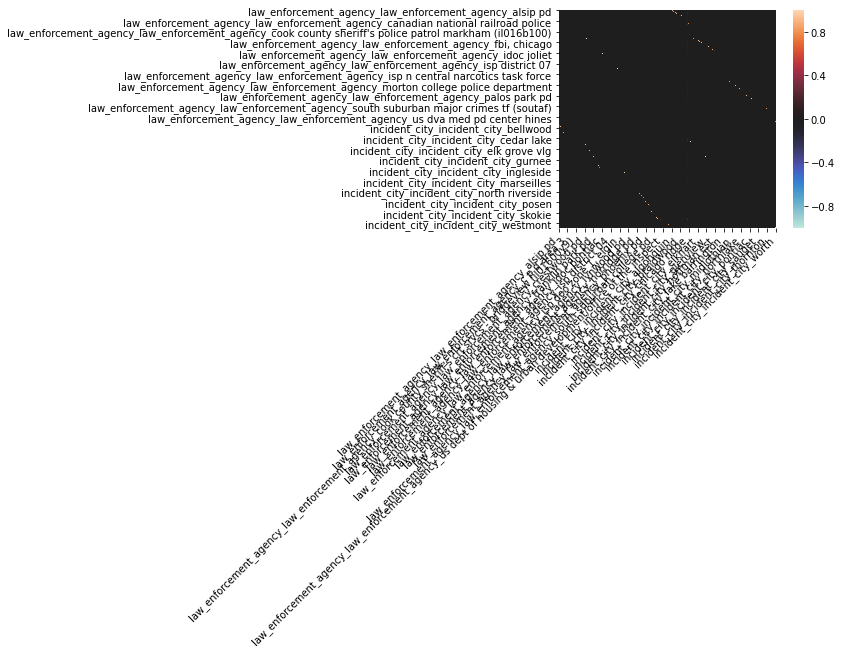

In [28]:
# trying big heat map
# inspiration from https://towardsdatascience.com/better-heatmaps-and-
# correlation-matrix-plots-in-python-41445d0f2bec

corr = dummy_law_city.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    #cmap=sns.diverging_palette(20, 220, n=200),
    square=True)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right')

In [29]:
# heatmap pretty illegible so looking just at row/cols with values above 0.9-> reduces to dimension ~100
m = (corr.mask(np.eye(len(corr), dtype=bool)).abs() > 0.9).any()
raw = corr.loc[m, m]
raw

,law_enforcement_agency_law_enforcement_agency_bartlett pd,law_enforcement_agency_law_enforcement_agency_bedford park pd,law_enforcement_agency_law_enforcement_agency_berkeley pd,law_enforcement_agency_law_enforcement_agency_berwyn pd,law_enforcement_agency_law_enforcement_agency_blue island pd,law_enforcement_agency_law_enforcement_agency_brookfield pd,law_enforcement_agency_law_enforcement_agency_buffalo grove pd,law_enforcement_agency_law_enforcement_agency_burbank pd,law_enforcement_agency_law_enforcement_agency_calumet city pd,law_enforcement_agency_law_enforcement_agency_cicero pd,law_enforcement_agency_law_enforcement_agency_countryside pd,law_enforcement_agency_law_enforcement_agency_crestwood pd,law_enforcement_agency_law_enforcement_agency_deerfield pd,law_enforcement_agency_law_enforcement_agency_elgin pd,law_enforcement_agency_law_enforcement_agency_elmwood park pd,law_enforcement_agency_law_enforcement_agency_evanston pd,law_enforcement_agency_law_enforcement_agency_evergreen park pd,law_enforcement_agency_law_enforcement_agency_flossmoor pd,law_enforcement_agency_law_enforcement_agency_forest park pd,law_enforcement_agency_law_enforcement_agency_glenwood pd,law_enforcement_agency_law_enforcement_agency_hanover park pd,law_enforcement_agency_law_enforcement_agency_harwood heights pd,law_enforcement_agency_law_enforcement_agency_hodgkins pd,law_enforcement_agency_law_enforcement_agency_homewood pd,law_enforcement_agency_law_enforcement_agency_inverness police department,law_enforcement_agency_law_enforcement_agency_kenilworth pd,law_enforcement_agency_law_enforcement_agency_lansing pd,law_enforcement_agency_law_enforcement_agency_lemont pd,law_enforcement_agency_law_enforcement_agency_lincolnwood pd,law_enforcement_agency_law_enforcement_agency_matteson pd,law_enforcement_agency_law_enforcement_agency_midlothian pd,law_enforcement_agency_law_enforcement_agency_morton grove pd,law_enforcement_agency_law_enforcement_agency_niles pd,law_enforcement_agency_law_enforcement_agency_norridge pd,law_enforcement_agency_law_enforcement_agency_north riverside pd,law_enforcement_agency_law_enforcement_agency_northlake pd,law_enforcement_agency_law_enforcement_agency_oak lawn pd,law_enforcement_agency_law_enforcement_agency_palatine pd,law_enforcement_agency_law_enforcement_agency_park forest pd,law_enforcement_agency_law_enforcement_agency_park ridge pd,law_enforcement_agency_law_enforcement_agency_phoenix pd,law_enforcement_agency_law_enforcement_agency_prospect heights pd,law_enforcement_agency_law_enforcement_agency_richton park pd,law_enforcement_agency_law_enforcement_agency_river forest pd,law_enforcement_agency_law_enforcement_agency_rosemont pd,law_enforcement_agency_law_enforcement_agency_sauk village pd,law_enforcement_agency_law_enforcement_agency_schaumburg pd,law_enforcement_agency_law_enforcement_agency_schiller park pd,law_enforcement_agency_law_enforcement_agency_streamwood pd,law_enforcement_agency_law_enforcement_agency_summit pd,law_enforcement_agency_law_enforcement_agency_tinley park pd,law_enforcement_agency_law_enforcement_agency_westchester pd,law_enforcement_agency_law_enforcement_agency_wheeling pd,incident_city_incident_city_bartlett,incident_city_incident_city_bedford park,incident_city_incident_city_berkeley,incident_city_incident_city_berwyn,incident_city_incident_city_blue island,incident_city_incident_city_brookfield,incident_city_incident_city_buffalo grove,incident_city_incident_city_burbank,incident_city_incident_city_calumet city,incident_city_incident_city_cicero,incident_city_incident_city_countryside,incident_city_incident_city_crestwood,incident_city_incident_city_deerfield,incident_city_incident_city_elgin,incident_city_incident_city_elmwood park,incident_city_incident_city_evanston,incident_city_incident_city_evergreen park,incident_city_incident_city_flossmoor,incident_city_incident_city_forest park,incident_city_incident_city_glenwood,incident_city_incident_city_hanover park,incident_

[Text(0.5, 0, 'law_enforcement_agency_law_enforcement_agency_bartlett pd'),
 Text(5.5, 0, 'law_enforcement_agency_law_enforcement_agency_brookfield pd'),
 Text(10.5, 0, 'law_enforcement_agency_law_enforcement_agency_countryside pd'),
 Text(15.5, 0, 'law_enforcement_agency_law_enforcement_agency_evanston pd'),
 Text(20.5, 0, 'law_enforcement_agency_law_enforcement_agency_hanover park pd'),
 Text(25.5, 0, 'law_enforcement_agency_law_enforcement_agency_kenilworth pd'),
 Text(30.5, 0, 'law_enforcement_agency_law_enforcement_agency_midlothian pd'),
 Text(35.5, 0, 'law_enforcement_agency_law_enforcement_agency_northlake pd'),
 Text(40.5, 0, 'law_enforcement_agency_law_enforcement_agency_phoenix pd'),
 Text(45.5, 0, 'law_enforcement_agency_law_enforcement_agency_sauk village pd'),
 Text(50.5, 0, 'law_enforcement_agency_law_enforcement_agency_tinley park pd'),
 Text(55.5, 0, 'incident_city_incident_city_berkeley'),
 Text(60.5, 0, 'incident_city_incident_city_burbank'),
 Text(65.5, 0, 'incident

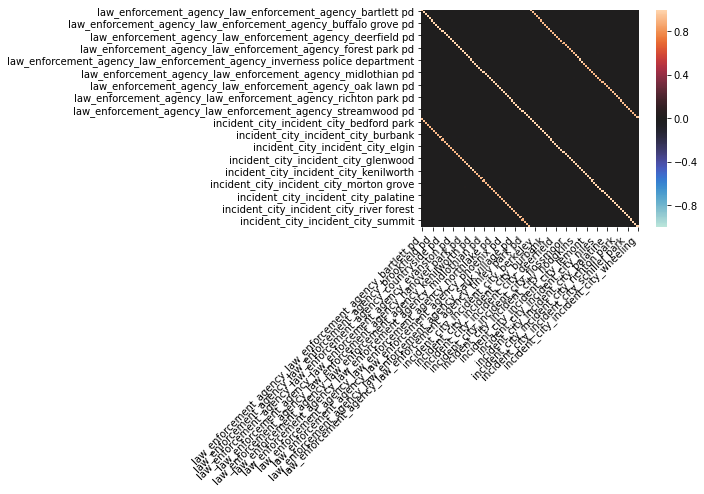

In [30]:
# trying heat map again with just 100 top correlated features 

ax = sns.heatmap(
    raw, 
    vmin=-1, vmax=1, center=0,
    #cmap=sns.diverging_palette(20, 220, n=200),
    square=True)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right')

### Above we can see some of the correlations (where they exist) between incident_city and law_enforcement_agency. Below some of the explict correlation values.

In [31]:
raw['incident_city_incident_city_bedford park'].nlargest(5)

incident_city_incident_city_bedford park                                     1.000000
law_enforcement_agency_law_enforcement_agency_bedford park pd                0.938504
law_enforcement_agency_law_enforcement_agency_summit pd                      0.001483
law_enforcement_agency_law_enforcement_agency_burbank pd                     0.000968
law_enforcement_agency_law_enforcement_agency_inverness police department   -0.000189
Name: incident_city_incident_city_bedford park, dtype: float64

In [32]:
raw['law_enforcement_agency_law_enforcement_agency_bartlett pd'].nlargest(5)

law_enforcement_agency_law_enforcement_agency_bartlett pd                    1.000000
incident_city_incident_city_bartlett                                         0.949413
incident_city_incident_city_hanover park                                     0.000633
incident_city_incident_city_streamwood                                       0.000270
law_enforcement_agency_law_enforcement_agency_inverness police department   -0.000156
Name: law_enforcement_agency_law_enforcement_agency_bartlett pd, dtype: float64

In [33]:
raw['law_enforcement_agency_law_enforcement_agency_streamwood pd'].nlargest(5)

law_enforcement_agency_law_enforcement_agency_streamwood pd    1.000000
incident_city_incident_city_streamwood                         0.946547
incident_city_incident_city_hanover park                       0.012641
incident_city_incident_city_schaumburg                         0.005578
incident_city_incident_city_bartlett                           0.002280
Name: law_enforcement_agency_law_enforcement_agency_streamwood pd, dtype: float64

In [34]:
# Looking at each row in complete OHE dataset to see if each one has a match
corrabs = corr.abs()
for col in corrabs.columns[:40]:
    print(corrabs[col].nlargest(2))

law_enforcement_agency_law_enforcement_agency_alsip pd    1.000000
incident_city_incident_city_alsip                         0.887403
Name: law_enforcement_agency_law_enforcement_agency_alsip pd, dtype: float64
law_enforcement_agency_law_enforcement_agency_amtrak national railroad passenger corp    1.000000
incident_city_incident_city_university park                                              0.075358
Name: law_enforcement_agency_law_enforcement_agency_amtrak national railroad passenger corp, dtype: float64
law_enforcement_agency_law_enforcement_agency_arlington heights pd    1.000000
incident_city_incident_city_arlington heights                         0.876563
Name: law_enforcement_agency_law_enforcement_agency_arlington heights pd, dtype: float64
law_enforcement_agency_law_enforcement_agency_barrington hills pd    1.000000
incident_city_incident_city_barrington hills                         0.516367
Name: law_enforcement_agency_law_enforcement_agency_barrington hills pd, dtype: fl

### We can see that there is usually, but not always a law_enforcement_agency correlated to incident_city. For example in the second case above ('law_enforcement_agency_amtrak national railroad passenger corp') there is no strongly correlated incident_city. 

Number of numeric columns:  2840 

AxesSubplot(0.125,0.125;0.775x0.755)


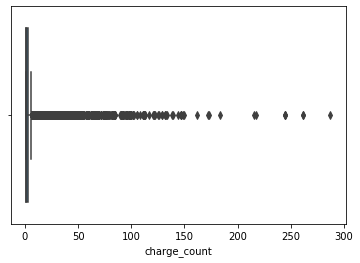

In [41]:
'''
Copied from Data Analysis.ipynb

Identifying numeric (non-boolean) columns 
and visualizing distribution/outliers with boxplot of charge_count
'''

bool_cols = [col for col in total_df if np.isin(total_df[col].dropna().unique(), [0, 1]).all()]
non_bool = total_df.columns.difference(bool_cols)
print('Number of numeric columns: ', len(non_bool), '\n')
print(sns.boxplot(x=total_df['charge_count']))

# Section 6: MHI Distributions and Comparison to Ground Truth

#### Portions of this section have been copied from Data Analysis.ipynb

In [157]:
'''
Function to return the fraction of positive instances in inputted subset
'''

def get_portion_true (subset):
    num_true = len(subset[subset['MHI']==1])
    return (num_true/len(subset))

In [158]:
''' 
FEATURE ENGINEERING FOR DATA ANAYLSIS:
create days_since_received feature

chose received because it's the only "start" date without missing values

number of days calculated by subtracting 
from data upload date of December 02, 2019

Useful for censoring analysis
'''

upload_date = pd.to_datetime(pd.datetime.strptime('12/2/2019', '%m/%d/%Y'))
received_date_dt = pd.to_datetime(total_df.received_date)
total_df['days_since_received'] = (upload_date - received_date_dt).astype(str)
total_df['days_since_received'] = total_df['days_since_received'].map(lambda x: x.partition(' ')[0])
total_df['days_since_received'] = total_df['days_since_received'].astype(int)

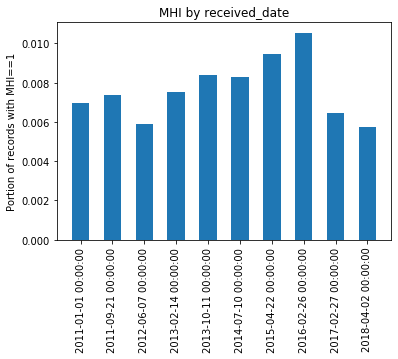

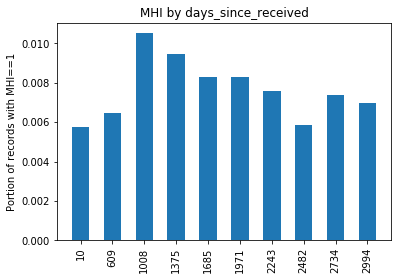

In [159]:
'''
Data Analysis:
Distribution of MHI over Time
'''

def plot_deciles(df, col):

    #get the total number of rows in the df
    n = len(df)

    #sort df by column of interest
    sorted_df = df.sort_values(by=[col])

    #create deciles, ie bins of the column of interest
    decile_1 = sorted_df.iloc[0:round(n/10)]
    decile_2 = sorted_df.iloc[round(n/10):round(2*n/10)]
    decile_3 = sorted_df.iloc[round(2*n/10):round(3*n/10)]
    decile_4 = sorted_df.iloc[round(3*n/10):round(4*n/10)]
    decile_5 = sorted_df.iloc[round(4*n/10):round(5*n/10)]
    decile_6 = sorted_df.iloc[round(5*n/10):round(6*n/10)]
    decile_7 = sorted_df.iloc[round(6*n/10):round(7*n/10)]
    decile_8 = sorted_df.iloc[round(7*n/10):round(8*n/10)]
    decile_9 = sorted_df.iloc[round(8*n/10):round(9*n/10)]
    decile_10 = sorted_df.iloc[round(9*n/10):n]

    #list of deciles
    deciles = [decile_1, decile_2, decile_3, decile_4, decile_5, 
           decile_6, decile_7, decile_8, decile_9, decile_10]

    #create list of portions
    portions = [get_portion_true(x) for x in deciles]

    #create string labels of earliest date in decile
    labels = [str(x.iloc[0][col]) for x in deciles]

    #plot
    fig, ax = plt.subplots()
    ax.bar(labels, portions, width=.55)
    ax.set_xticklabels(labels, rotation = 90)
    ax.set_ylabel('Portion of records with MHI==1')
    plt.title('MHI by {}'.format(col))
    plt.show()
    return

time_features_to_plot = ['received_date', 'days_since_received']

for column in time_features_to_plot:
      plot_deciles(total_df, column)

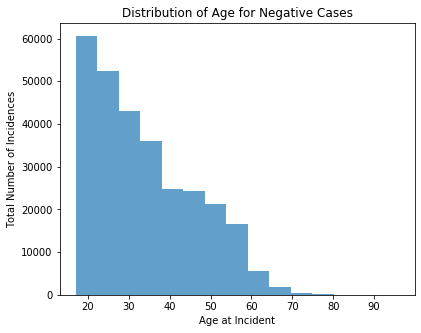

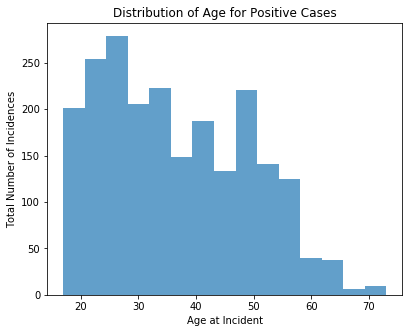

In [45]:
'''
Distribution of Age
in Positive vs. Negative Cases
'''

plt.figure(figsize=(14,5))
plt.subplot(1,2,1)
plt.hist(total_df['age_at_incident'][total_df['MHI'] == 0], bins=15, alpha = 0.7, label = 'MHI False')
plt.ylabel('Total Number of Incidences')
plt.xlabel('Age at Incident')
plt.title('Distribution of Age for Negative Cases')
plt.show()

plt.figure(figsize=(14,5))
plt.subplot(1,2,1)
plt.hist(total_df['age_at_incident'][total_df['MHI'] == 1], bins=15, alpha = 0.7, label = 'MHI True')
plt.xlabel('Age at Incident')
plt.ylabel('Total Number of Incidences')
plt.title('Distribution of Age for Positive Cases')
plt.show()

In [782]:
race_dict = {'Hispanic or Latino': ['race_hispanic', 
                                    'race_white [hispanic or latino]', 
                                    'race_white/black [hispanic or latino]'], 
             'Black': ['race_black'],
             'White': ['race_white'], 
             'Asian': ['race_asian'], 
             'American Indian': ['race_american indian'], 
             'Two or More': ['race_biracial']}

chi_races = ['Hispanic or Latino', 'Black', 'White']

race_ill = np.array([.058, .092, .056, np.nan, np.nan, np.nan])
race_help = np.array([.244, .319, .547, np.nan, np.nan, np.nan])

race_ami = np.array([0.152, .162, .204, .145, .194, .189, .286])
race_ami_serv = np.array([.326, .48, .306, .202, np.nan, .384])
race_smi = np.array([0.032, 0.035, 0.052, 0.024, 0.051, 0.081])
race_smi_serv = np.array([0.562, 0.562, 0.707, np.nan, np.nan, np.nan])


race_mhi_us = []
race_mhi_chi = []
for key, col_list in race_dict.items():
    index_groups = [list(total_df[total_df[x]==1].index) \
                            for x in col_list]
    mask = list(itertools.chain(*index_groups))
    portion = get_portion_true(total_df.loc[mask])
    race_mhi_us.append(portion)
    if key in chi_races:
        race_mhi_chi.append(portion)
race_mhi_us = np.array(race_mhi_us)
race_order_us = np.argsort(race_mhi_us)

race_mhi_chi = np.array(race_mhi_chi)
race_order_chi = np.argsort(race_mhi_chi)

race_labels_us = np.array(['Hispanic or Latino', 
                        'Black*', 'White*', r'Asian*$^\dagger$', 
                        r'American Indian*$^\dagger$', r'Two or More*$^\dagger$'])

race_labels_chi = np.array(['Hispanic\nor Latino', 
                        'Black*', 'White*'])

In [399]:
gender_dict = {'Female': ['gender_female'],
               'Male': ['gender_male']}

gender_ill = np.array([.067, .065])
gender_help = np.array([.353, .415])

gender_ami = np.array([.223, .151])
gender_ami_serv = np.array([0.476, 0.348])
gender_smi = np.array([0.057, 0.033])
gender_smi_serv = np.array([.715, 0.577])

gender_mhi = []
for key, col_list in gender_dict.items():
    index_groups = [list(total_df[total_df[x]==1].index) \
                            for x in col_list]
    mask = list(itertools.chain(*index_groups))
    gender_mhi.append(get_portion_true(total_df.loc[mask]))
gender_mhi = np.array(gender_mhi)
gender_order = np.argsort(gender_mhi)

In [587]:
cut_us = pd.cut(total_df['age_at_incident'], 
                         bins=[18, 26, 50,
                               X_test['age_at_incident'].max()+1], 
                         labels=False, right=False, retbins=True)
            
# save age_at_incident encoded by bin numbers
age_binned_us = cut_us[0]
bins_us = cut_us[1]

age_ami = np.array([.258, .222, .138])
age_ami_serv = np.array([.384, .433, .442])
age_smi = np.array([0.075, 0.056, 0.027])
age_smi_serv = np.array([.574, .662, .756])

age_mhi_us= []
for i in range(len(bins_us)-1):
    mask = age_binned_us[age_binned_us==i].index
    age_mhi_us.append(get_portion_true(total_df.loc[mask]))
age_mhi_us = np.array(age_mhi_us)

In [402]:
cut_chi = pd.cut(total_df['age_at_incident'], 
                         bins=[18, 30, 45, 65,
                               X_test['age_at_incident'].max()+1], 
                         labels=False, right=False, retbins=True)
            
# save age_at_incident encoded by bin numbers
age_binned_chi = cut_chi[0]
bins_chi = cut_chi[1]

age_ill = np.array([0.087, .056, 0.078, 0.028])
age_help = np.array([.222, .426, .512, 0.403])

age_mhi_chi= []
for i in range(len(bins_chi)-1):
    mask = age_binned_chi[age_binned_chi==i].index
    age_mhi_chi.append(get_portion_true(total_df.loc[mask]))
age_mhi_chi = np.array(age_mhi_chi)

In [ ]:
# Set colors for plots

mhi_color = '#679170'

distress_color = '#1d4159'
treat_color = '#142733'
 
smi_color = '#3b2f52'
smi_serv_color = '#231c2e'

ami_color = '#85799c'
ami_serv_color = '#594b73'

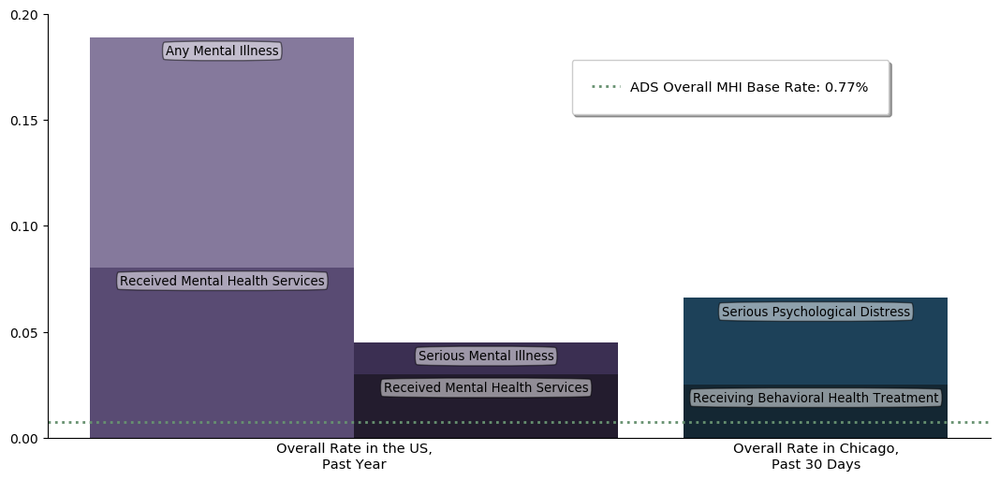

In [705]:
'''
Overall Plot
'''

fig, ax = plt.subplots(1, 1, figsize=(13, 6), dpi=100)

ads_base_rate = total_df['MHI'].sum()/len(total_df)

plt.axhline(ads_base_rate, 
            color=mhi_color, linestyle='dotted', linewidth=2, label='ADS MHI Base Rate')

any_mi_us = ax.bar([1], .189, 
             label='Any Mental Illness, US', color=ami_color)


any_treat_us = ax.bar([1], .189*.426, 
             label='Any Mental Illness & Treatment, US', color=ami_serv_color)


srs_us = ax.bar([1.8], 0.045, 
             label='Serious Mental Illness, US', color=smi_color)

srs_treat_us = ax.bar([1.8], 0.045*.667, 
             label='Serious Mental Illness & Treatment, US', color=smi_serv_color)


srs_chi = ax.bar([2.8], 0.066, 
             label='Serious Distress, Chicago', color=distress_color)

srs_treat_chi = ax.bar([2.8], 0.066*0.384, 
             label='Serious Distress & Treatment, Chicago', color=treat_color)





ax.xaxis.set_ticks([1.4, 2.8])
ax.set_xticklabels(labels = ['Overall Rate in the US,\nPast Year',
                             'Overall Rate in Chicago,\nPast 30 Days'], fontsize=14)
ax.yaxis.set_ticks(np.arange(0,0.22, 0.05))


def autolabel(rects, text):
    """
    Adapted from: https://matplotlib.org/gallery/api/barchart.html
    
    Attach a text label above each bar in *rects*, displaying its height.

    pos* indicates which side to place the text w.r.t. the center of
    the bar. It can be one of the following {'center', 'right', 'left'}.
    """
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()*.5, height-.0095,
                text, ha='center', va='bottom', fontsize=9.5, color='black', 
               bbox=dict(facecolor='white', alpha=0.5, boxstyle='Round4'))

autolabel(srs_treat_chi, 'Receiving Behavioral Health Treatment')
autolabel(srs_treat_us, 'Received Mental Health Services')
autolabel(any_treat_us, 'Received Mental Health Services')
autolabel(any_mi_us, 'Any Mental Illness')
autolabel(srs_us, 'Serious Mental Illness')
autolabel(srs_chi, 'Serious Psychological Distress')

ax.set_axisbelow(True)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(labelsize=10.5, axis='x', which='both', length=0)
#ax.grid(which='major', axis='y', alpha=0.5)

fig.legend(labels = ['ADS Overall MHI Base Rate: {:0.2f}%'.format(ads_base_rate*100)], 
           loc='upper center', 
           bbox_to_anchor=(0.6, 0.76), framealpha=1, borderpad=1.5, shadow=True, fontsize=10.5)

plt.show()


In [469]:
gender_smi_serv

array([0.715, 0.577])

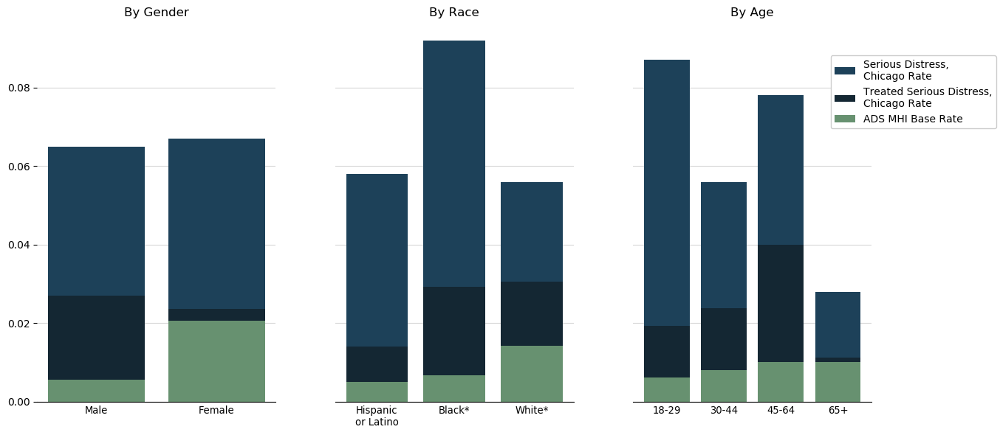

In [783]:
'''
Chicago Plot
'''
fig, ax = plt.subplots(1, 3, figsize=(12, 6), dpi=100, sharey=True, sharex=False)



ax[0].bar([1, 2], gender_ill[gender_order], 
             label='Serious Distress, Chicago Rate', color=distress_color)

ax[0].bar([1, 2], (gender_ill*gender_help)[gender_order], 
             label='Treated Serious Distress, Chicago Rate', color=treat_color)

ax[0].bar([1, 2], gender_mhi[gender_order], 
             label = 'ADS MHI Base Rate', color=mhi_color)

ax[0].xaxis.set_ticks([1,2])
ax[0].set_xticklabels(labels = np.array(list(gender_dict.keys()))[gender_order])
ax[0].set_title('By Gender')




ax[1].bar([1, 2, 3], race_ill[race_order_chi], 
             label='Chicago Distress Rate', color=distress_color)

ax[1].bar([1, 2, 3], (race_ill*race_help)[race_order_chi], 
             label='Chicago Treatment Rate', color=treat_color)

ax[1].bar([1, 2, 3,], race_mhi_chi[race_order_chi], 
             label = 'ADS MHI Base Rate', color=mhi_color)

ax[1].xaxis.set_ticks([1,2,3])
ax[1].set_xticklabels(labels = race_labels_chi[race_order_chi], ha='center')
ax[1].set_title('By Race')




ax[2].bar([1, 2, 3, 4], age_ill, 
             label='Chicago Distress Rate', color=distress_color)

ax[2].bar([1, 2, 3, 4], age_ill*age_help, 
             label='Chicago Treatment Rate', color=treat_color)

ax[2].bar([1, 2, 3, 4], age_mhi_chi, 
             label = 'ADS MHI Base Rate', color=mhi_color)
ax[2].xaxis.set_ticks([1, 2, 3, 4])
ax[2].set_xticklabels(labels = ['18-29', '30-44', '45-64', '65+'])
ax[2].set_title('By Age')

for i in range(3):
        ax[i].set_axisbelow(True)
        ax[i].spines['right'].set_visible(False)
        ax[i].spines['left'].set_visible(False)
        ax[i].spines['top'].set_visible(False)
        ax[i].tick_params(labelsize=9.5, axis='x', which='both', length=0)
        if i>0:
            ax[i].tick_params(axis='y', which='both', length=0)
        ax[i].grid(which='both', axis='y', alpha=0.5)
            
        
fig.legend(labels = ['Serious Distress,\nChicago Rate', 
                     'Treated Serious Distress,\nChicago Rate',
                     'ADS MHI Base Rate'], loc='upper right', 
           bbox_to_anchor=(1.13, 0.87), framealpha=1)

fig.tight_layout() 
plt.subplots_adjust(wspace=.25)  

plt.show()

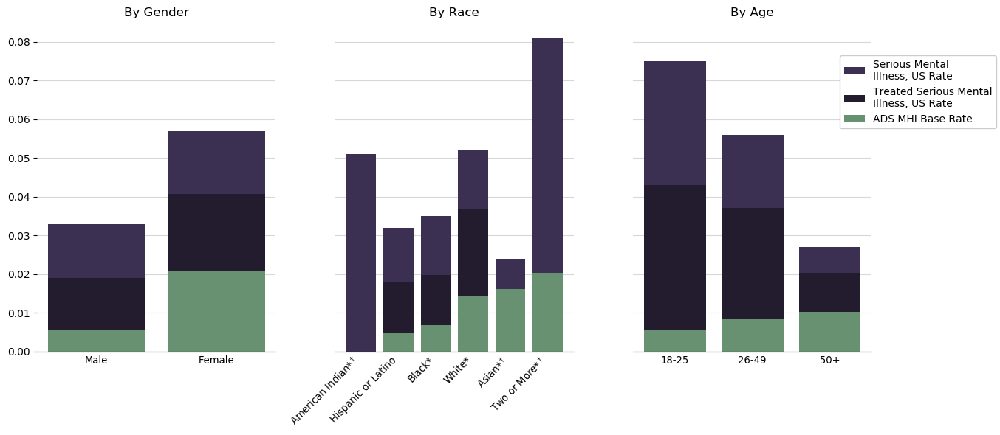

In [784]:
'''
US Plot
'''

fig, ax = plt.subplots(1, 3, figsize=(12, 6), dpi=100, sharey=True, sharex=False)



ax[0].bar([1, 2], gender_smi[gender_order], 
             label='Serious Mental Illness, US Rate', color=smi_color)

ax[0].bar([1, 2], (gender_smi_serv*gender_smi)[gender_order], 
             label='Treated Serious Mental Illness, US Rate', color=smi_serv_color)

ax[0].bar([1, 2], gender_mhi[gender_order], 
             label = 'ADS MHI Base Rate', color=mhi_color)

ax[0].xaxis.set_ticks([1,2])
ax[0].set_xticklabels(labels = np.array(list(gender_dict.keys()))[gender_order])
ax[0].set_title('By Gender')



ax[1].bar([1, 2, 3, 4, 5, 6], race_smi[race_order_us], 
             label='Serious Mental Illness, US Rate', color=smi_color)

ax[1].bar([1, 2, 3, 4, 5, 6], (race_smi*race_smi_serv)[race_order_us], 
             label='Treated Serious Mental Illness, US Rate', color=smi_serv_color)


ax[1].bar([1, 2, 3, 4, 5, 6], race_mhi_us[race_order_us], 
             label = 'ADS MHI Base Rate', color=mhi_color)


ax[1].xaxis.set_ticks([1, 2, 3, 4, 5, 6])
ax[1].set_xticklabels(labels = race_labels_us[race_order_us], rotation=45, ha='right')
ax[1].set_title('By Race')



ax[2].bar([1, 2, 3], age_smi, 
             label='Serious Mental Illness, US Rate', color=smi_color)

ax[2].bar([1, 2, 3], age_smi*age_smi_serv, 
             label='Treated Serious Mental Illness, US Rate', color=smi_serv_color)


ax[2].bar([1, 2, 3], age_mhi_us, 
             label = 'ADS MHI Base Rate', color=mhi_color)

ax[2].xaxis.set_ticks([1, 2, 3])
ax[2].set_xticklabels(labels = ['18-25', '26-49', '50+'])
ax[2].set_title('By Age')

for i in range(3):
        ax[i].set_axisbelow(True)
        ax[i].spines['right'].set_visible(False)
        ax[i].spines['left'].set_visible(False)
        ax[i].spines['top'].set_visible(False)
        ax[i].tick_params(labelsize=9.5, axis='x', which='both', length=0)
        if i>0:
            ax[i].tick_params(axis='y', which='both', length=0)
        ax[i].grid(which='both', axis='y', alpha=0.5)
            
        
fig.legend(labels = ['Serious Mental\nIllness, US Rate', 
                     'Treated Serious Mental\nIllness, US Rate',
                     'ADS MHI Base Rate'], loc='upper right', 
           bbox_to_anchor=(1.13, 0.87), framealpha=1)

fig.tight_layout() 
plt.subplots_adjust(wspace=.25)  

plt.show()

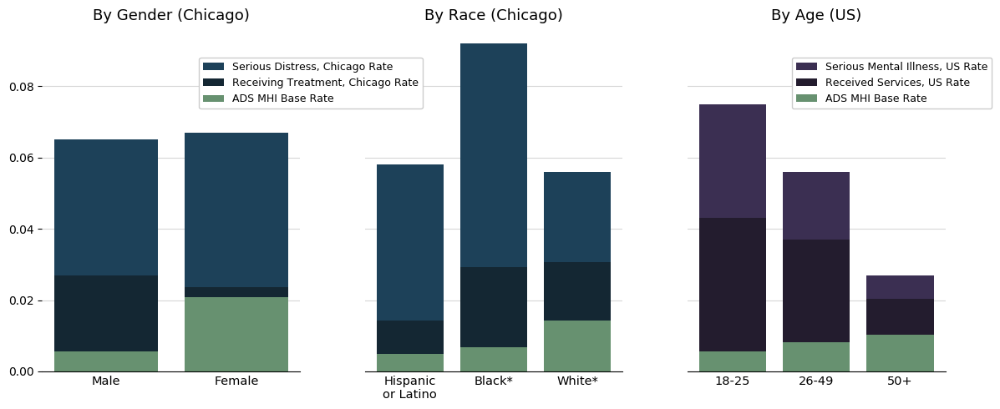

In [966]:
'''
Mixed Plot
'''

fig, ax = plt.subplots(1, 3, figsize=(12, 5), dpi=100, sharey=True, sharex=False)



ax[0].bar([1, 2], gender_ill[gender_order], 
             label='Serious Distress, Chicago Rate', color=distress_color)

ax[0].bar([1, 2], (gender_ill*gender_help)[gender_order], 
             label='Treated Serious Distress, Chicago Rate', color=treat_color)

ax[0].bar([1, 2], gender_mhi[gender_order], 
             label = 'ADS MHI Base Rate', color=mhi_color)

ax[0].xaxis.set_ticks([1,2])
ax[0].set_xticklabels(labels = np.array(list(gender_dict.keys()))[gender_order])
ax[0].set_title('By Gender (Chicago)', fontsize=13)





ax[1].bar([1, 2, 3], race_ill[race_order_chi], 
             label='Serious Distress, Chicago Rate', color=distress_color)

ax[1].bar([1, 2, 3], (race_ill*race_help)[race_order_chi], 
             label='Treated Serious Distress, Chicago Rate', color=treat_color)

ax[1].bar([1, 2, 3,], race_mhi_chi[race_order_chi], 
             label = 'ADS MHI Base Rate', color=mhi_color)

ax[1].xaxis.set_ticks([1,2,3])
ax[1].set_xticklabels(labels = race_labels_chi[race_order_chi], ha='center')
ax[1].set_title('By Race (Chicago)', fontsize=13)




ax[2].bar([1, 2, 3], age_smi, 
             label='Serious Mental Illness, US Rate', color=smi_color)

ax[2].bar([1, 2, 3], age_smi*age_smi_serv, 
             label='Received Services, US Rate', color=smi_serv_color)


ax[2].bar([1, 2, 3], age_mhi_us, 
             label = 'ADS MHI Base Rate', color=mhi_color)

ax[2].xaxis.set_ticks([1, 2, 3])
ax[2].set_xticklabels(labels = ['18-25', '26-49', '50+'])
ax[2].legend(loc='upper right', framealpha=1, bbox_to_anchor=(1.2, 0.927), fontsize=9)
ax[2].set_title('By Age (US)', fontsize=13)

for i in range(3):
        ax[i].set_axisbelow(True)
        ax[i].spines['right'].set_visible(False)
        ax[i].spines['left'].set_visible(False)
        ax[i].spines['top'].set_visible(False)
        ax[i].tick_params(labelsize=10.5, axis='x', which='both', length=0)
        if i>0:
            ax[i].tick_params(axis='y', which='both', length=0)
        ax[i].grid(which='both', axis='y', alpha=0.5)
            

fig.legend(labels = ['Serious Distress, Chicago Rate', 
                     'Receiving Treatment, Chicago Rate', 
                    'ADS MHI Base Rate'
                     ], 
           loc='upper center', framealpha=1, bbox_to_anchor=(0.31, 0.855), fontsize=9)


fig.tight_layout() 
plt.subplots_adjust(wspace=.25)  

plt.show()


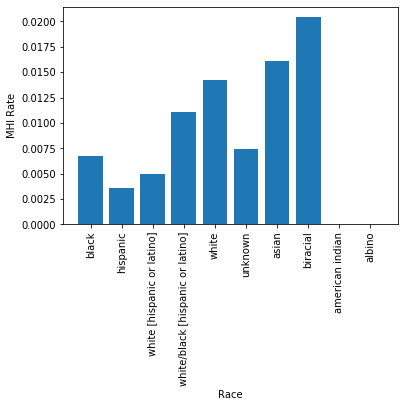

In [46]:
''' 
Data Analysis:
Looking at MHI Base Rates
Across Race
'''

races = ['black', 'hispanic', 'white [hispanic or latino]', 
         'white/black [hispanic or latino]', 'white', 'unknown', 'asian', 
         'biracial', 'american indian', 'albino']

dummy_encoded_races = ['race_' + x for x in races]

race_portions=[]
for i in dummy_encoded_races:
    race_portions.append(get_portion_true(total_df[total_df[i] == 1]))

plt.bar(races, race_portions)
plt.ylabel('MHI Rate')
plt.xlabel('Race')
plt.xticks(races, rotation='vertical')
plt.show()

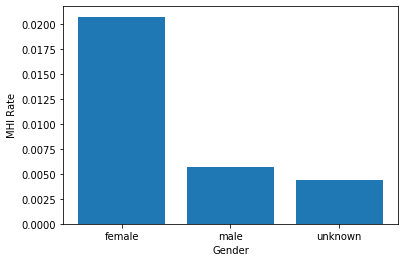

In [47]:
''' 
Data Analysis:
Looking at MHI Base Rates
Across Gender
'''

female = get_portion_true(total_df[total_df['gender_female'] == 1])
male = get_portion_true(total_df[total_df['gender_male'] == 1])
unknown = get_portion_true(total_df[total_df['gender_unknown'] == 1])

gender_portions=[female, male, unknown]
         
plt.bar(['female','male', 'unknown'], gender_portions )
plt.ylabel('MHI Rate')
plt.xlabel('Gender')
plt.show()

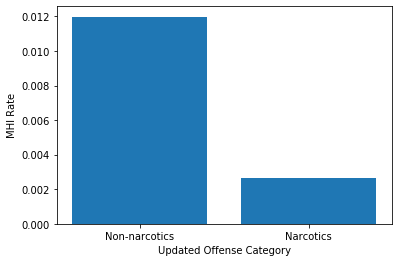

In [48]:
''' 
Data Analysis:
Looking at MHI Base Rates
For narcotics vs. non-narcotics cases

using updated_offense_category_narcotics feature
'''

narcotics0 = get_portion_true(total_df[total_df['updated_offense_category_narcotics'] == 0])
narcotics1 = get_portion_true(total_df[total_df['updated_offense_category_narcotics'] == 1])

portions=[narcotics0, narcotics1]
         
plt.bar(['Non-narcotics','Narcotics'], portions )
plt.ylabel('MHI Rate')
plt.xlabel('Updated Offense Category')
plt.show()

In [49]:
''' 
Data Analysis:
Looking at MHI Base Rates
Across Train/Validation/Test

Calls get_train_val_test from Final_Data_Prep notebook
Train/val/test split will be identical to split used for modelling
Because splitting function strictly time-based, no randomness
'''

from Final_Data_Prep import get_train_val_test
X_train, X_val, X_test, y_train, y_val, y_test = get_train_val_test (total_df, 0.7, 0.15, 0.15)
  
training_df = X_train.join(y_train)
val_df = X_val.join(y_val)
train_and_val_df = pd.concat([training_df, val_df], verify_integrity=True)
test_df = X_test.join(y_test)

print ("Training base rate: ", get_portion_true(training_df))
print ("Validation base rate: ", get_portion_true(val_df))
print ("Training+Validation base rate: ", get_portion_true(train_and_val_df))
print ("Test base rate: ", get_portion_true(test_df))

Training base rate:  0.007684097130940968
Validation base rate:  0.009155059496356425
Training+Validation base rate:  0.007943678020591706
Test base rate:  0.0059958951179577055


# Section 7: Fairness Metrics

In [905]:
# read in fresh copy of df
df = pd.read_pickle('total_df.pckl.gz', compression = 'gzip')

In [906]:
'''
Data Prep (consistent with ADS as seen in Final_Gradient_Boosting_Model.ipynb)

Performing prep on total_df (here called df, not decoded_df as above in LIME)
'''

#put earliest 85% of cases into training df, latest 15% of cases into test df
training, test = get_train_test(df, train_size=0.85, test_size=0.15)

# passing 50 to downsample function means training set will have 50% positive cases
training = downsample(training, 50)

X_train = training.drop('MHI', axis=1)
y_train = training['MHI']

X_test = test.drop('MHI', axis=1)
y_test = test['MHI']

In [78]:
# Train model on total_df, to recreate original classifier
clf_total = GradientBoostingClassifier(random_state=42, max_depth = 3, 
                                       min_samples_leaf = 10, learning_rate=.01, 
                                       n_estimators=1000)
clf_total.fit(X_train, y_train)

# Get predictions with original classifier
y_pred = clf_total.predict(X_test)

In [79]:
# set classifier list:
list_clf = [clf_total, clf_protected, clf_proxies]

# get number of classifiers
num_clf = len(list_clf)

# make stacked array of predictions on test set
preds_test = np.array([y_pred, y_pred_sensitive, y_pred_proxies])

# set X and y for full dataset
y_all = df['MHI'].copy()
X_all = df.drop(columns=['received_date', 'MHI'], inplace=False)

# set X for full dataset with sensitive features removed
X_all_sensitive = total_df_reduced_sensitive.drop(columns=['received_date', 'MHI'], inplace=False)

# set X for full dataset with proxy features removed
X_all_proxies = total_df_reduced_proxies.drop(columns=['received_date', 'MHI'], inplace=False)

X_all_list = [X_all, X_all_sensitive, X_all_proxies]

# initialize 2-d predictions arrays to 0
preds_all = np.zeros([num_clf, len(y_all)])

# get predictions on whole dataset for each classifier
for i, clf in enumerate(list_clf):

    # get predictions on entire dataset
    preds_all[i] = clf.predict(X_all_list[i])

In [80]:
def di_actual_and_pred(X, y_true, y_pred, col, priv_class):
    '''
    Calculate disparate impact in actual data and in classifier predictions
    DI = Pr(MHI==1|non-privileged class) / Pr(MHI==1| privileged class)
       = (# positive outcomes in the non-privileged class / # non-privileged)
           / (# positive outcomes in the privileged class / # privileged)

    X: features
    y_true: actual labels
    y_pred: 2-d array of labels predicted by different classifiers
    col: category (e.g. race, gender)
    priv_class: privileged class (e.g. white, male)
    '''
    
    # get number of classifiers
    num_clf = y_pred.shape[0]

    # set privileged column
    priv_col = col+'_'+priv_class

    # get number of privileged
    priv = X[X[priv_col]==1]
    num_priv = len(priv)

    # get number of privileged with actual positive
    ind_priv = priv.index
    y_priv = y_true.loc[ind_priv]
    true_num_pos_priv = y_priv.sum()

    # get number of non-privileged
    nonpriv = X[X[priv_col]==0]
    num_nonpriv = len(nonpriv)

    # get number of non-privileged with actual positive
    ind_nonpriv = nonpriv.index
    y_nonpriv = y_true.loc[ind_nonpriv]
    true_num_pos_nonpriv = y_nonpriv.sum()
    
    # get ilocs for actual positives in each class
    priv_ilocs = y_true.index.get_indexer_for((ind_priv))
    nonpriv_ilocs = y_true.index.get_indexer_for((ind_nonpriv))

    # get DI in original data
    DI_original = (true_num_pos_nonpriv / num_nonpriv) / (true_num_pos_priv / num_priv)
    print('Disparate impact on {} in original data: {}'.format(col, round(DI_original, 4)))
    
    # initialize DI_pred to array of 1s
    DI_pred = np.ones([num_clf])
    
    # calculate DI in predictions for each classifier
    for i in range(num_clf):
        
        # get number of privileged with positive prediction
        pred_num_pos_priv = y_pred[i][priv_ilocs].sum()

        # get number of non-privileged with positive prediction
        pred_num_pos_nonpriv = y_pred[i][nonpriv_ilocs].sum()

        # get DI in predictions
        DI_pred[i] = (pred_num_pos_nonpriv / num_nonpriv) / (pred_num_pos_priv / num_priv)
        print('Disparate impact on {} in classifier {} predictions: {}'.format(col, i+1, round(DI_pred[i], 4)))
    
    return DI_original, DI_pred

In [81]:
# get DI measures

print('Test Set')
di_race_og_test, di_race_pred_test = di_actual_and_pred(X_test, y_test, preds_test, 'race', 'white')
di_gender_og_test, di_gender_pred_test = di_actual_and_pred(X_test, y_test, preds_test, 'gender', 'male')

print('\nEntire Dataset')
di_race_og_all, di_race_pred_all = di_actual_and_pred(X_all, y_all, preds_all, 'race', 'white')
di_gender_og_all, di_gender_pred_all = di_actual_and_pred(X_all, y_all, preds_all, 'gender', 'male')

Test Set
Disparate impact on race in original data: 0.5719
Disparate impact on race in classifier 1 predictions: 0.5192
Disparate impact on race in classifier 2 predictions: 0.7482
Disparate impact on race in classifier 3 predictions: 0.8111
Disparate impact on gender in original data: 2.4247
Disparate impact on gender in classifier 1 predictions: 3.2531
Disparate impact on gender in classifier 2 predictions: 1.3417
Disparate impact on gender in classifier 3 predictions: 1.304

Entire Dataset
Disparate impact on race in original data: 0.4569
Disparate impact on race in classifier 1 predictions: 0.5289
Disparate impact on race in classifier 2 predictions: 0.7365
Disparate impact on race in classifier 3 predictions: 0.8096
Disparate impact on gender in original data: 3.5604
Disparate impact on gender in classifier 1 predictions: 3.1462
Disparate impact on gender in classifier 2 predictions: 1.5099
Disparate impact on gender in classifier 3 predictions: 1.4475


In [786]:
# put DI measures into dataframe

multi_index = pd.MultiIndex.from_product([['Test Set', 'All Data'],
                                          ['Actual',
                                           'Original Predictions',
                                           'Predictions without Sensitive Features',
                                           'Predictions without Proxy Features']])

race_list = [di_race_og_test, di_race_pred_test[0], 
             di_race_pred_test[1], di_race_pred_test[2], 
             di_race_og_all, di_race_pred_all[0], 
             di_race_pred_all[1], di_race_pred_all[2]]

gender_list = [di_gender_og_test, di_gender_pred_test[0], 
               di_gender_pred_test[1], di_gender_pred_test[2],
               di_gender_og_all, di_gender_pred_all[0], 
               di_gender_pred_all[1], di_gender_pred_all[2]]


di_df = pd.DataFrame(data={'Race':[round(x, 4) for x in race_list], 
                           'Gender':[round(x, 4) for x in gender_list]}, 
                     index=multi_index)

di_df

Race  Gender
Test Set Actual                                  0.5719  2.4247
         Original Predictions                    0.5192  3.2531
         Predictions without Sensitive Features  0.7482  1.3417
         Predictions without Proxy Features      0.8111  1.3040
All Data Actual                                  0.4569  3.5604
         Original Predictions                    0.5289  3.1462
         Predictions without Sensitive Features  0.7365  1.5099
         Predictions without Proxy Features      0.8096  1.4475

In [787]:
# melt df to prepare for catplot
di_melt = di_df.copy()
di_melt['Dataset'] = di_melt.index.map(lambda x: str(x)[1:-1].replace("\'", ""))
di_melt = di_melt.melt(id_vars=['Dataset'], 
                  value_vars=['Race', 'Gender'])

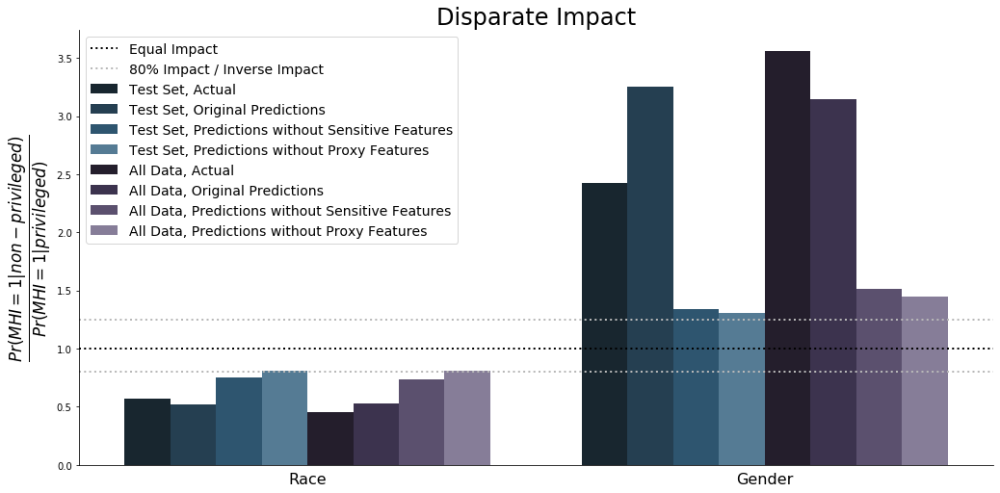

In [957]:
'''
Disparate Impact Plot
'''

# Create an array with the colors for plot
colors = [treat_color, distress_color, '#23577a', '#4a7d9e', 
          smi_serv_color, smi_color, ami_serv_color, ami_color]


# plot DI
di_plot = sns.catplot(data=di_melt, 
                          x='variable', y='value', hue='Dataset', palette=sns.color_palette(colors),
                          kind='bar', aspect=2, height=7, legend_out=False)

# plot lines to show equal impact / 80% impact
plt.axhline(1, color='black', linestyle='dotted', linewidth=2, label='Equal Impact')
plt.axhline(0.8, color='#b8b8b8', linestyle='dotted', linewidth=2, label='80% Impact / Inverse Impact')
plt.axhline((1/0.8), color='#b8b8b8', linestyle='dotted', linewidth=2)

plt.tick_params(axis='x', which='both',bottom=False, top=False)
di_plot.axes[0][0].set_xlabel('')
di_plot.axes[0][0].set_xticklabels(['Race', 'Gender'], fontsize=16)
di_plot.axes[0][0].set_ylabel(r'$\frac{Pr(MHI=1|non-privileged)}{Pr(MHI=1| privileged)}$', 
                              fontsize=24)

plt.legend(fontsize=14)
plt.title('Disparate Impact', fontsize=24)
plt.show()

In [967]:
# group race designations

race_dict_with_unknown = {'Hispanic or Latino': ['race_hispanic', 
                                    'race_white [hispanic or latino]', 
                                    'race_white/black [hispanic or latino]'], 
                          'Black*': ['race_black'],
                          'White*': ['race_white'], 
                          'Asian*': ['race_asian'], 
                          'American Indian*': ['race_american indian'], 
                          'Two or More*': ['race_biracial'], 
                          'Unknown': ['race_unknown', 'race_albino']}

X_test_grouped = X_test.copy()

grouped_cols = []

for key, col_list in race_dict_with_unknown.items():
    # initialize grouped column to 0
    X_test_grouped['race (grouped)_{}'.format(key)]=0
    
    # get all indices for this group
    index_groups = [list(X_test_grouped[X_test_grouped[x]==1].index) \
                            for x in col_list]
    mask = list(itertools.chain(*index_groups))
    
    # set race_grouped column to 1 for those indices
    X_test_grouped.loc[mask, 'race (grouped)_{}'.format(key)]=1
    
    # add col to list of grouped race cols
    grouped_cols.append('race (grouped)_{}'.format(key))

In [974]:
def plain_group(x):
    '''
    Return title-case group name, 
    without category or underscore
    '''
    split = x.split('_', 1)
    if len(split)==1:
        return split[0].title()
    if len(split)==2:
        if ' or ' not in split[1]:
            return split[1].title()
        return ' or '.join([x.title() for x in split[1].split(' or ')])
    return 


def split_groups(x, cat):
    '''
    For intersectional analysis.
    Return title-case group name, 
    without category or underscore
    '''

    if x=='Overall':
        return 'All'
    
    halves = x.split(', and ', 1)
    if len(halves)<2:
        all_blanks = halves[0].split(', All ')
        if all_blanks[1][:-1]==cat:
            return 'All'
        equals = all_blanks[0].split(' = ', 1)
        if equals[0]==cat:
            return equals[1].title()
        print('Error! Got to the end of the all blanks path.')
    else:
        for half in halves:
            equals = half.split(' = ', 1)
            if equals[0]==cat:
                return equals[1].title()
        print('Error! Got to the end of the double path.')
                
    print('Error! Got to the end of the function.')
    return 


def get_stats(X_sub, col):
    
    # get target variable subset
    ind = X_sub.index
    y_sub = y_test[ind]
    
    # for subset, get predictions and probabilities for positive class 
    pred_sub = clf_total.predict(X_sub.drop(columns=grouped_cols))
    pred_proba_sub = clf_total.predict_proba(X_sub.drop(columns=grouped_cols))
    
    # get FPR, TPR
    fpr, tpr, thresholds = sklearn.metrics.roc_curve(y_sub, pred_proba_sub[:,1])
    
    # get confusion matrix
    confmat_sub = sklearn.metrics.confusion_matrix(y_sub, pred_sub, labels=[1,0])
    tp = confmat_sub[0,0] # number of true positives
    fp = confmat_sub[1,0] # number of false positives
    fn = confmat_sub[0,1] # number of false negatives
    tn = confmat_sub[1,1] # number of true negatives
    
    # create dataframe with stats
    stats = pd.DataFrame(data={col:[len(pred_sub), # group size
                                    round(fp/(fp+tn), 4), # fpr
                                    round(tp/(tp+fn), 4), # recall
                                    round(sklearn.metrics.auc(fpr, tpr), 4), # auc 
                                    round((tp+tn)/len(pred_sub), 4), # accuracy
                                   ]}, 
                 index=['Test Set Group Size (N)',
                        'FPR', 'Recall', 'AUC', 'Accuracy'])
    # transpose df
    stats = stats.T
    stats['Test Set Group Size (N)'] = stats['Test Set Group Size (N)'].astype(int)
    
    # display dataframe with stats
    display(stats)
    
    #plot confusion matrix
    sklearn.metrics.plot_confusion_matrix(clf_total, X_sub.drop(columns=grouped_cols), y_sub, labels=[1,0])
    plt.show()
    
    print('\n')
    
    # return dataframe with stats
    return stats
    
    
def subgroup_stats(category1, category2=None, age_bins=None):
    '''
    Takes in 1 or 2 pre-OHE column names (e.g., 'race' and 'gender').
    If 2 categories given, produces intersectional statistics.
    
    Note: Does not support intersectional analysis with age.
    '''
    # get list of OHE columns for category 1
    if category1 != 'age_at_incident':
        cols_1 = [x for x in X_test_grouped.columns if x.startswith(category1+'_')]
    
    # intersectional analysis
    if category2 !=None:
        assert category1!='age_at_incident' and category2!='age_at_incident', \
                                         'Intersectional analysis not supported for age'
        
        # Take only the 1st word of each category
        cat1 = category1.split(' ')[0].title()
        cat2 = category2.split(' ')[0].title()
        
        # get overall stats
        total_stats = get_stats(X_test_grouped, 'Overall')
        
        # get list of OHE columns for category 1
        cols_2 = [x for x in X_test_grouped.columns if x.startswith(category2+'_')]
        
        # Get overall stats for each value of category 2
        for y in cols_2:
            X_sub = X_test_grouped[X_test_grouped[y]==1]
            if len(X_sub)==0:
                print(y,'\n\t No members of this subgroup present in the test set. \n')
            else:
                sub_stats = get_stats(X_sub, '{} = {}, All {}s'.format(cat2,
                                                                       plain_group(y),
                                                                       cat1))
                total_stats = pd.concat([total_stats, sub_stats])
        
        for x in cols_1:
            # for each value of category 1, create subset
            X_sub = X_test_grouped[X_test_grouped[x]==1]
            
            # continue if subset is empty
            if len(X_sub)==0:
                print(x,'\n\t No members of this subgroup present in the test set. \n')
                continue
            
            # process subset if not empty
            else:
                # Get overall stats for each value of category 1
                sub_stats = get_stats(X_sub, '{} = {}, All {}s'.format(cat1,
                                                                       plain_group(x),
                                                                       cat2))
                total_stats = pd.concat([total_stats, sub_stats])
                
                for y in cols_2:
                    # create sub-subset for each value of category 2
                    X_sub = X_test_grouped[X_test_grouped[x]==1]
                    X_sub = X_sub[X_sub[y]==1]
                    if len(X_sub)==0:
                        print(x+' and '+y,
                              '\n\t No members of this subgroup present in the test set. \n')
                    else:
                        # get stats if sub-subset not empty
                        sub_stats = get_stats(X_sub, '{} = {}, and {} = {}'.format(cat1, 
                                                                                  plain_group(x), 
                                                                                  cat2,
                                                                                  plain_group(y)))
                        total_stats = pd.concat([total_stats, sub_stats])
                        
        # Create category columns with plain group names
        total_stats[cat1] = total_stats.index.to_series().apply(split_groups, args=(cat1,))
        total_stats[cat2] = total_stats.index.to_series().apply(split_groups, args=(cat2,))

        # Set category column to index
        total_stats.set_index([cat1, cat2], inplace=True, drop=True)
                        
    # single trait only
    else:
        total_stats = pd.DataFrame()
        if category1 != 'age_at_incident':
            for x in cols_1:
                # for each value of category 1, create subset
                X_sub = X_test_grouped[X_test_grouped[x]==1]
                if len(X_sub)==0:
                    print(x,'\n\t No members of this subgroup present in the test set. \n')
                else:
                    # get stats if subset not empty
                    sub_stats = get_stats(X_sub, plain_group(x))
                    total_stats = pd.concat([total_stats, sub_stats])
                    
             # Get capitalized 1st word of category (e.g. "Gender")
            cat = category1.split(' ')[0].title()

            # Create category column with plain group names
            total_stats[cat]=total_stats.index

            # Set category column to index
            total_stats.set_index(cat, inplace=True, drop=True)
            
            # sort by group size
            total_stats.sort_values(by='FPR', ascending=True, inplace=True)

        # special method for age
        else:
            # cut age into bins
            cut = pd.cut(X_test_grouped['age_at_incident'], 
                         bins=age_bins, 
                         labels=False, right=False, retbins=True)
            
            # save age_at_incident encoded by bin numbers
            age_binned = cut[0]
            
            # save bins
            bins = cut[1]
            
            for x in sorted(age_binned.unique()):
                # create subset for each bin
                this_bin = age_binned[age_binned==x].index
                X_sub = X_test_grouped.loc[this_bin]
                
                # create bin labels
                edges = '{}-{}'.format(int(bins[int(x)]), int(bins[int(x)+1]-1))
                if bins[int(x)] == bins[int(x)+1]-1:
                    # if bin contains only 1 age, change label to single number
                    edges = str(int(bins[int(x)]))
            
                if len(X_sub)==0:
                    if not np.isnan(x):
                        print(x,
                              '\n\t No members of this subgroup present in the test set. \n')
                else:
                    # get stats if subset not empty
                    sub_stats = get_stats(X_sub, edges)
                    total_stats = pd.concat([total_stats, sub_stats])
                    
            # Create category column with plain group names
            total_stats['Age']=total_stats.index

            # Set category column to index
            total_stats.set_index('Age', inplace=True, drop=True)
        
    display(total_stats)
    print('\n')
    
    return total_stats

In [969]:
# set non-sequential colors for gender and race palettes

nonseq_colors = ['dark sage', "mango", "faded red", 
                 'taupe', "dusty purple",
                 "nice blue", "peachy pink"]

def plot_stats(stat_df_full, age=False):
    
    stat_df = stat_df_full
    
    stat_df.rename(columns={'Recall':'Recall\n(1-FNR)'}, inplace=True)
    
    # drop rows with NaN
    stat_df.dropna(axis=0, inplace=True)
    
    cat = stat_df.index.name
    
    # Create column with category values and test set size
    stat_df[cat] = stat_df.index + ', N=' + \
                        stat_df['Test Set Group Size (N)'].astype(str)
    
    # Add line break for Hispanic/Latino
    stat_df[cat] = stat_df[cat].str.replace('Hispanic or Latino',
                                            'Hispanic or\nLatino')
    
    if age:
        # Set sequential palette
        palette=sns.cubehelix_palette(10, start=.6, rot=-.5, 
                                      dark=0.2, light=.85, reverse=True)
        
    else:
        # Set non-sequential palette
        palette=sns.xkcd_palette(nonseq_colors)

    # melt df to prepare for sns.catplot
    df_melt = stat_df.melt(id_vars=[cat], 
                  value_vars=['FPR', 'Recall\n(1-FNR)', 'AUC', 'Accuracy'])

    # plot metrics
    stat_plot = sns.catplot(data=df_melt, 
                              x='variable', y='value', hue=cat,
                              kind='bar', palette=palette,
                            aspect=1.75, height=5, legend_out=False)
    
    stat_plot.axes[0][0].set_xlabel('')
    stat_plot.axes[0][0].set_ylabel('')
    stat_plot.axes[0][0].tick_params(labelsize=12, axis='x', which='both', length=0)
    stat_plot.axes[0][0].legend(loc='upper left', title=r'$\bf{}$'.format(cat), 
                                title_fontsize=14, fontsize=11, frameon=False, framealpha=1)
    
    plt.show()
    
    return

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
17-25,12820,0.177,0.6429,0.8111,0.822


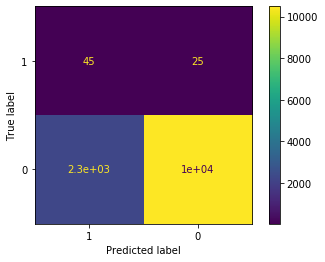

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
26-49,23417,0.253,0.8514,0.8609,0.7477


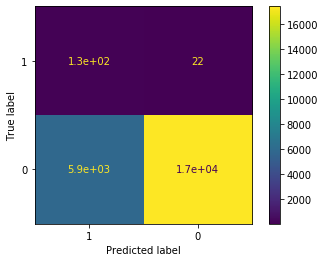

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
50-82,7126,0.2805,0.8333,0.8272,0.7202


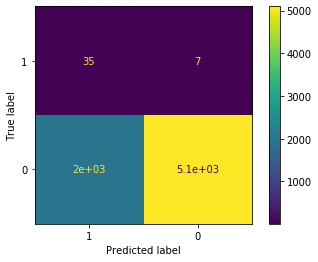

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Age,,,,,
17-25,12820,0.1770,0.6429,0.8111,0.8220
26-49,23417,0.2530,0.8514,0.8609,0.7477
50-82,7126,0.2805,0.8333,0.8272,0.7202


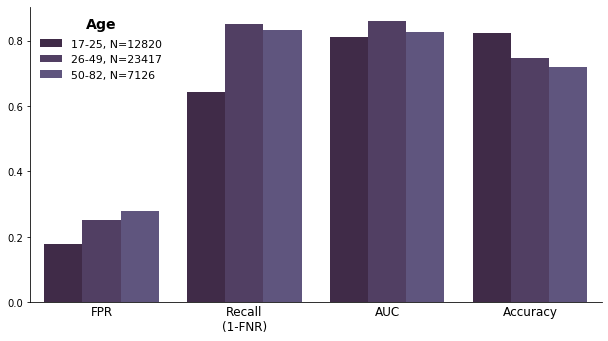

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
17-29,19733,0.1972,0.7054,0.8182,0.8023


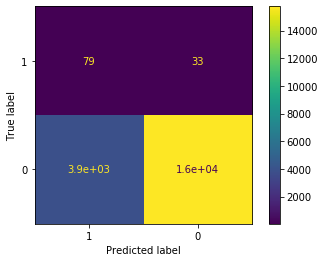

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
30-44,13269,0.2477,0.8452,0.8644,0.7529


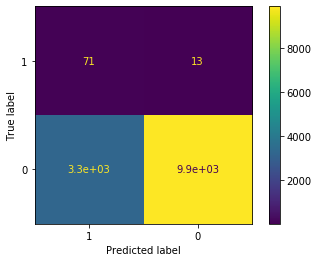

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
45-64,9768,0.2945,0.8871,0.8662,0.7067


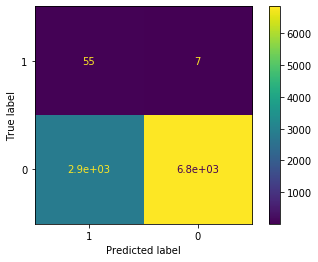

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
65-82,593,0.2335,0.5,0.5711,0.7656


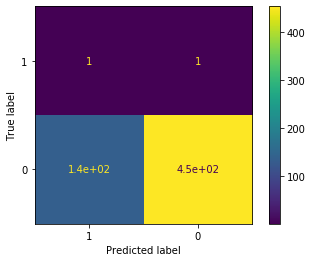

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Age,,,,,
17-29,19733,0.1972,0.7054,0.8182,0.8023
30-44,13269,0.2477,0.8452,0.8644,0.7529
45-64,9768,0.2945,0.8871,0.8662,0.7067
65-82,593,0.2335,0.5000,0.5711,0.7656


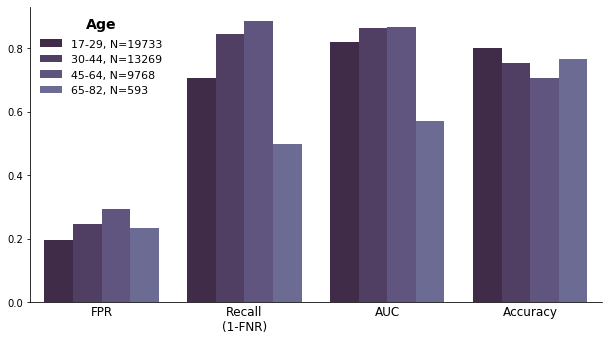

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
17-19,2623,0.1948,0.6,0.8105,0.8048


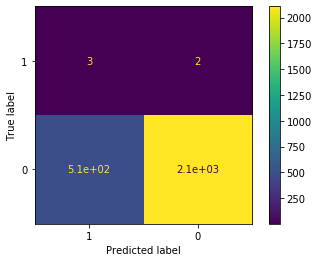

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
20-24,8430,0.169,0.6226,0.8039,0.8297


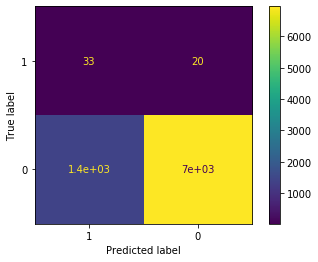

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
25-29,8680,0.2252,0.7963,0.836,0.7749


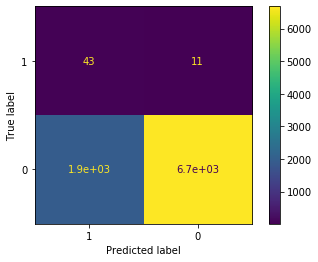

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
30-39,10114,0.2408,0.8689,0.8644,0.7598


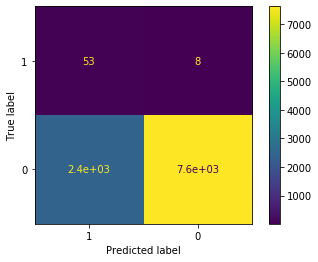

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
40-49,6390,0.2922,0.8667,0.8841,0.7089


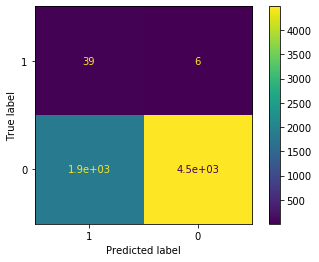

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
50-82,7126,0.2805,0.8333,0.8272,0.7202


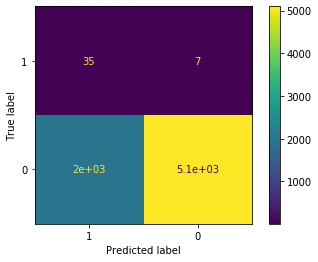

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Age,,,,,
17-19,2623,0.1948,0.6000,0.8105,0.8048
20-24,8430,0.1690,0.6226,0.8039,0.8297
25-29,8680,0.2252,0.7963,0.8360,0.7749
30-39,10114,0.2408,0.8689,0.8644,0.7598
40-49,6390,0.2922,0.8667,0.8841,0.7089
50-82,7126,0.2805,0.8333,0.8272,0.7202


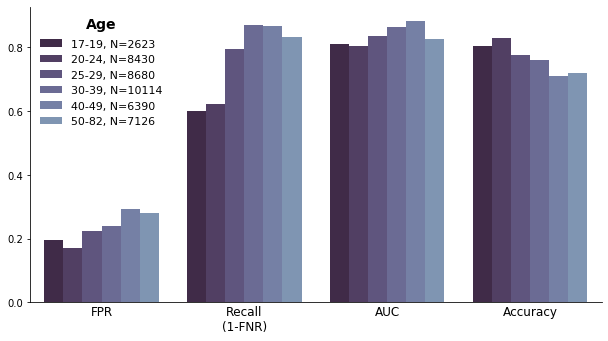

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
17-19,2623,0.1948,0.6,0.8105,0.8048


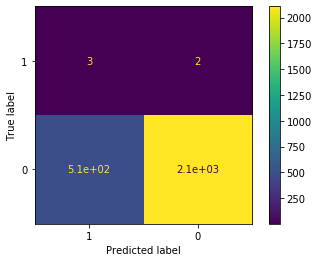

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
20-22,5022,0.1771,0.6585,0.8178,0.8216


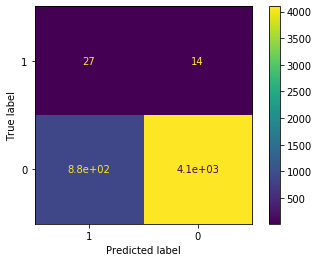

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
23-26,6977,0.1778,0.7297,0.8136,0.8217


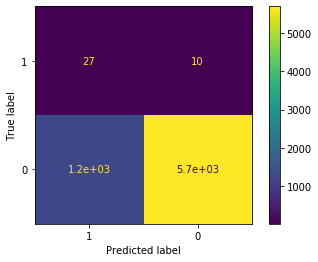

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
27-29,5111,0.2446,0.7586,0.8355,0.7554


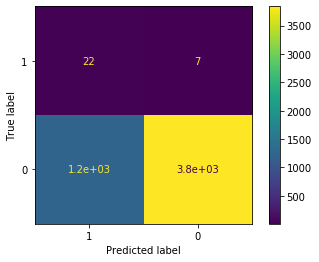

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
30-34,5800,0.2353,0.9024,0.8843,0.7657


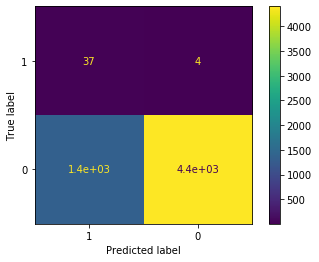

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
35-39,4314,0.2483,0.8,0.8239,0.752


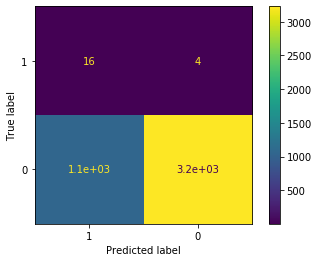

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
40-49,6390,0.2922,0.8667,0.8841,0.7089


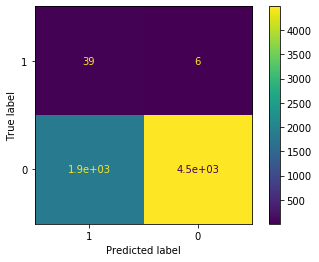

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
50-59,5296,0.2979,0.8286,0.829,0.703


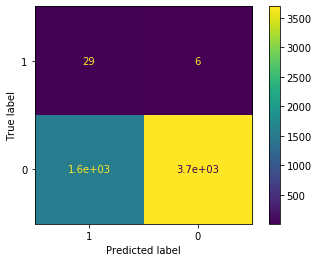

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
60-82,1830,0.2304,0.8571,0.8102,0.7699


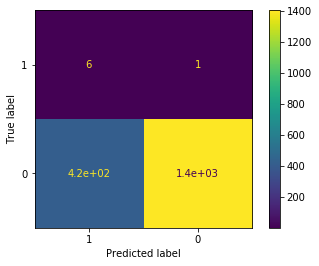

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Age,,,,,
17-19,2623,0.1948,0.6000,0.8105,0.8048
20-22,5022,0.1771,0.6585,0.8178,0.8216
23-26,6977,0.1778,0.7297,0.8136,0.8217
27-29,5111,0.2446,0.7586,0.8355,0.7554
30-34,5800,0.2353,0.9024,0.8843,0.7657
35-39,4314,0.2483,0.8000,0.8239,0.7520
40-49,6390,0.2922,0.8667,0.8841,0.7089
50-59,5296,0.2979,0.8286,0.8290,0.7030
60-82,1830,0.2304,0.8571,0.8102,0.7699


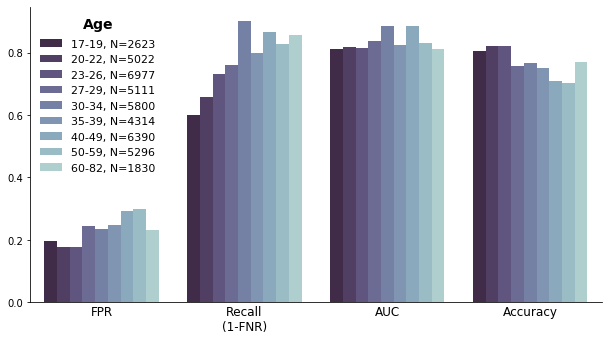

In [970]:
age_min = X_test_grouped['age_at_incident'].min()
age_max = X_test_grouped['age_at_incident'].max()

# US age divisions
age_stats_1 = subgroup_stats('age_at_incident', age_bins=[age_min, 26, 50, age_max+1])
plot_stats(age_stats_1, age=True)

# Chicago age divisions
age_stats_2 = subgroup_stats('age_at_incident', age_bins=[age_min, 30, 45, 65, age_max+1])
plot_stats(age_stats_2, age=True)

# Medium number of bins
age_stats_3 = subgroup_stats('age_at_incident', age_bins=[age_min, 20, 25, 30, 40, 50, age_max+1])
plot_stats(age_stats_3, age=True)

# Large number of bins
age_stats_4 = subgroup_stats('age_at_incident', age_bins=[age_min, 20, 23, 27, 30, 35, 40, 50, 60, age_max+1])
plot_stats(age_stats_4, age=True)


,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Female,5582,0.6101,0.9296,0.8228,0.3968


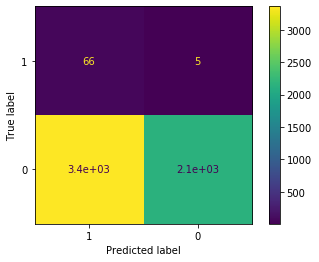

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Male,37546,0.1802,0.7407,0.8395,0.8194


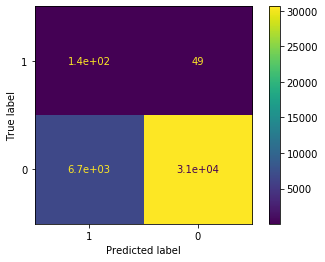

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Unknown,235,0.1532,NaN,NaN,0.8468


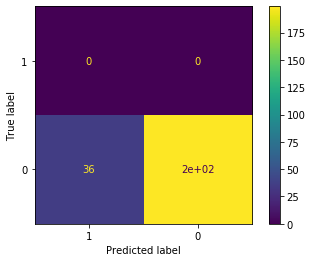

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Gender,,,,,
Unknown,235,0.1532,NaN,NaN,0.8468
Male,37546,0.1802,0.7407,0.8395,0.8194
Female,5582,0.6101,0.9296,0.8228,0.3968


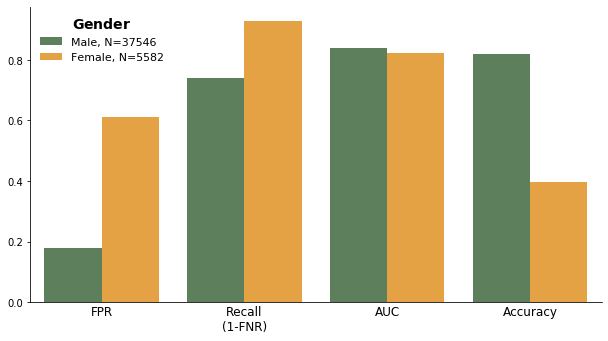

In [971]:
gender_stats = subgroup_stats('gender')
plot_stats(gender_stats)

race_albino 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
American Indian,7,0.7143,NaN,NaN,0.2857


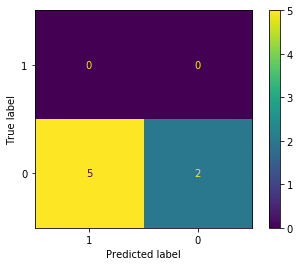

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Asian,224,0.3122,1.0,0.8612,0.692


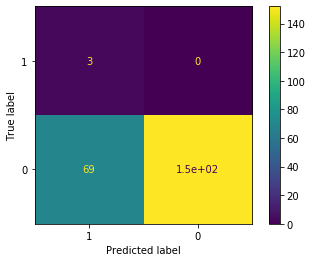

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Biracial,5,0.2,NaN,NaN,0.8


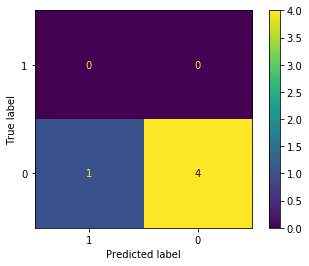

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Black,29269,0.2111,0.7738,0.8407,0.7889


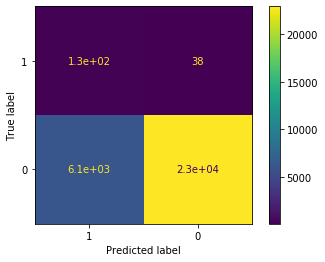

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Hispanic,446,0.1056,1.0,0.9933,0.8946


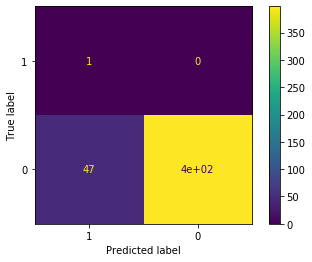

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Unknown,420,0.181,NaN,NaN,0.819


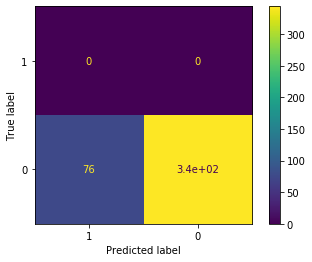

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
White,6000,0.4023,0.8947,0.8423,0.6005


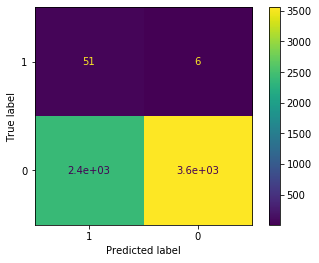

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
White [Hispanic or Latino],6751,0.2004,0.6552,0.7919,0.799


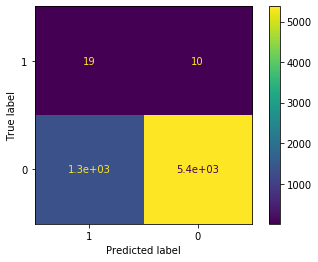

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
White/Black [Hispanic or Latino],241,0.2218,1.0,1.0,0.7801


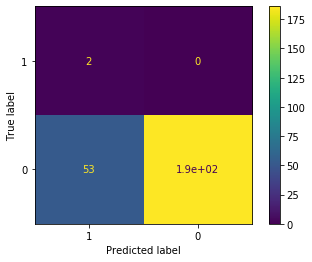

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Race,,,,,
Hispanic,446,0.1056,1.0000,0.9933,0.8946
Unknown,420,0.1810,NaN,NaN,0.8190
Biracial,5,0.2000,NaN,NaN,0.8000
White [Hispanic or Latino],6751,0.2004,0.6552,0.7919,0.7990
Black,29269,0.2111,0.7738,0.8407,0.7889
White/Black [Hispanic or Latino],241,0.2218,1.0000,1.0000,0.7801
Asian,224,0.3122,1.0000,0.8612,0.6920
White,6000,0.4023,0.8947,0.8423,0.6005
American Indian,7,0.7143,NaN,NaN,0.2857


,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Hispanic or Latino,7438,0.1954,0.6875,0.8128,0.8041


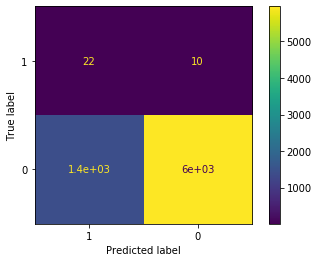

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Black*,29269,0.2111,0.7738,0.8407,0.7889


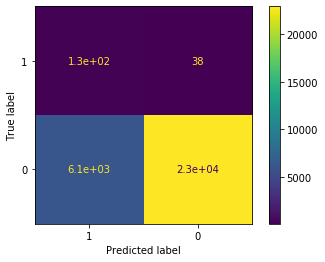

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
White*,6000,0.4023,0.8947,0.8423,0.6005


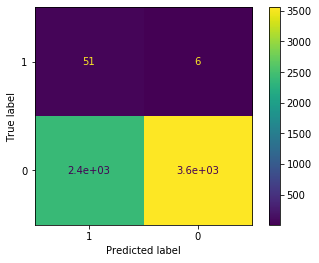

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Asian*,224,0.3122,1.0,0.8612,0.692


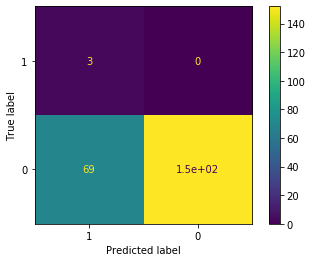

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
American Indian*,7,0.7143,NaN,NaN,0.2857


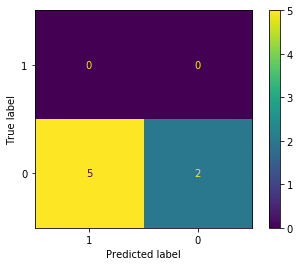

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Two or More*,5,0.2,NaN,NaN,0.8


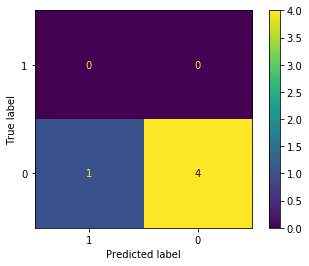

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Unknown,420,0.181,NaN,NaN,0.819


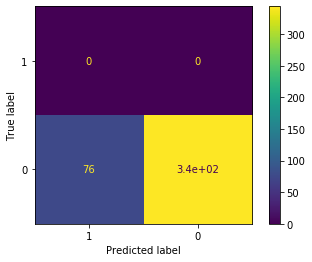

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Race,,,,,
Unknown,420,0.1810,NaN,NaN,0.8190
Hispanic or Latino,7438,0.1954,0.6875,0.8128,0.8041
Two or More*,5,0.2000,NaN,NaN,0.8000
Black*,29269,0.2111,0.7738,0.8407,0.7889
Asian*,224,0.3122,1.0000,0.8612,0.6920
White*,6000,0.4023,0.8947,0.8423,0.6005
American Indian*,7,0.7143,NaN,NaN,0.2857


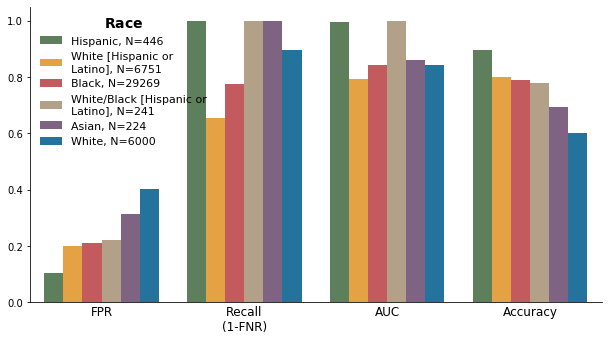

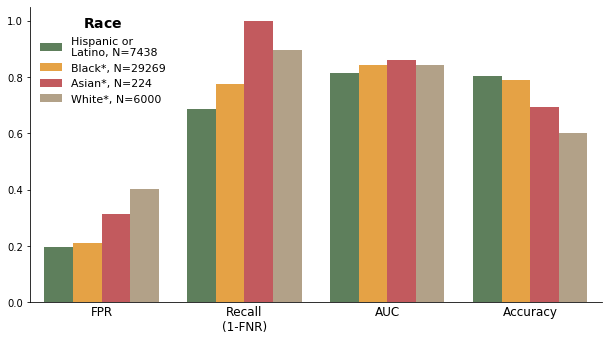

In [972]:
race_stats = subgroup_stats('race')
grouped_race_stats = subgroup_stats('race (grouped)')
plot_stats(race_stats)
plot_stats(grouped_race_stats)

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Overall,43363,0.235,0.7923,0.8411,0.7651


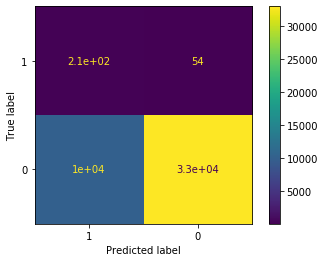

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Gender = Female, All Races",5582,0.6101,0.9296,0.8228,0.3968


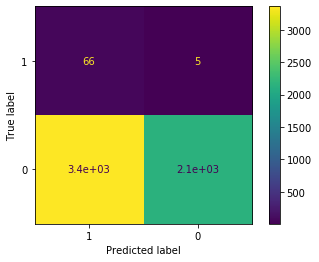

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Gender = Male, All Races",37546,0.1802,0.7407,0.8395,0.8194


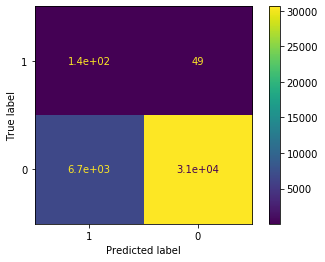

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Gender = Unknown, All Races",235,0.1532,NaN,NaN,0.8468


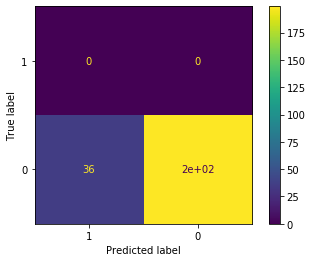



race_albino 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = American Indian, All Genders",7,0.7143,NaN,NaN,0.2857


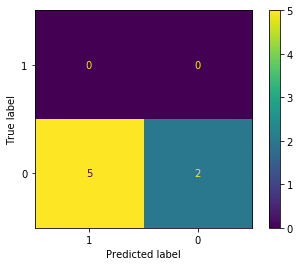

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = American Indian, and Gender = Female",3,1.0,NaN,NaN,0.0


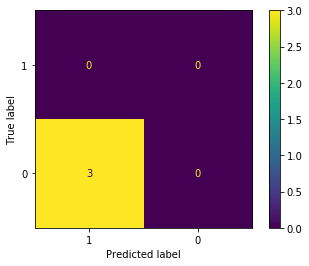

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = American Indian, and Gender = Male",4,0.5,NaN,NaN,0.5


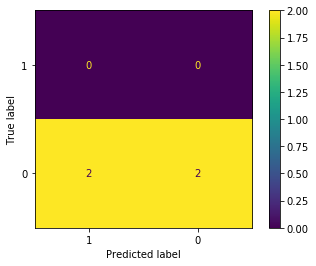



race_american indian and gender_unknown 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Asian, All Genders",224,0.3122,1.0,0.8612,0.692


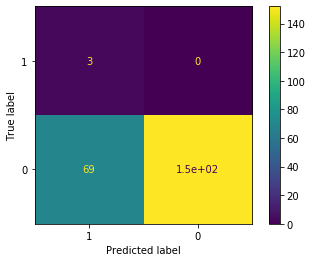

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Asian, and Gender = Female",39,0.6842,1.0,0.9474,0.3333


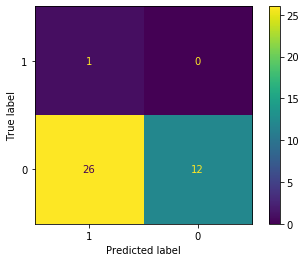

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Asian, and Gender = Male",185,0.235,1.0,0.8634,0.7676


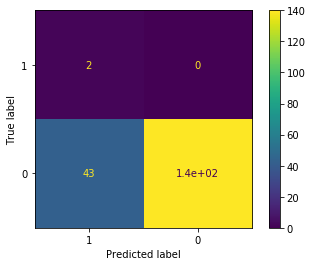



race_asian and gender_unknown 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Biracial, All Genders",5,0.2,NaN,NaN,0.8


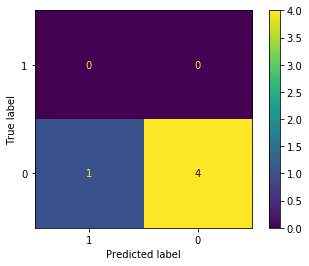



race_biracial and gender_female 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Biracial, and Gender = Male",5,0.2,NaN,NaN,0.8


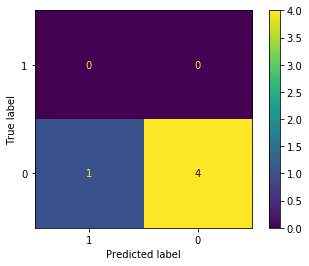



race_biracial and gender_unknown 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Black, All Genders",29269,0.2111,0.7738,0.8407,0.7889


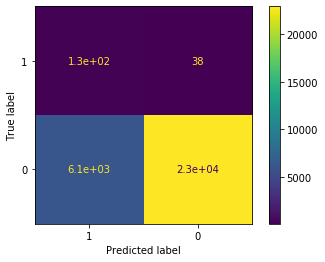

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Black, and Gender = Female",3424,0.6085,0.9574,0.8187,0.3992


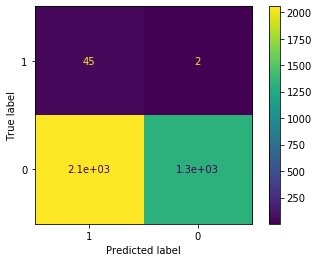

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Black, and Gender = Male",25824,0.159,0.7025,0.8359,0.8403


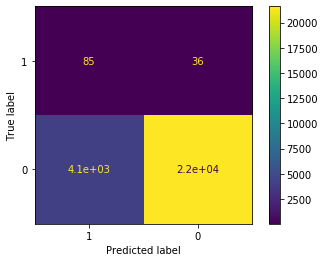

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Black, and Gender = Unknown",21,0.0,NaN,NaN,1.0


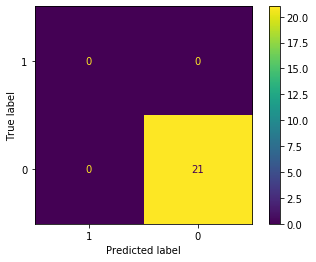

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Hispanic, All Genders",446,0.1056,1.0,0.9933,0.8946


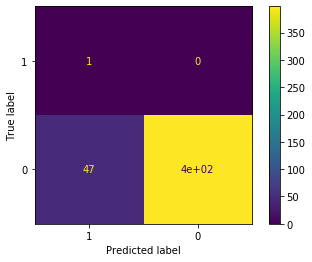

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Hispanic, and Gender = Female",45,0.4773,1.0,0.9318,0.5333


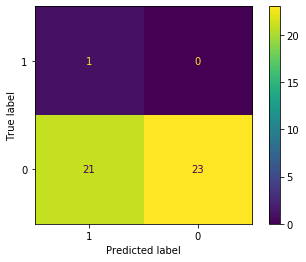

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Hispanic, and Gender = Male",401,0.0648,NaN,NaN,0.9352


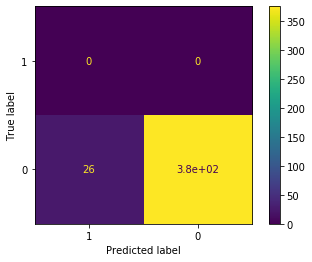



race_hispanic and gender_unknown 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Unknown, All Genders",420,0.181,NaN,NaN,0.819


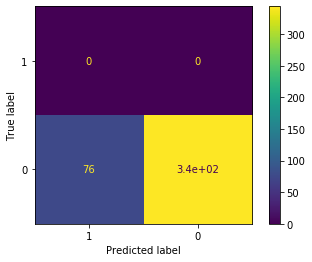

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Unknown, and Gender = Female",34,0.5294,NaN,NaN,0.4706


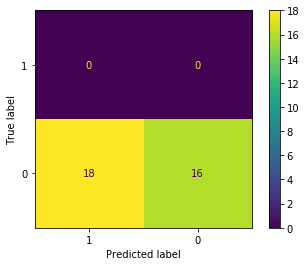

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Unknown, and Gender = Male",178,0.1236,NaN,NaN,0.8764


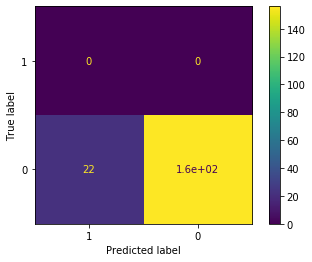

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Unknown, and Gender = Unknown",208,0.1731,NaN,NaN,0.8269


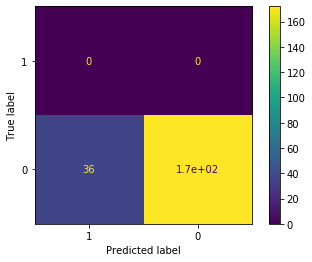

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White, All Genders",6000,0.4023,0.8947,0.8423,0.6005


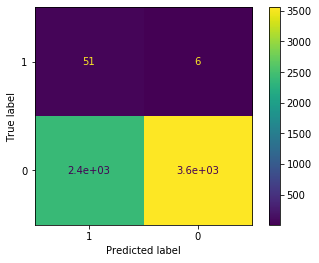

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White, and Gender = Female",1345,0.6404,0.9231,0.8544,0.3651


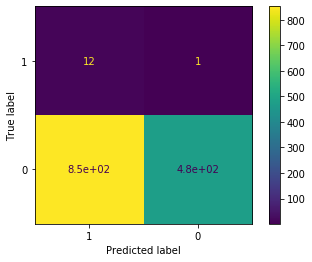

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White, and Gender = Male",4653,0.3337,0.8864,0.855,0.6684


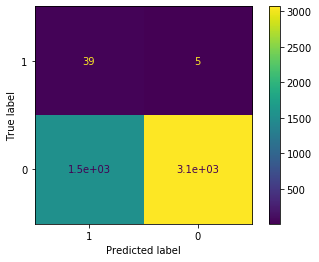

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White, and Gender = Unknown",2,0.0,NaN,NaN,1.0


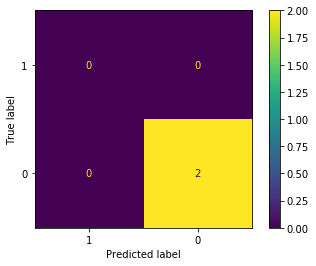

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White [Hispanic or Latino], All Genders",6751,0.2004,0.6552,0.7919,0.799


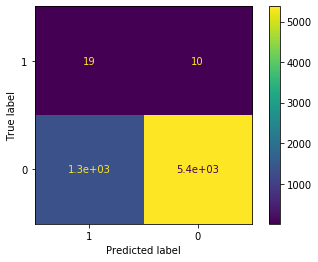

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White [Hispanic or Latino], and Gender = Female",664,0.5616,0.7143,0.7364,0.4413


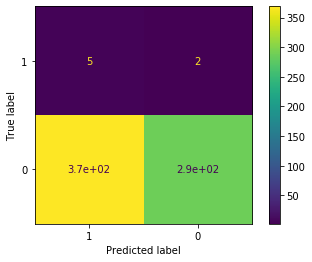

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White [Hispanic or Latino], and Gender = Male",6083,0.1614,0.6364,0.7814,0.8379


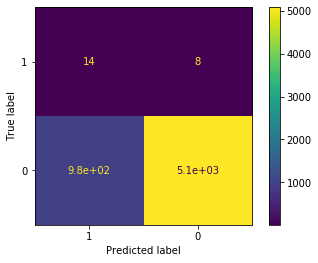

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White [Hispanic or Latino], and Gender = Unknown",4,0.0,NaN,NaN,1.0


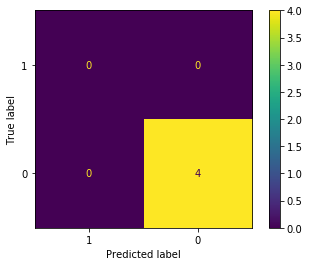

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White/Black [Hispanic or Latino], All Genders",241,0.2218,1.0,1.0,0.7801


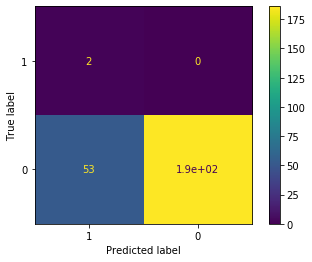

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White/Black [Hispanic or Latino], and Gender = Female",28,0.6538,1.0,1.0,0.3929


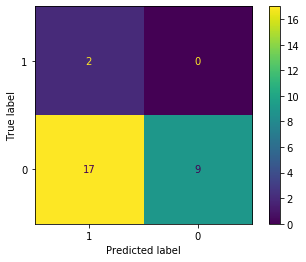

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White/Black [Hispanic or Latino], and Gender = Male",213,0.169,NaN,NaN,0.831


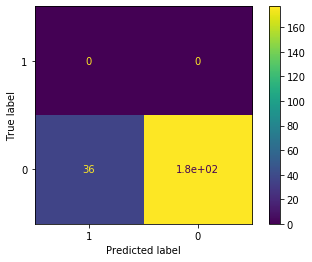



race_white/black [hispanic or latino] and gender_unknown 
	 No members of this subgroup present in the test set. 



Test Set Group Size (N)     FPR  \
Race                             Gender                                     
All                              All                        43363  0.2350   
                                 Female                      5582  0.6101   
                                 Male                       37546  0.1802   
                                 Unknown                      235  0.1532   
American Indian                  All                            7  0.7143   
                                 Female                         3  1.0000   
                                 Male                           4  0.5000   
Asian                            All                          224  0.3122   
                                 Female                        39  0.6842   
                                 Male                         185  0.2350   
Biracial                         All                            5  0.2000   
                                 Male                           5  0.2000   
Black                            All                        29269  0.2111   
                                 Female                      3424  0.6085   
                                 Male                       25824  0.1590   
                                 Unknown                       21  0.0000   
Hispanic                         All                          446  0.1056   
                                 Female                        45  0.4773   
                                 Male                         401  0.0648   
Unknown                          All                          420  0.1810   
                                 Female                        34  0.5294   
                                 Male                         178  0.1236   
                                 Unknown                      208  0.1731   
White                            All                         6000  0.4023   
                                 Female                      1345  0.6404   
                                 Male                        4653  0.3337   
                                 Unknown                        2  0.0000   
White [Hispanic Or Latino]       All                         6751  0.2004   
                                 Female                       664  0.5616   
                                 Male                        6083  0.1614   
                                 Unknown                        4  0.0000   
White/Black [Hispanic Or Latino] All                          241  0.2218   
                                 Female                        28  0.6538   
                                 Male                         213  0.1690   

                                          Recall     AUC  Accuracy  
Race                             Gender                             
All                              All      0.7923  0.8411    0.7651  
                                 Female   0.9296  0.8228    0.3968  
                                 Male     0.7407  0.8395    0.8194  
                                 Unknown     NaN     NaN    0.8468  
American Indian                  All         NaN     NaN    0.2857  
                                 Female      NaN     NaN    0.0000  
                                 Male        NaN     NaN    0.5000  
Asian                            All      1.0000  0.8612    0.6920  
                                 Female   1.0000  0.9474    0.3333  
                                 Male     1.0000  0.8634    0.7676  
Biracial                         All         NaN     NaN    0.8000  
                                 Male        NaN     NaN    0.8000  
Black                            All      0.7738  0.8407    0.7889  
                                 Female   0.9574  0.8187    0.3992  
                                 Male     0.7025  0.8359    0.8403  
                                 Unknown     NaN     NaN    1.0000  
Hispanic                   

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
Overall,43363,0.235,0.7923,0.8411,0.7651


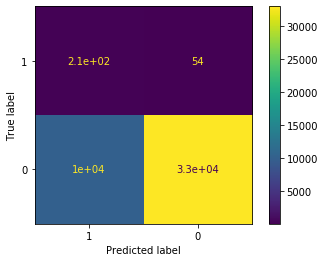

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Gender = Female, All Races",5582,0.6101,0.9296,0.8228,0.3968


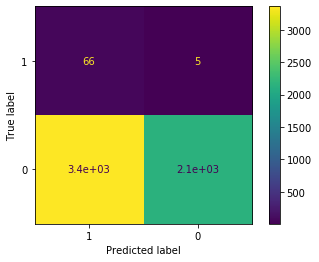

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Gender = Male, All Races",37546,0.1802,0.7407,0.8395,0.8194


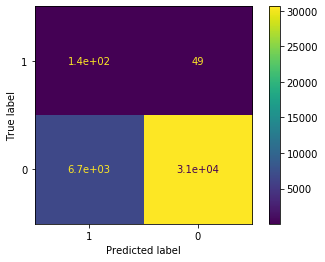

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Gender = Unknown, All Races",235,0.1532,NaN,NaN,0.8468


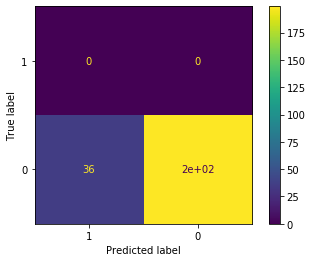

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Hispanic or Latino, All Genders",7438,0.1954,0.6875,0.8128,0.8041


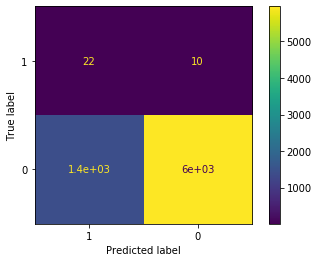

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Hispanic or Latino, and Gender = Female",737,0.5598,0.8,0.8079,0.445


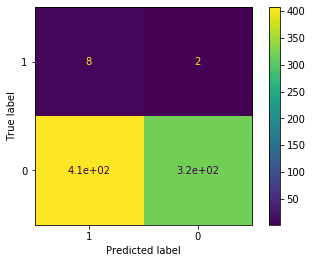

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Hispanic or Latino, and Gender = Male",6697,0.1558,0.6364,0.7837,0.8435


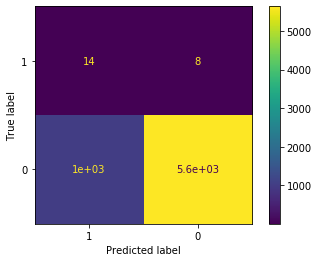

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Hispanic or Latino, and Gender = Unknown",4,0.0,NaN,NaN,1.0


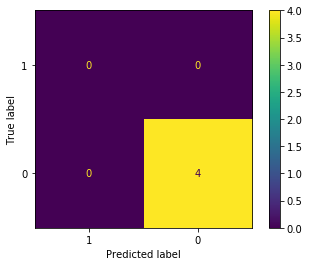

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Black*, All Genders",29269,0.2111,0.7738,0.8407,0.7889


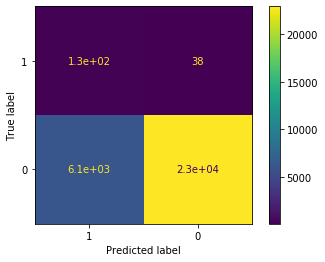

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Black*, and Gender = Female",3424,0.6085,0.9574,0.8187,0.3992


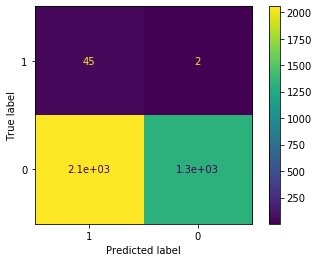

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Black*, and Gender = Male",25824,0.159,0.7025,0.8359,0.8403


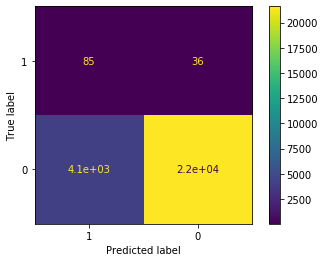

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Black*, and Gender = Unknown",21,0.0,NaN,NaN,1.0


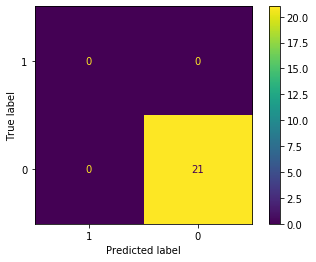

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White*, All Genders",6000,0.4023,0.8947,0.8423,0.6005


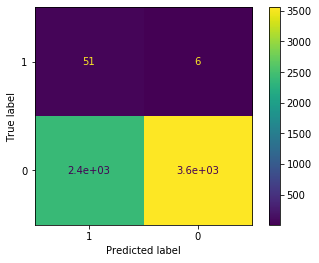

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White*, and Gender = Female",1345,0.6404,0.9231,0.8544,0.3651


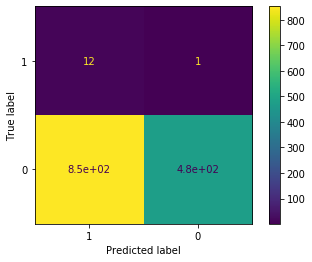

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White*, and Gender = Male",4653,0.3337,0.8864,0.855,0.6684


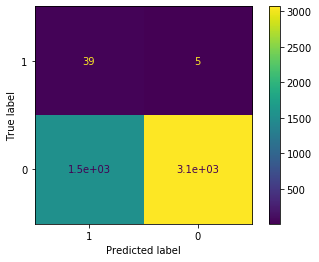

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = White*, and Gender = Unknown",2,0.0,NaN,NaN,1.0


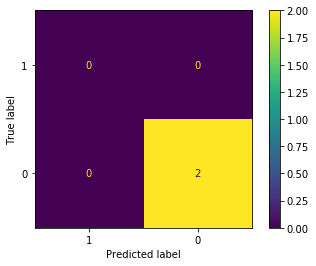

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Asian*, All Genders",224,0.3122,1.0,0.8612,0.692


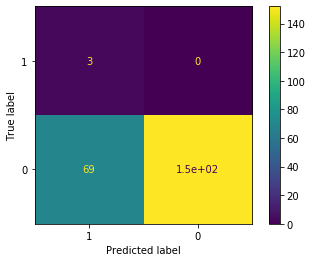

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Asian*, and Gender = Female",39,0.6842,1.0,0.9474,0.3333


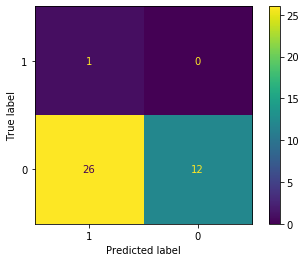

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Asian*, and Gender = Male",185,0.235,1.0,0.8634,0.7676


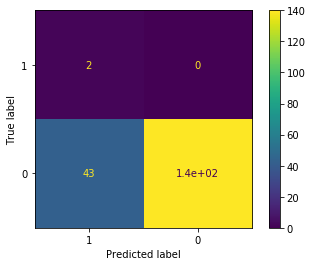



race (grouped)_Asian* and gender_unknown 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = American Indian*, All Genders",7,0.7143,NaN,NaN,0.2857


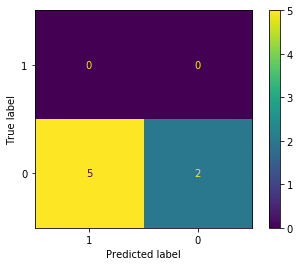

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = American Indian*, and Gender = Female",3,1.0,NaN,NaN,0.0


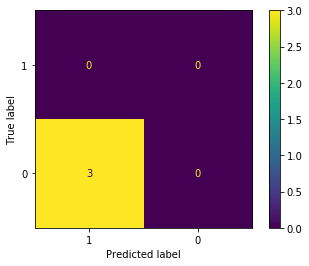

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = American Indian*, and Gender = Male",4,0.5,NaN,NaN,0.5


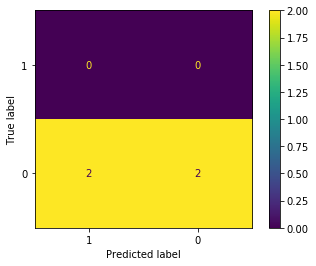



race (grouped)_American Indian* and gender_unknown 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Two or More*, All Genders",5,0.2,NaN,NaN,0.8


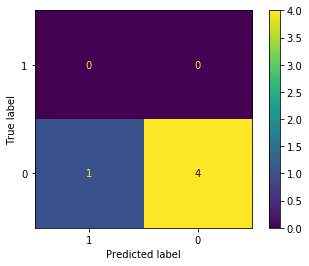



race (grouped)_Two or More* and gender_female 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Two or More*, and Gender = Male",5,0.2,NaN,NaN,0.8


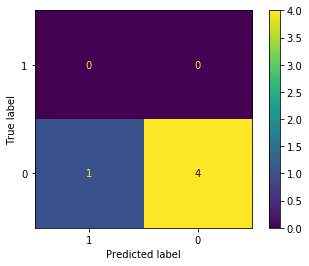



race (grouped)_Two or More* and gender_unknown 
	 No members of this subgroup present in the test set. 



,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Unknown, All Genders",420,0.181,NaN,NaN,0.819


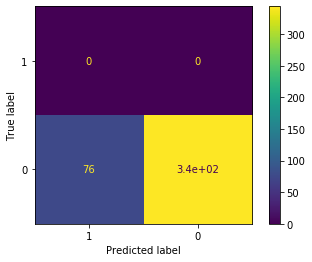

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Unknown, and Gender = Female",34,0.5294,NaN,NaN,0.4706


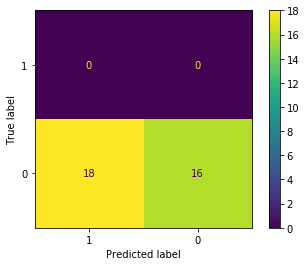

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Unknown, and Gender = Male",178,0.1236,NaN,NaN,0.8764


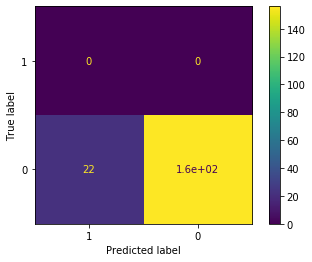

,Test Set Group Size (N),FPR,Recall,AUC,Accuracy
"Race = Unknown, and Gender = Unknown",208,0.1731,NaN,NaN,0.8269


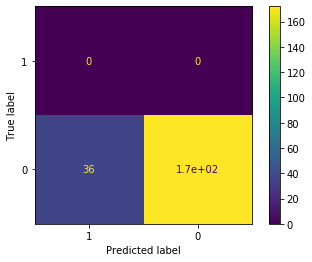

Test Set Group Size (N)     FPR  Recall     AUC  \
Race               Gender                                                     
All                All                        43363  0.2350  0.7923  0.8411   
                   Female                      5582  0.6101  0.9296  0.8228   
                   Male                       37546  0.1802  0.7407  0.8395   
                   Unknown                      235  0.1532     NaN     NaN   
Hispanic Or Latino All                         7438  0.1954  0.6875  0.8128   
                   Female                       737  0.5598  0.8000  0.8079   
                   Male                        6697  0.1558  0.6364  0.7837   
                   Unknown                        4  0.0000     NaN     NaN   
Black*             All                        29269  0.2111  0.7738  0.8407   
                   Female                      3424  0.6085  0.9574  0.8187   
                   Male                       25824  0.1590  0.7025  0.8359   
                   Unknown                       21  0.0000     NaN     NaN   
White*             All                         6000  0.4023  0.8947  0.8423   
                   Female                      1345  0.6404  0.9231  0.8544   
                   Male                        4653  0.3337  0.8864  0.8550   
                   Unknown                        2  0.0000     NaN     NaN   
Asian*             All                          224  0.3122  1.0000  0.8612   
                   Female                        39  0.6842  1.0000  0.9474   
                   Male                         185  0.2350  1.0000  0.8634   
American Indian*   All                            7  0.7143     NaN     NaN   
                   Female                         3  1.0000     NaN     NaN   
                   Male                           4  0.5000     NaN     NaN   
Two Or More*       All                            5  0.2000     NaN     NaN   
                   Male                           5  0.2000     NaN     NaN   
Unknown            All                          420  0.1810     NaN     NaN   
                   Female                        34  0.5294     NaN     NaN   
                   Male                         178  0.1236     NaN     NaN   
                   Unknown                      208  0.1731     NaN     NaN   

                            Accuracy  
Race               Gender             
All                All        0.7651  
                   Female     0.3968  
                   Male       0.8194  
                   Unknown    0.8468  
Hispanic Or Latino All        0.8041  
                   Female     0.4450  
                   Male       0.8435  
                   Unknown    1.0000  
Black*             All        0.7889  
                   Female     0.3992  
                   Male       0.8403  
                   Unknown    1.0000  
White*             All        0.6005  
                   Female     0.3651  
                   Male       0.6684  
                   Unknown    1.0000  
Asian*             All        0.6920  
                   Female     0.3333  
                   Male       0.7676  
American Indian*   All        0.2857  
                   Female     0.0000  
                   Male       0.5000  
Two Or More*       All        0.8000  
                   Male       0.8000  
Unknown            All        0.8190  
                   Female     0.4706  
                   Male       0.8764  
                   Unknown    0.8269

In [975]:
race_and_gender_stats = subgroup_stats('race', 'gender')
grouped_race_and_gender_stats = subgroup_stats('race (grouped)', 'gender')

# Section 8: Pandas profiling for additional dataset profiling

In [5]:
from pandas_profiling import ProfileReport
# https://github.com/pandas-profiling/pandas-profiling

#sent
profile1 = ProfileReport(sent, title='Pandas Profiling Report')
profile1.to_file(output_file='Sentencing_output.html')

In [6]:
#disposition
profile2 = ProfileReport(dispo, title='Pandas Profiling Report')
profile2.to_file(output_file='Disposition_output.html')

In [7]:
#initiation
profile3 = ProfileReport(init, title='Pandas Profiling Report')
profile3.to_file(output_file='Initiation_output.html')

In [8]:
# sentencing 
profile1

In [9]:
# dispo
profile2

In [10]:
#initiation
profile3

# Section 9: Classic Feature Importance

In [18]:
df = pd.read_pickle('total_df.pckl.gz', compression='gzip')

In [19]:
'''
Data Prep (consistent with ADS as seen in Final_Gradient_Boosting_Model.ipynb)

Performing prep on total_df (here called df, not decoded_df as above in LIME)
'''

#put earliest 85% of cases into training df, latest 15% of cases into test df
training, test = get_train_test(df, train_size=0.85, test_size=0.15)

# passing 50 to downsample function means training set will have 50% positive cases
training = downsample(training, 50)

X_train = training.drop('MHI', axis=1)
y_train = training['MHI']

X_test = test.drop('MHI', axis=1)
y_test = test['MHI']

In [20]:
clf_total = GradientBoostingClassifier(random_state=42, max_depth=3, 
                                       min_samples_leaf=10, learning_rate=0.01, 
                                       n_estimators=1000)
clf_total.fit(X_train, y_train)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.01, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=10, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=1000,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=42, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

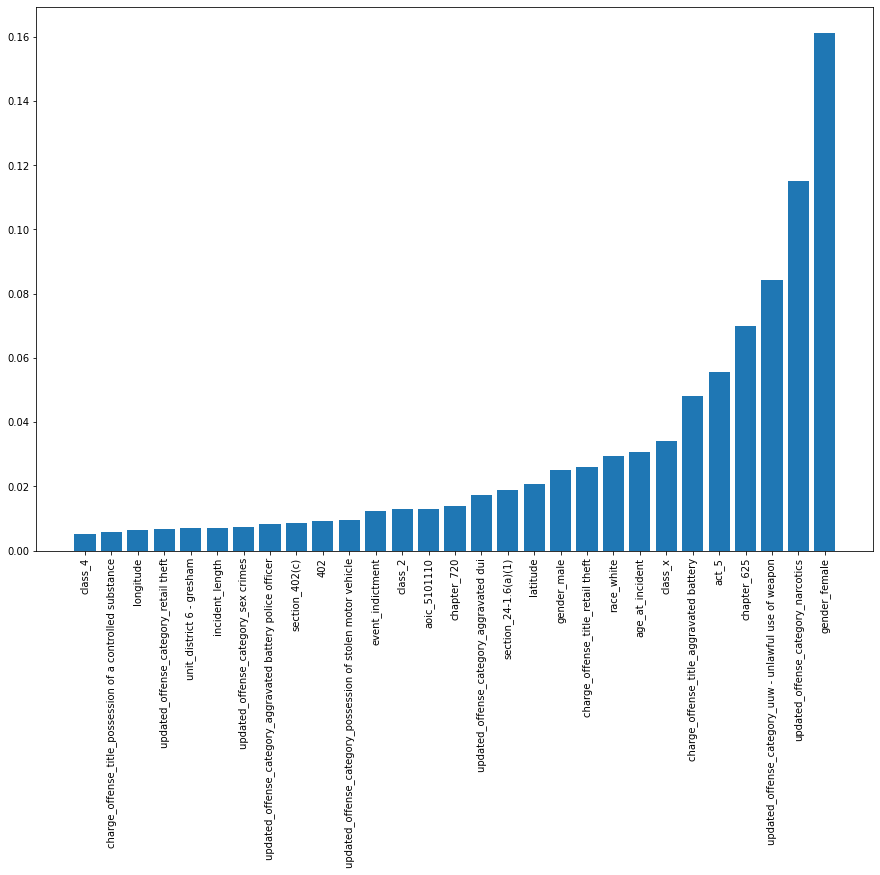

In [24]:
ftimp = [x for x in zip(X_train.columns, clf_total.feature_importances_)] #list of tuples
ftimp.sort(key = lambda x: x[1]) #sorting based on feature importance
ftimp = [x for x in ftimp if x[1] > 0.005] #in order to zoom in
plt.figure(figsize=(15,10))
plt.bar(*zip(*ftimp)) #unzipping ftimp
plt.xticks(rotation='vertical')
plt.show()

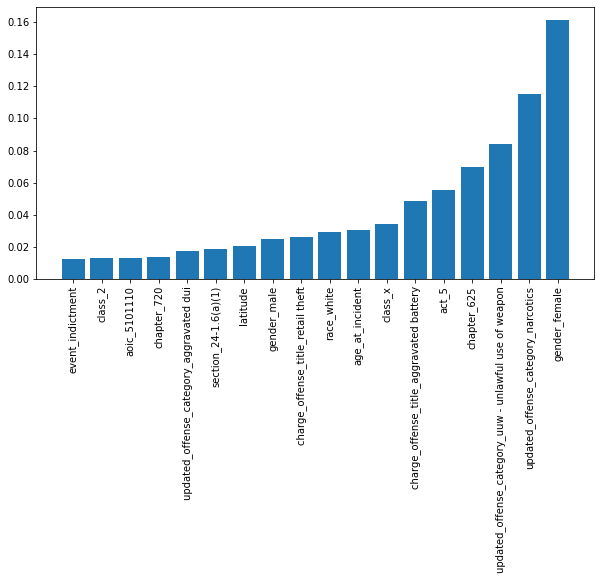

In [28]:
ftimp = [x for x in zip(X_train.columns, clf_total.feature_importances_)] #list of tuples
ftimp.sort(key = lambda x: x[1]) #sorting based on feature importance
ftimp = [x for x in ftimp if x[1] > 0.01] #theres a ton above 0
plt.figure(figsize=(10,5))
plt.bar(*zip(*ftimp)) #unzipping ftimp
plt.xticks(rotation='vertical')
plt.show()